# TFT SIMPLE CQR MODELS
This notebook contains the code for the Conformal Quantile Regression (CQR) calibration and evaluation of the two TFT models previously trained without covariates using the Darts library.

Both versions of the model are evaluated on their respective test sets, with the MinMax-scaled model also evaluated on a dedicated test set.

In [1]:
# We install darts
!pip install u8darts[torch] --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.6/200.6 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.1/823.1 kB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 14.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 79.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 68.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Necessary imports to read the datasets
import pandas as pd
import zipfile
import os
import numpy as np
import matplotlib.pyplot as plt
import joblib
from darts import TimeSeries
from darts.dataprocessing.transformers import Scaler
from darts.models import TFTModel
from darts import concatenate, metrics
from darts.models import ConformalQRModel

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# We start with minmax scaling

In [ ]:
# Load model
model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/simple/TFT_model.pkl")

In [ ]:
# Load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test.pkl')

# Extract components
scaled_val_series = test_data['validation']        # validation not used in our case
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

Loaded 60 time series for testing.


In [ ]:
# Constants
start_date = pd.Timestamp("2023-11-6")
horizon = 7
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}

# Initialize the conformal quantile regression model
cp_model = ConformalQRModel(
    model=model,
    quantiles=quantiles,
    symmetric=False
    # if cal_length is None, it considers all calibration scores
)
q_interval = cp_model.q_interval  # [(0.05, 0.95)]
q_range = cp_model.interval_range  # [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = cp_model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=start_date,
        last_points_only=False,
        stride=7,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    # We evaluate the already-generated historical forecasts
    bt = cp_model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        retrain=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": bt[1], "Width rescaled": mean_width})
    print(f"Results for meter {meter_id}:\n", df_results, "\n")

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 383.29it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801501002_Badalona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.239795       23.555057 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 409.63it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801503008_Badalona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.306706       29.143239 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 411.41it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.715235       11.129055 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 429.02it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.803571  0.137566        1.676933 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 298.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.220471        3.701715 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 423.40it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.767857  0.261572           2.961 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 413.82it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.244368        3.274532 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 421.83it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  0.323814        3.335289 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 335.52it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.306553        0.858347 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 405.92it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.406033         1.10441 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 386.98it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.803571  0.178653        4.148321 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 418.35it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.393188        4.934504 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 266.31it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.857143  0.298808         1.03985 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 415.33it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903081_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.263226        2.276901 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 413.65it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.857143  0.150742        6.222631 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 316.74it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.311851        4.001047 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 396.66it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801905054_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.196459       20.009349 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 383.21it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  0.292722        6.179353 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 410.59it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906002_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.380898        3.123367 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 303.94it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.276811        7.568004 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 407.18it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906041_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.321749        8.873844 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 303.32it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.109737        2.190343 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 405.26it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907011_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.857143  0.27516        2.938708 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 296.42it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907013_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.982143  0.28716        2.555728 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 428.14it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9       1.0  0.453031       12.589726 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 400.27it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.304328        5.362267 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 396.50it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.821429  0.522295       13.433417 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 230.29it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.119162        7.724112 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 295.64it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907115_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.269145        19.99477 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 387.29it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.196626        3.967921 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 293.47it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.262491        3.921618 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 387.22it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.205807        0.841749 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 400.00it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.355343        2.775232 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 396.95it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908049_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.283022       15.387927 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 279.64it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908061_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.982143  0.26185        1.214983 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 393.41it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.231871        5.277394 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 413.88it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.803571  0.364307        9.337183 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 418.25it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  0.198592        5.389774 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 395.97it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.250967        9.458935 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 392.78it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.487088          8.3633 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 396.10it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910054_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.946429  0.54651        5.793006 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 287.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.345085        1.604645 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 394.24it/s]


Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.498673        1.884983 



INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 402.06it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9       1.0  0.301753         1.31866 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 398.01it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.857143  0.287486         0.79346 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 301.11it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101040_Hospitalet:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.928571  0.38738        7.747606 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 344.57it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9       1.0  0.182064        3.916205 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 407.95it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9      0.75  0.545581        7.654501 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 366.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.189797        2.395235 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 362.63it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.385896        5.684245 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 305.88it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102033_Hospitalet:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.910714  0.71515       22.412812 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 372.48it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.785714  0.415044       10.284785 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 318.21it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.144548        3.500949 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 391.05it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.403442        1.811455 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 380.77it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.137412         0.83821 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 421.54it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.144939         4.11336 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 386.67it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.256467        5.667915 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 375.65it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106012_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.209964        1.853978 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 399.88it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.476143        3.104455 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 208.71it/s]

Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.350593        2.096545 



In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()
mean_width_rescaled = combined_results["Width rescaled"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")
print(f"Mean Width rescaled: {mean_width_rescaled:.4f}")

Mean Coverage: 0.9080
Mean Width: 0.3098
Mean Width rescaled: 6.2720


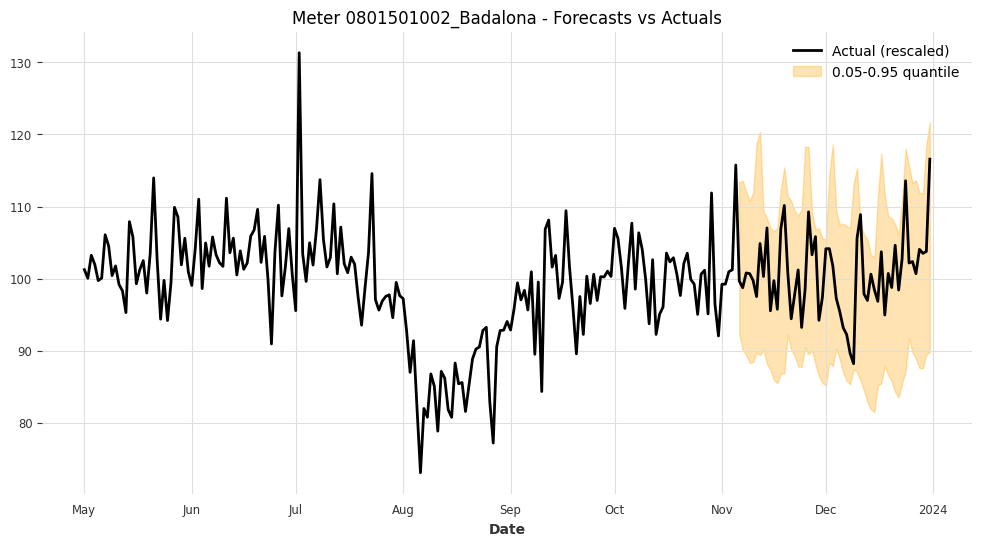

Meter 0801501002_Badalona - Coverage: 0.9821, Width: 23.5551



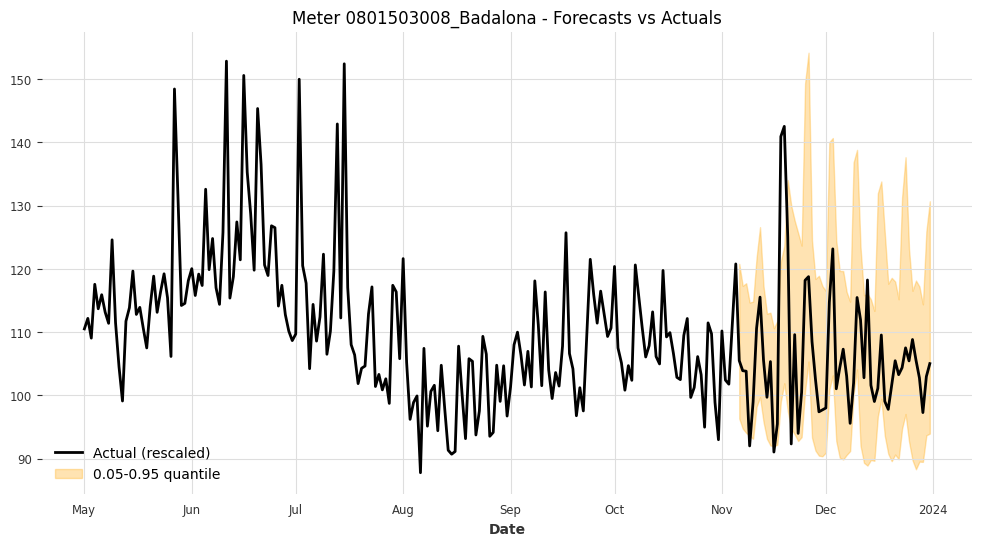

Meter 0801503008_Badalona - Coverage: 0.8929, Width: 29.1432



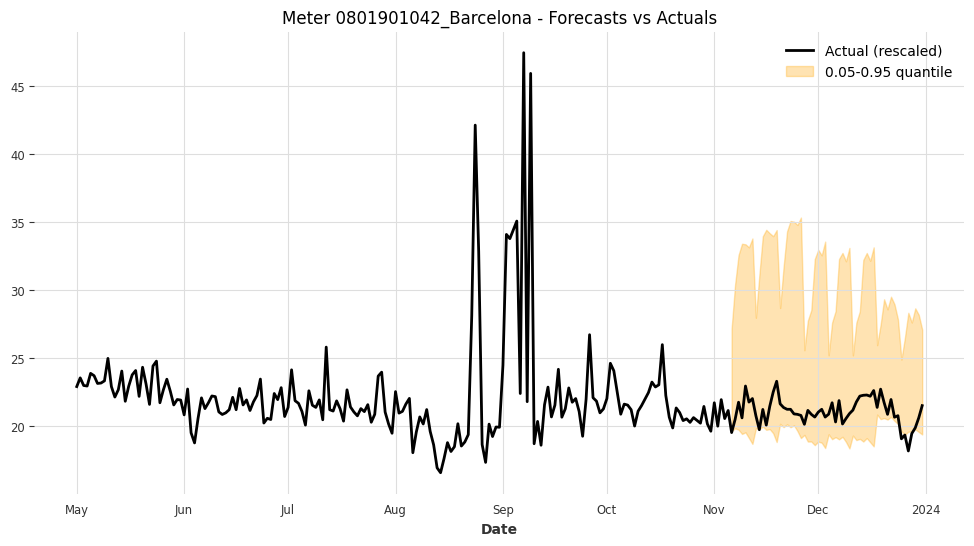

Meter 0801901042_Barcelona - Coverage: 0.8929, Width: 11.1291



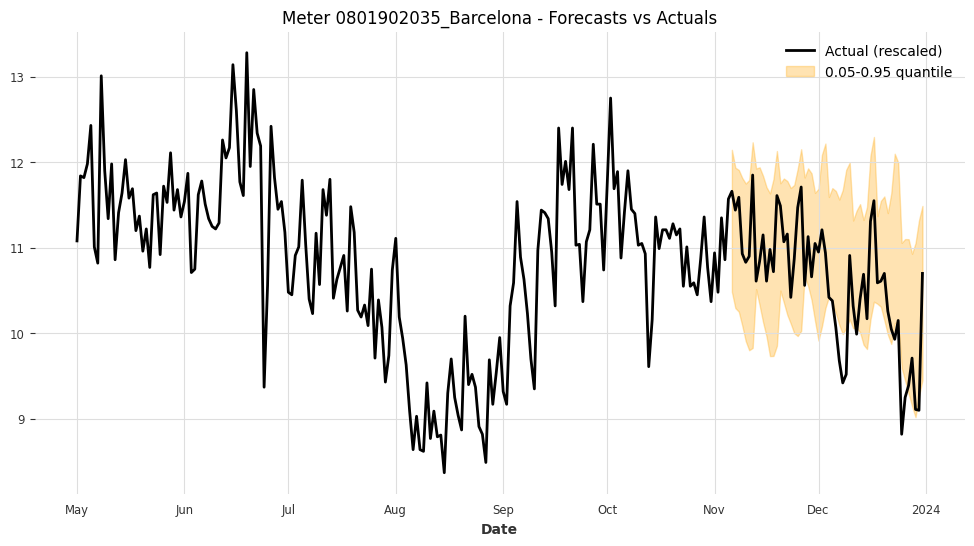

Meter 0801902035_Barcelona - Coverage: 0.8036, Width: 1.6769



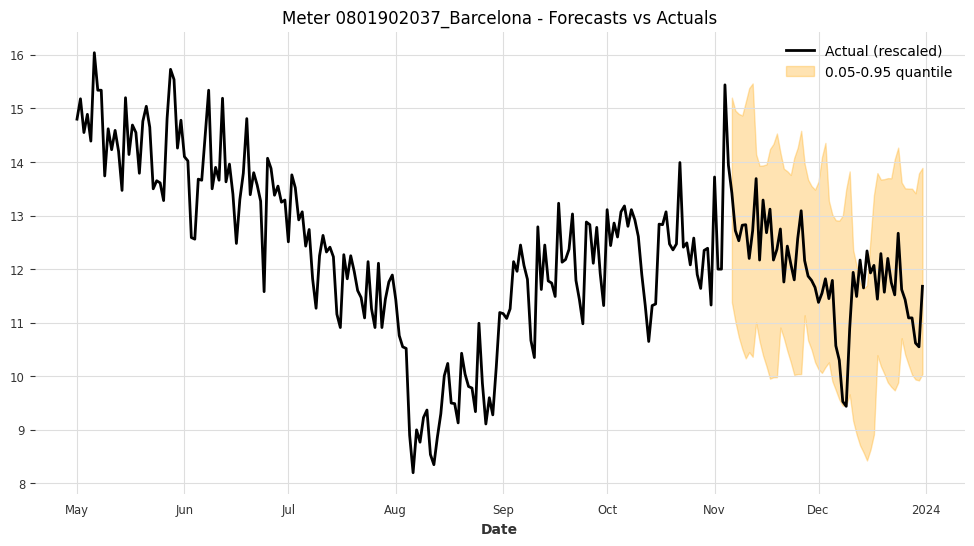

Meter 0801902037_Barcelona - Coverage: 0.9286, Width: 3.7017



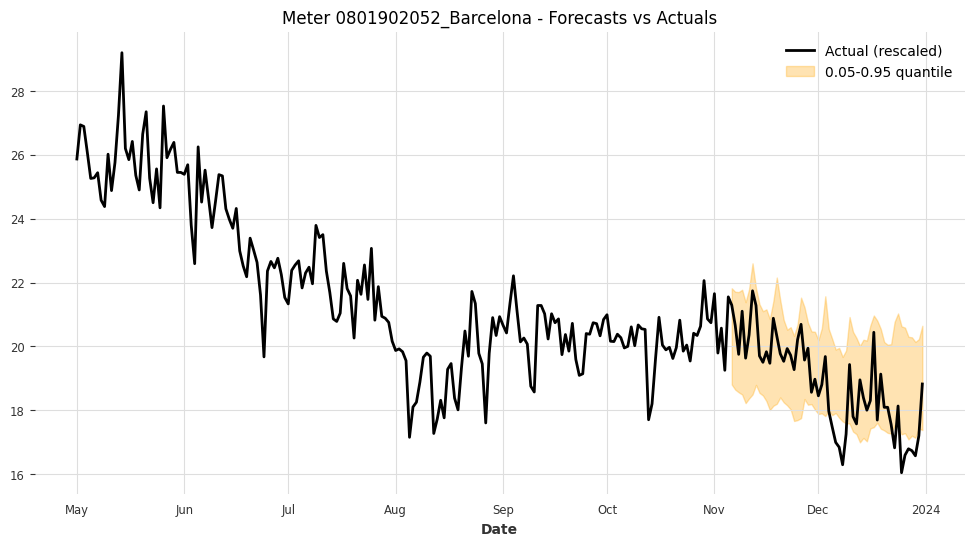

Meter 0801902052_Barcelona - Coverage: 0.7679, Width: 2.9610



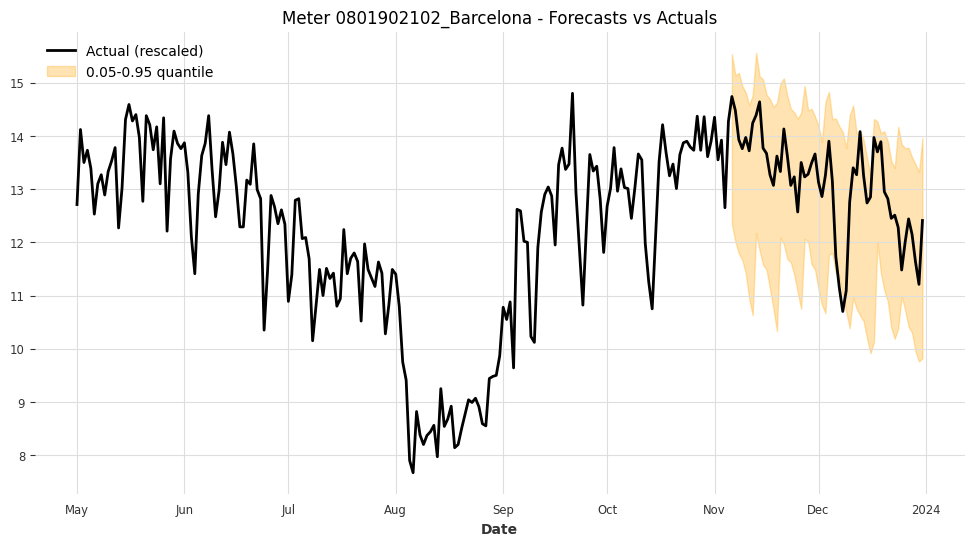

Meter 0801902102_Barcelona - Coverage: 0.9643, Width: 3.2745



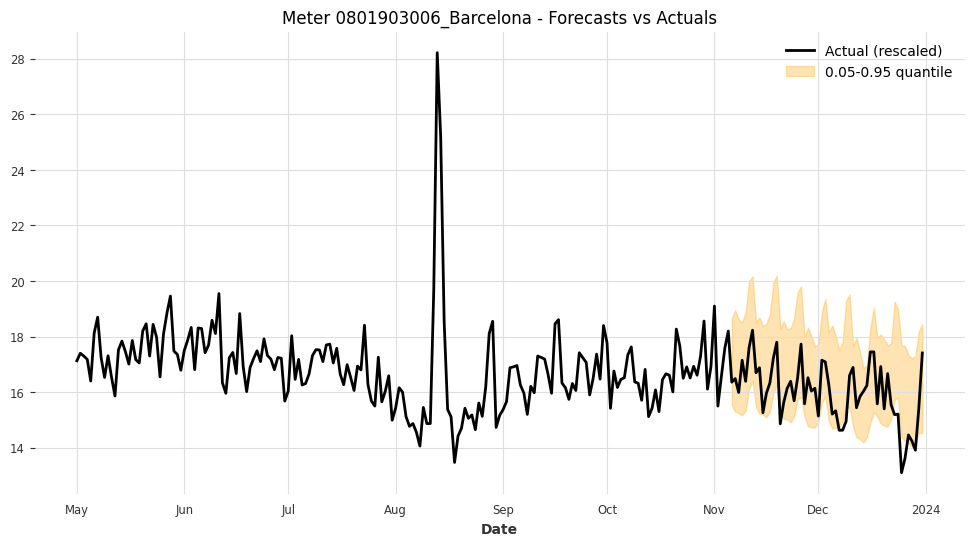

Meter 0801903006_Barcelona - Coverage: 0.8393, Width: 3.3353



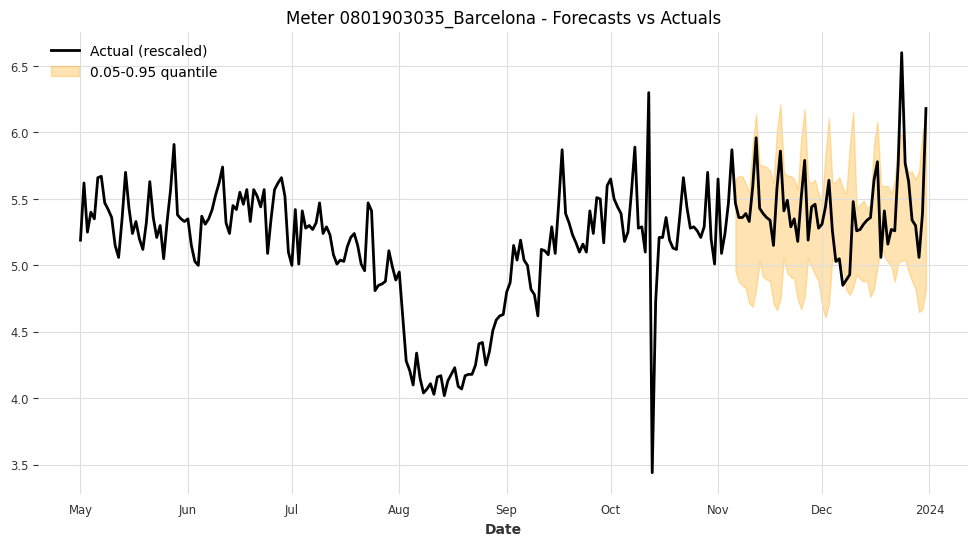

Meter 0801903035_Barcelona - Coverage: 0.9107, Width: 0.8583



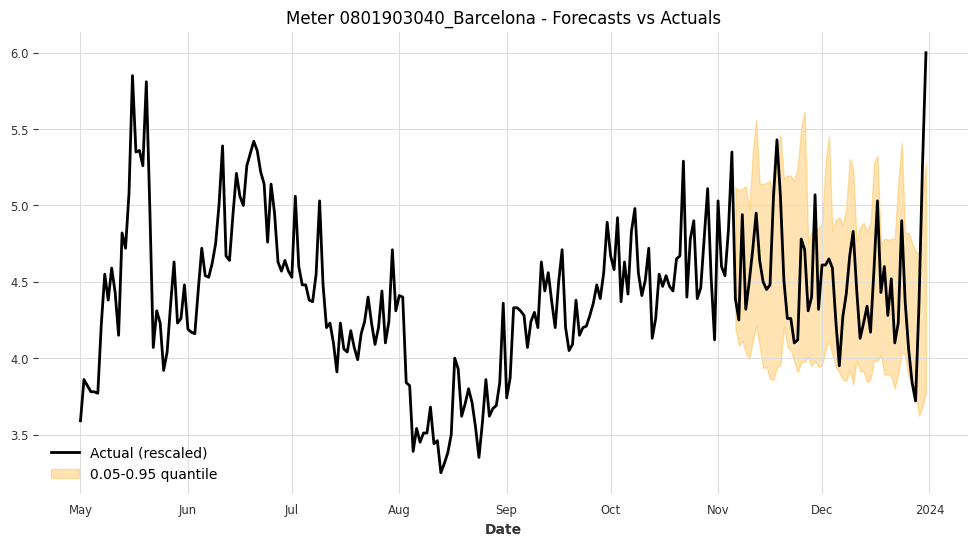

Meter 0801903040_Barcelona - Coverage: 0.8929, Width: 1.1044



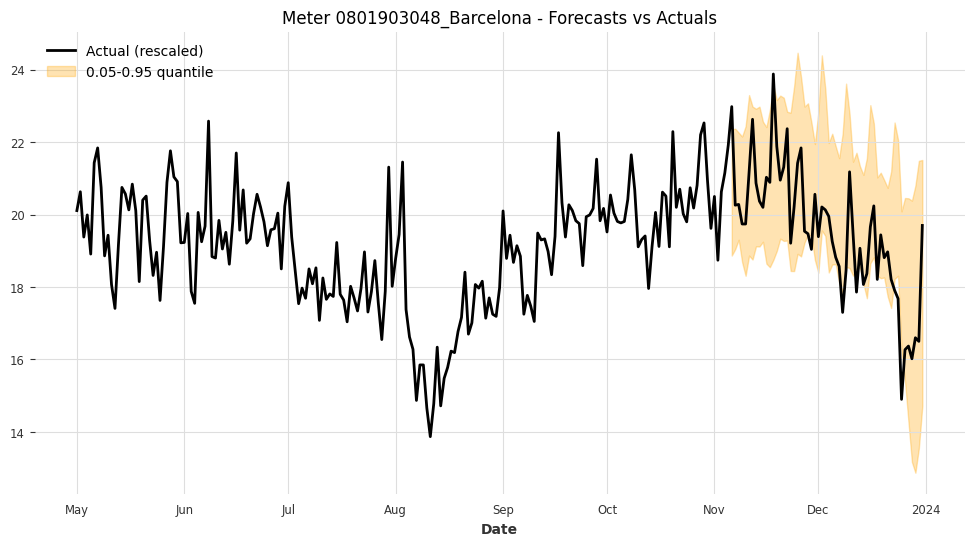

Meter 0801903048_Barcelona - Coverage: 0.8036, Width: 4.1483



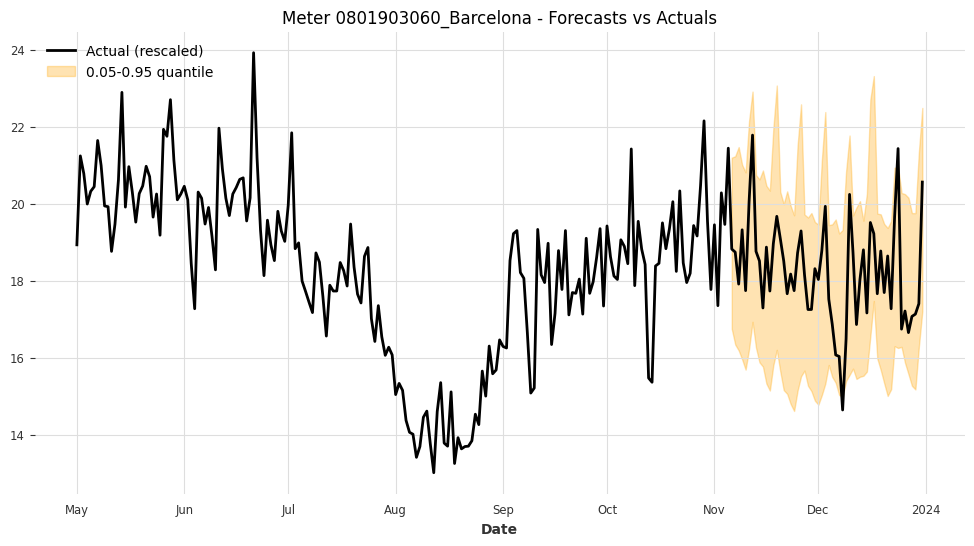

Meter 0801903060_Barcelona - Coverage: 0.9643, Width: 4.9345



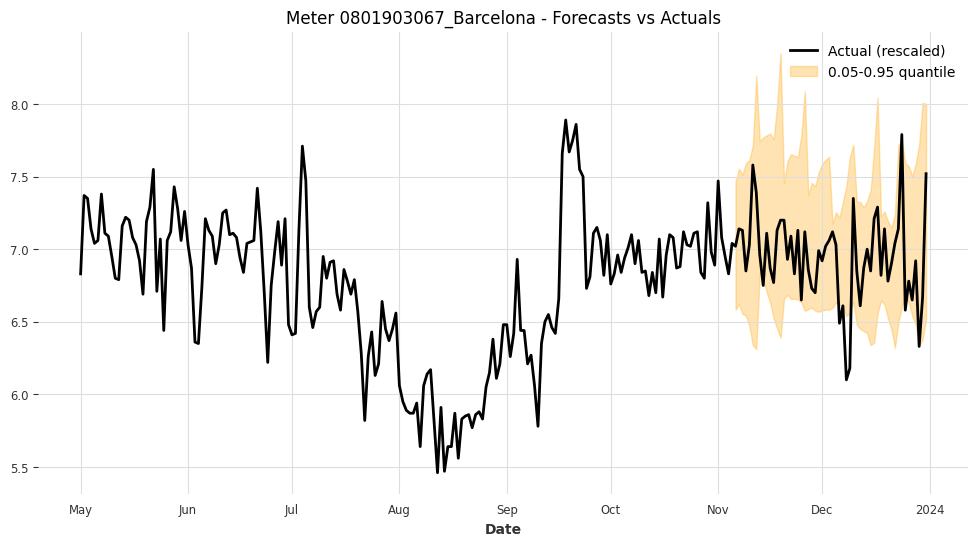

Meter 0801903067_Barcelona - Coverage: 0.8571, Width: 1.0399



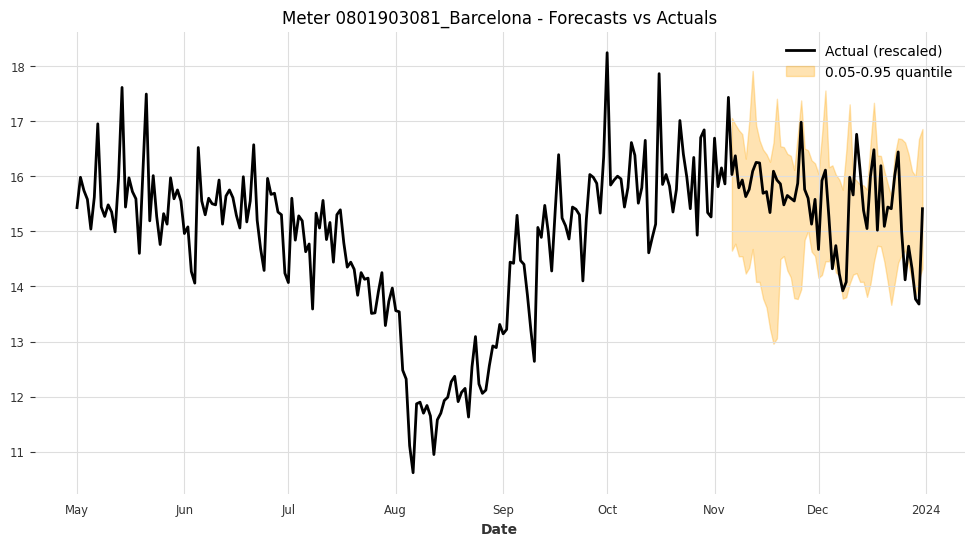

Meter 0801903081_Barcelona - Coverage: 0.8929, Width: 2.2769



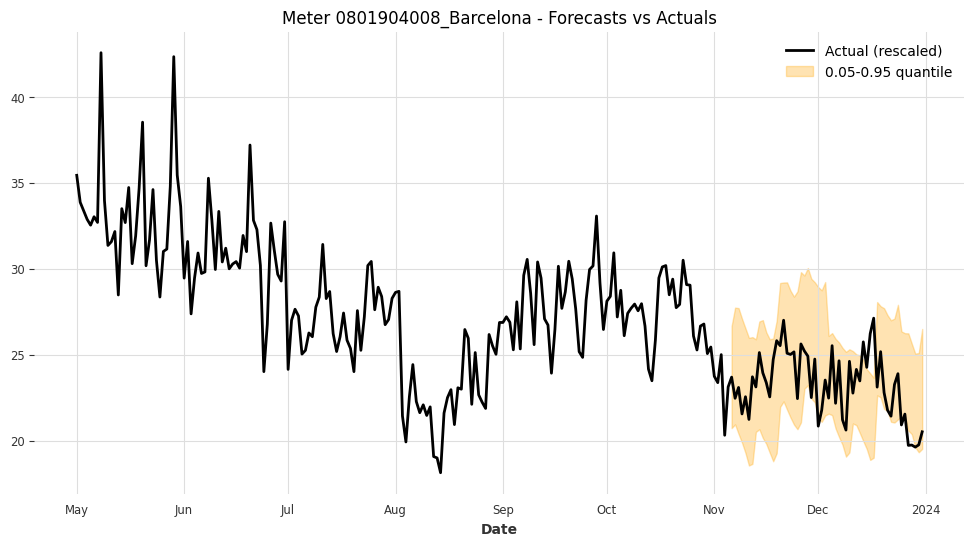

Meter 0801904008_Barcelona - Coverage: 0.8571, Width: 6.2226



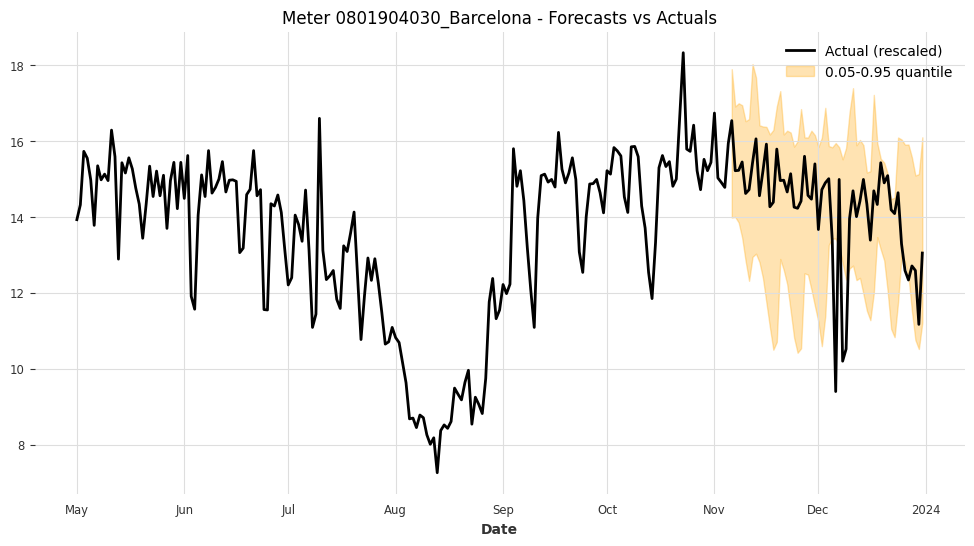

Meter 0801904030_Barcelona - Coverage: 0.8929, Width: 4.0010



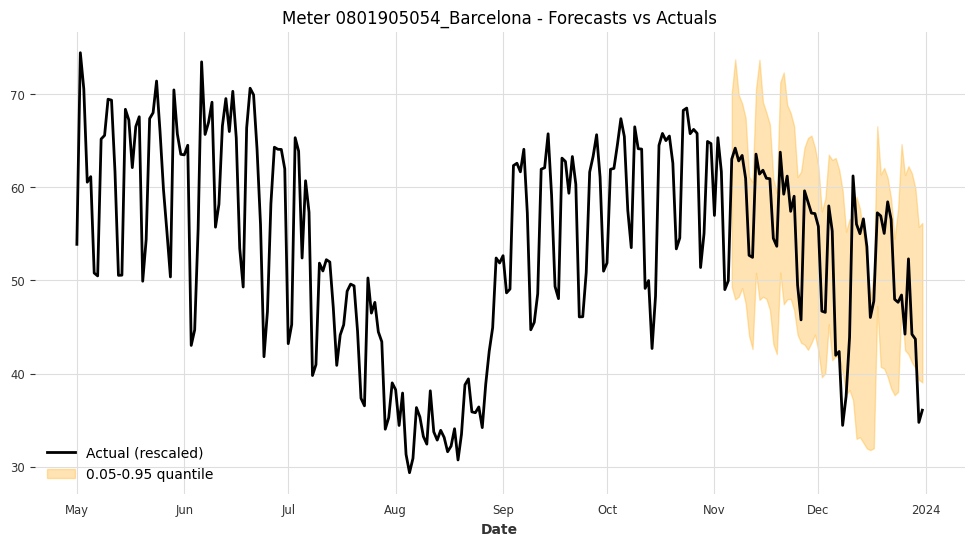

Meter 0801905054_Barcelona - Coverage: 0.8750, Width: 20.0093



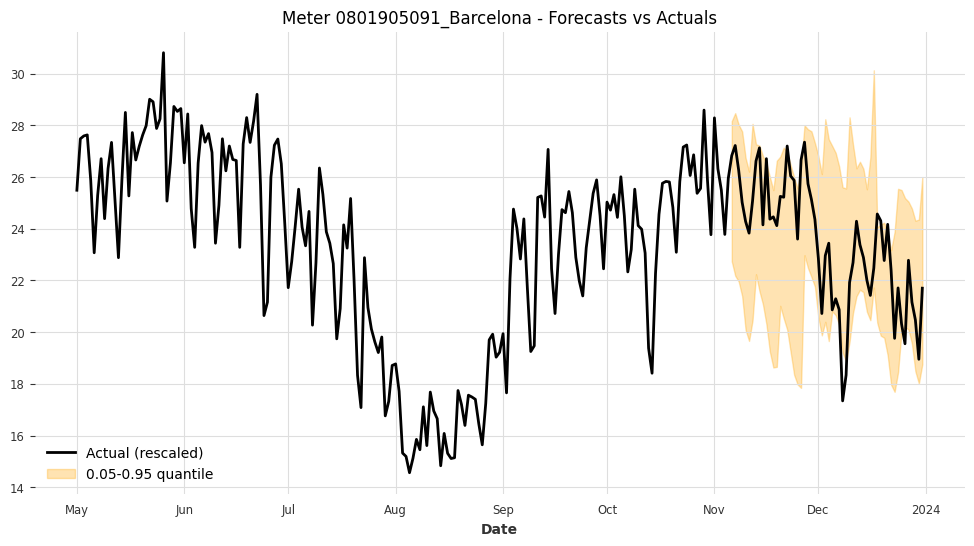

Meter 0801905091_Barcelona - Coverage: 0.8393, Width: 6.1794



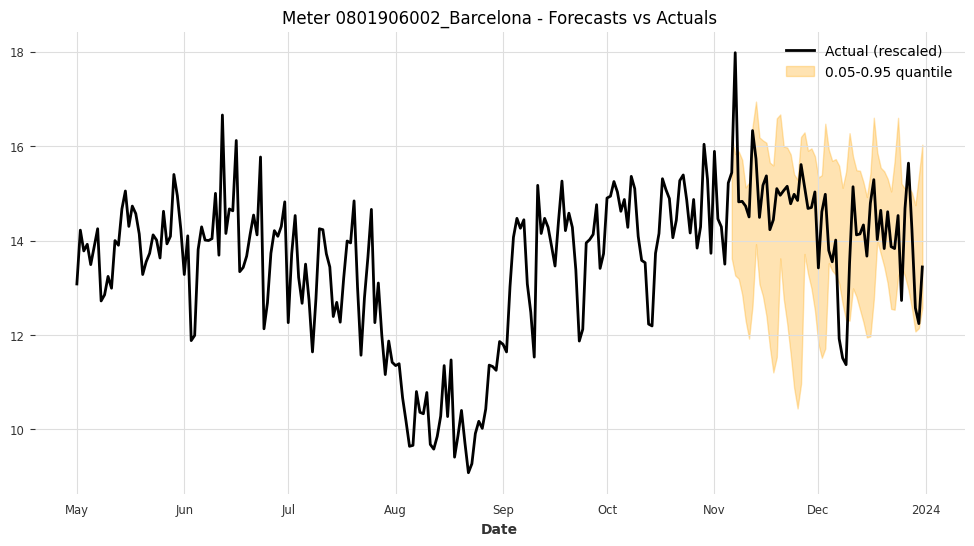

Meter 0801906002_Barcelona - Coverage: 0.8929, Width: 3.1234



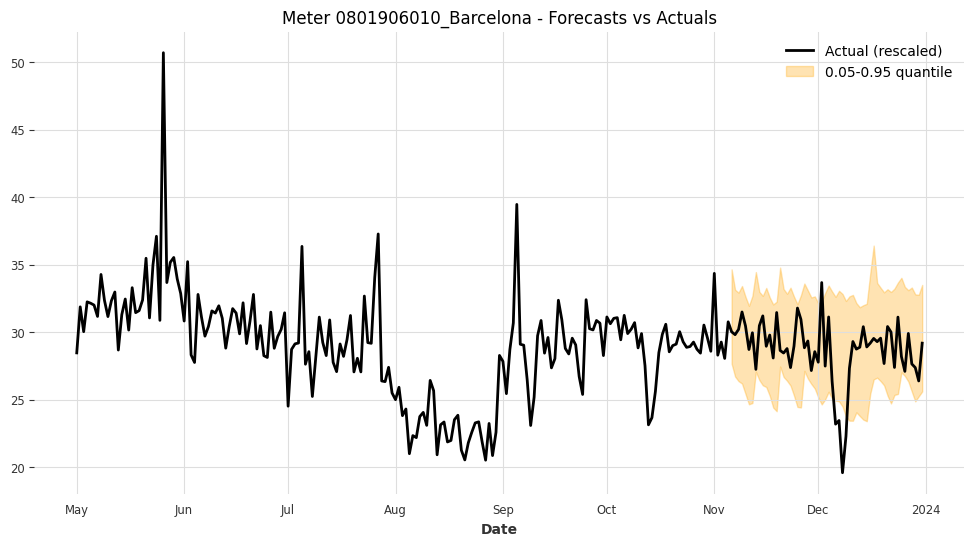

Meter 0801906010_Barcelona - Coverage: 0.9107, Width: 7.5680



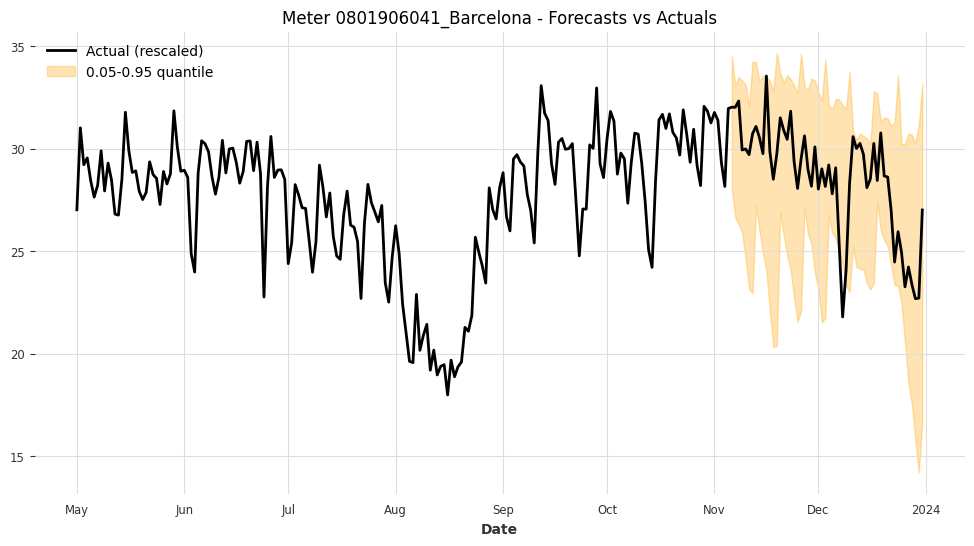

Meter 0801906041_Barcelona - Coverage: 0.9643, Width: 8.8738



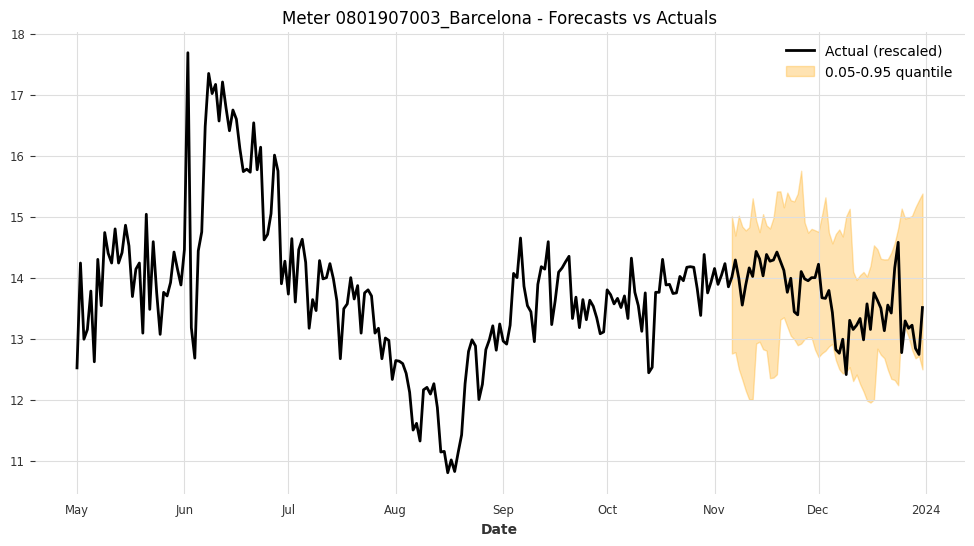

Meter 0801907003_Barcelona - Coverage: 0.9643, Width: 2.1903



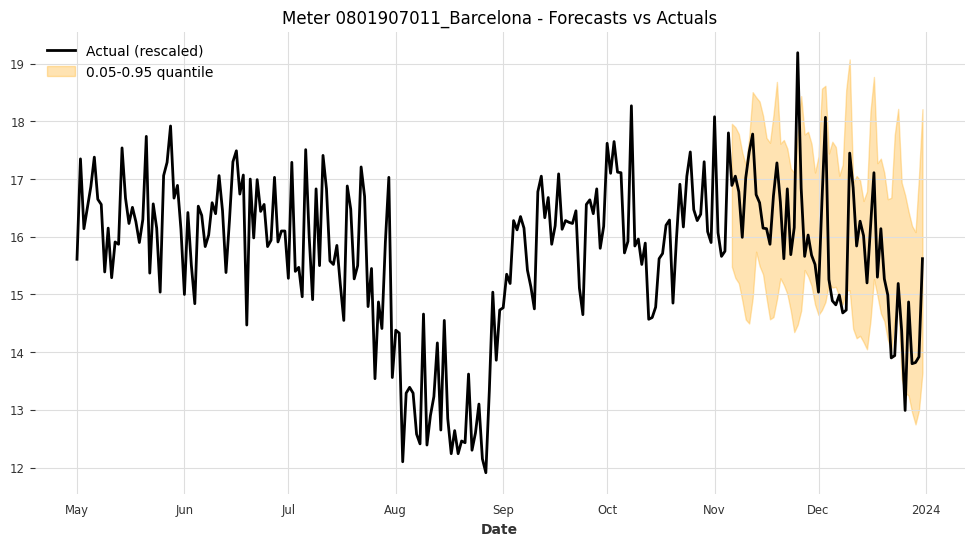

Meter 0801907011_Barcelona - Coverage: 0.8571, Width: 2.9387



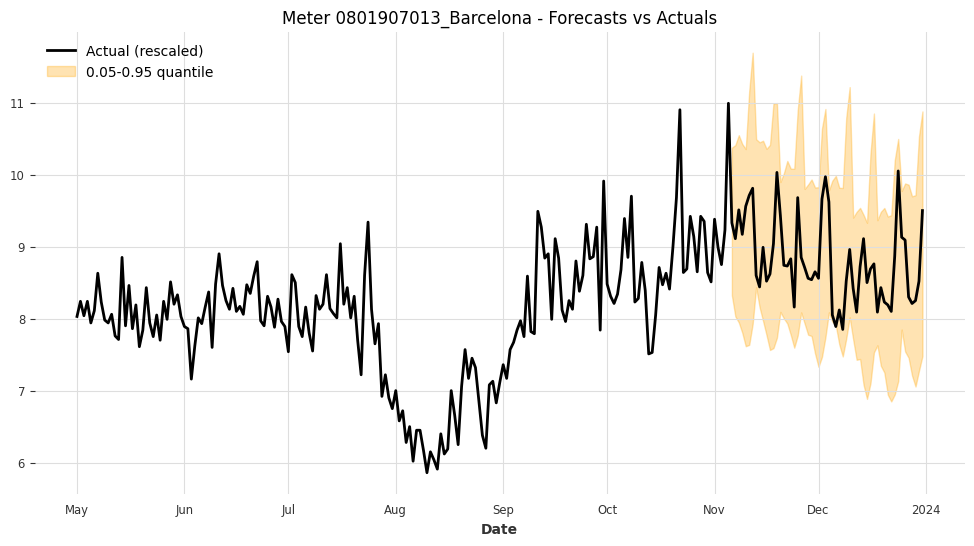

Meter 0801907013_Barcelona - Coverage: 0.9821, Width: 2.5557



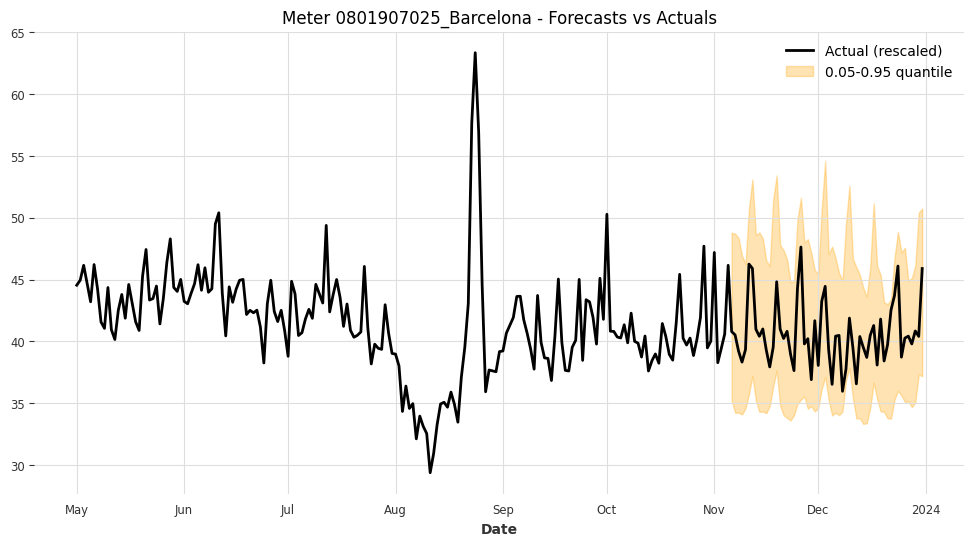

Meter 0801907025_Barcelona - Coverage: 1.0000, Width: 12.5897



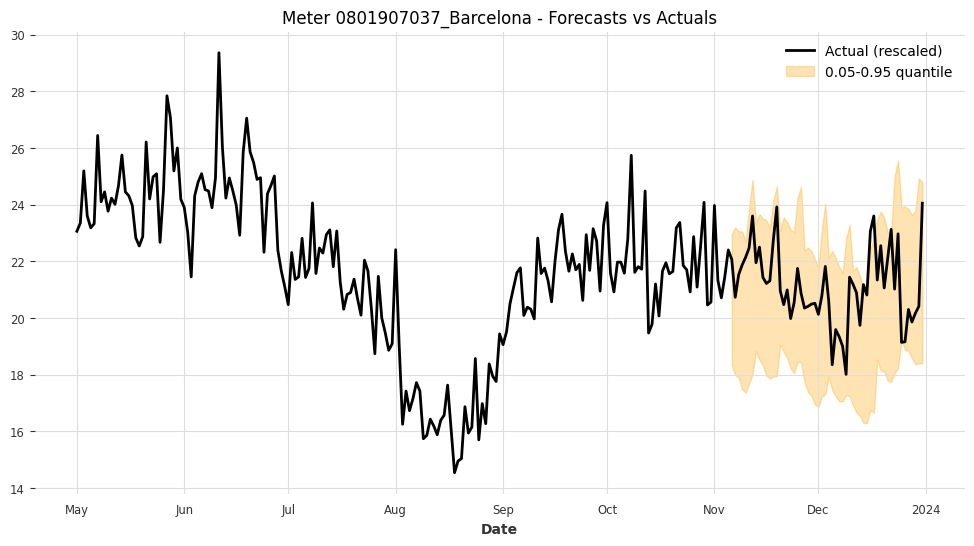

Meter 0801907037_Barcelona - Coverage: 0.9107, Width: 5.3623



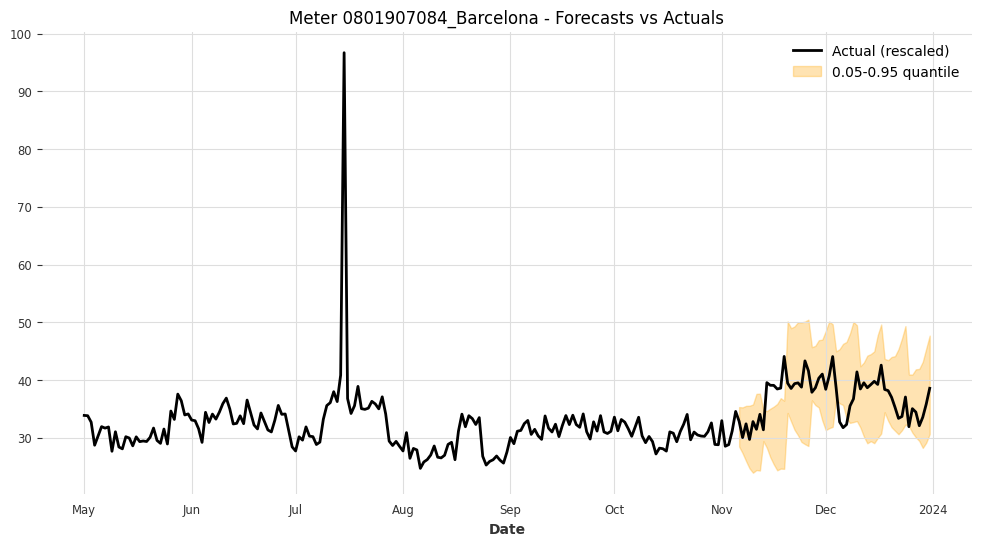

Meter 0801907084_Barcelona - Coverage: 0.8214, Width: 13.4334



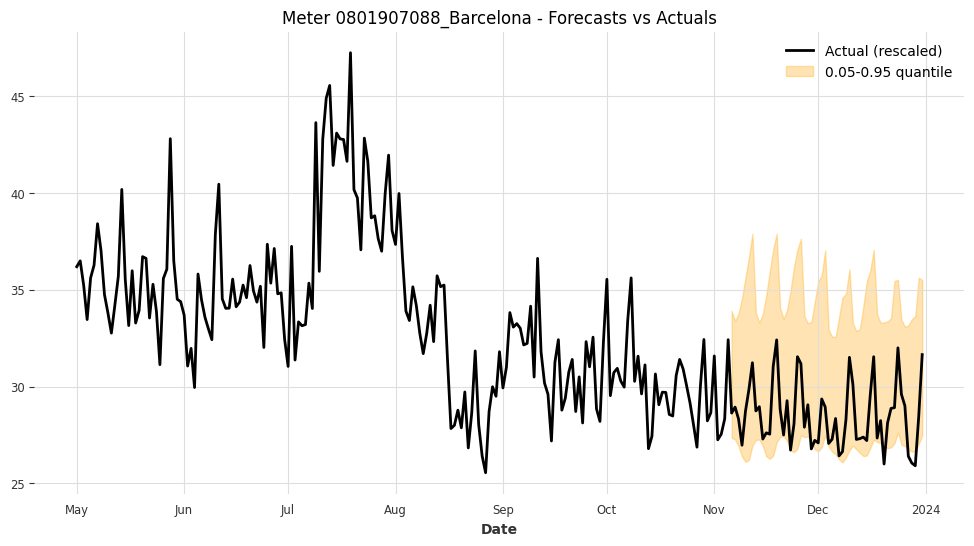

Meter 0801907088_Barcelona - Coverage: 0.9107, Width: 7.7241



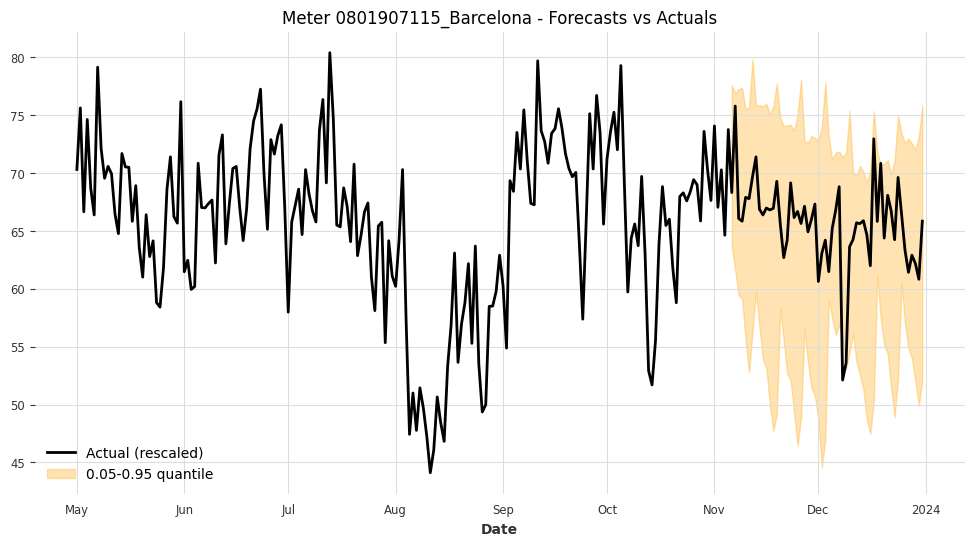

Meter 0801907115_Barcelona - Coverage: 0.9643, Width: 19.9948



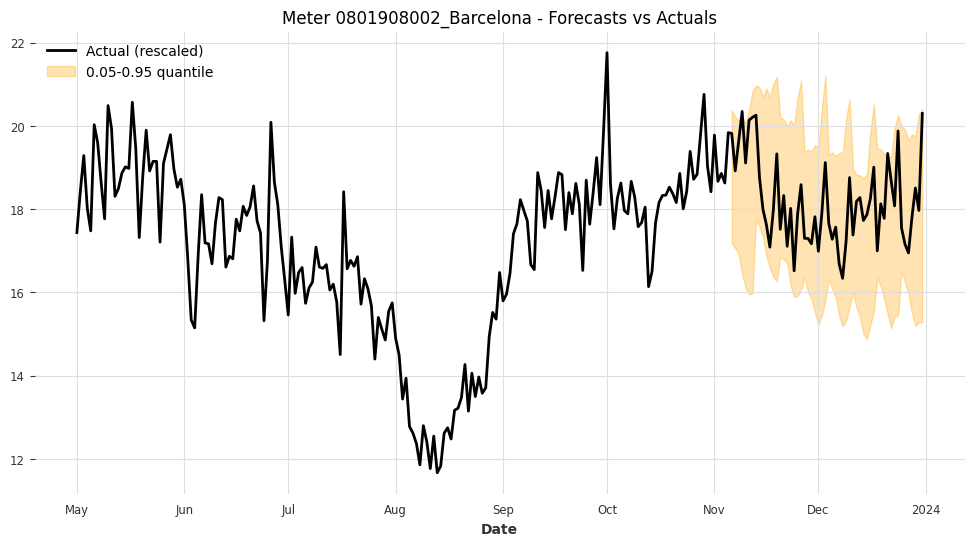

Meter 0801908002_Barcelona - Coverage: 0.9643, Width: 3.9679



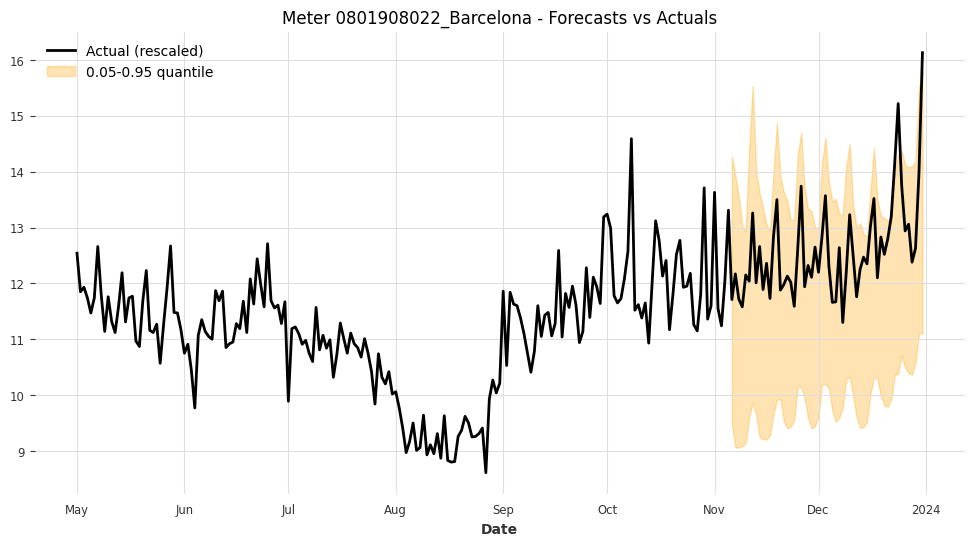

Meter 0801908022_Barcelona - Coverage: 0.9286, Width: 3.9216



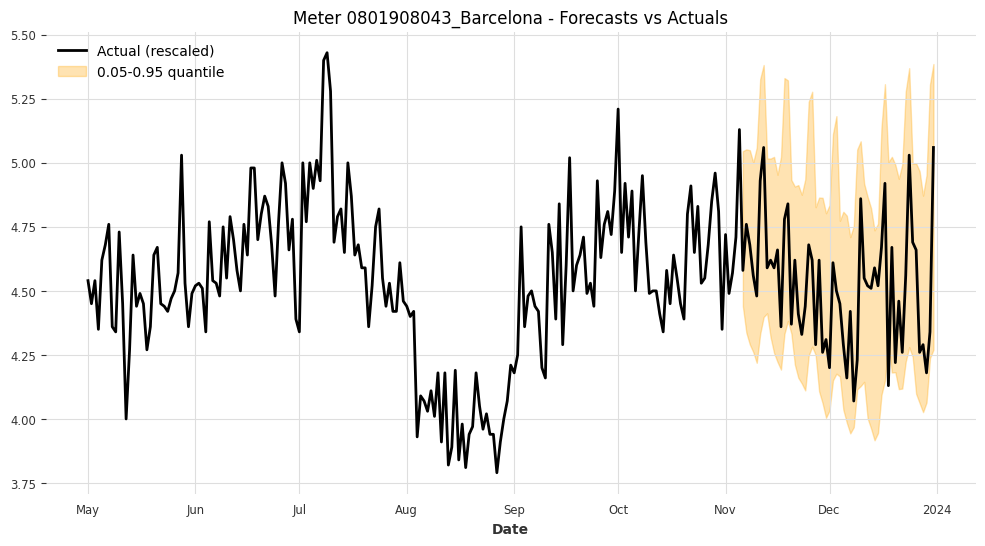

Meter 0801908043_Barcelona - Coverage: 0.9821, Width: 0.8417



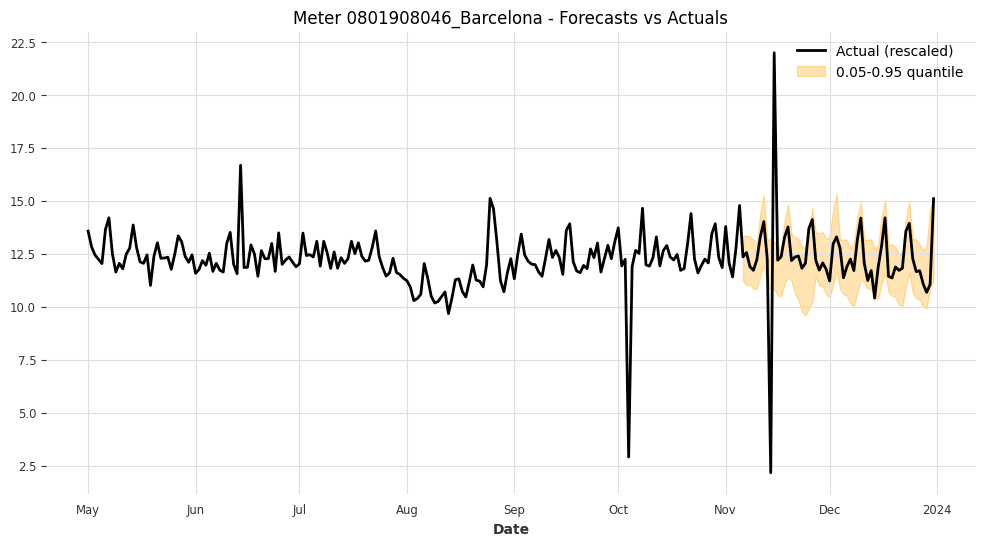

Meter 0801908046_Barcelona - Coverage: 0.9286, Width: 2.7752



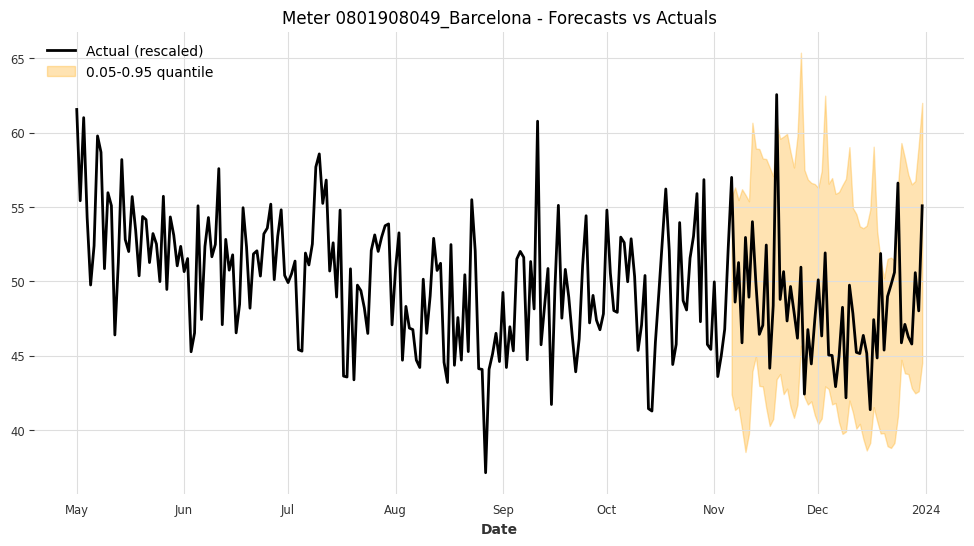

Meter 0801908049_Barcelona - Coverage: 0.9286, Width: 15.3879



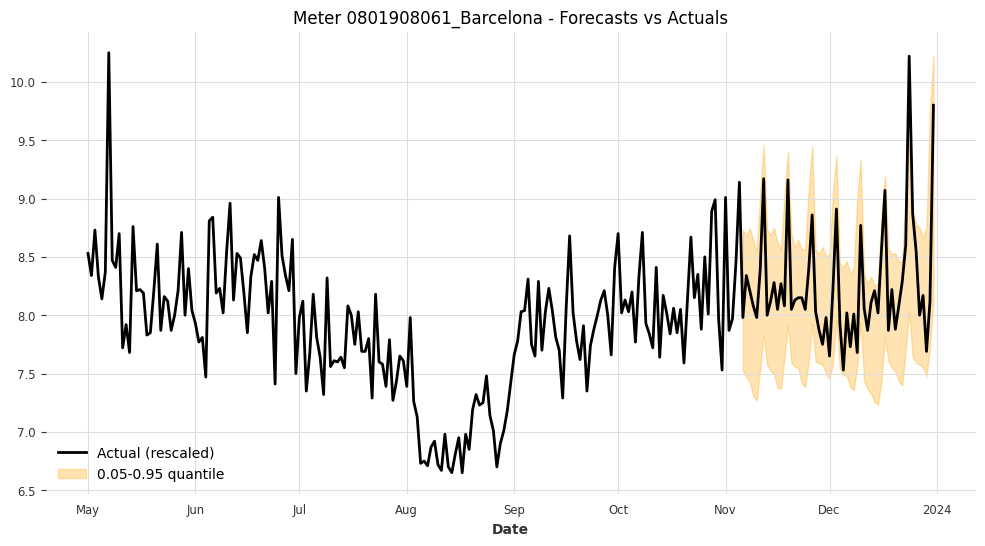

Meter 0801908061_Barcelona - Coverage: 0.9821, Width: 1.2150



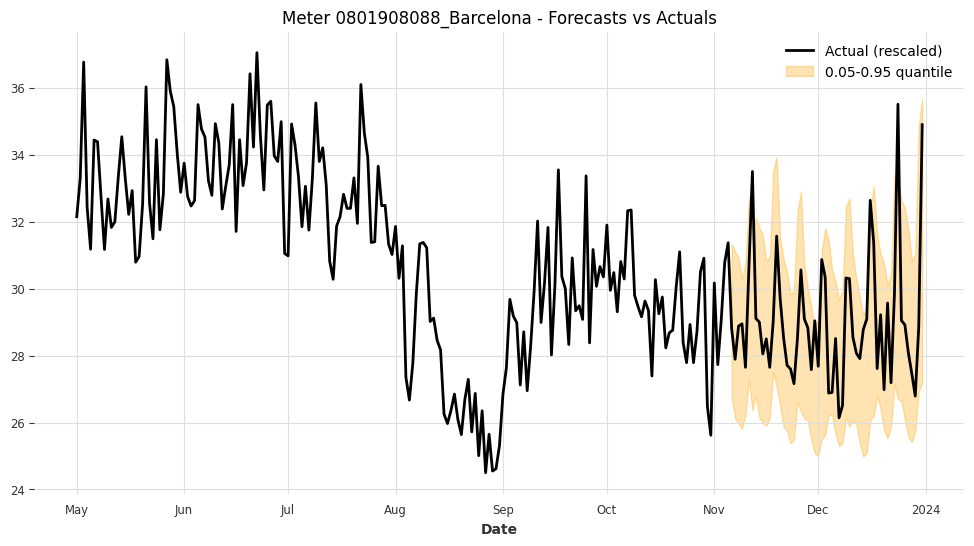

Meter 0801908088_Barcelona - Coverage: 0.9286, Width: 5.2774



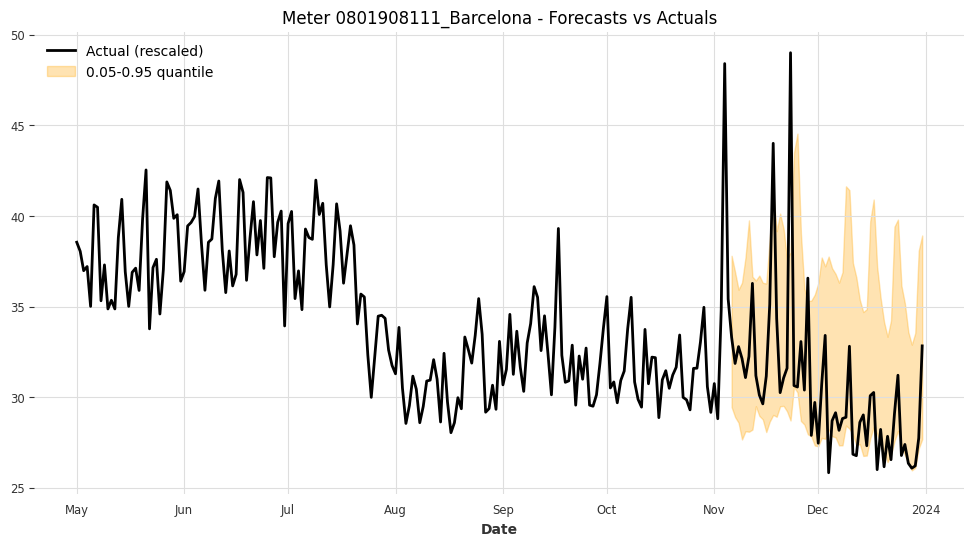

Meter 0801908111_Barcelona - Coverage: 0.8036, Width: 9.3372



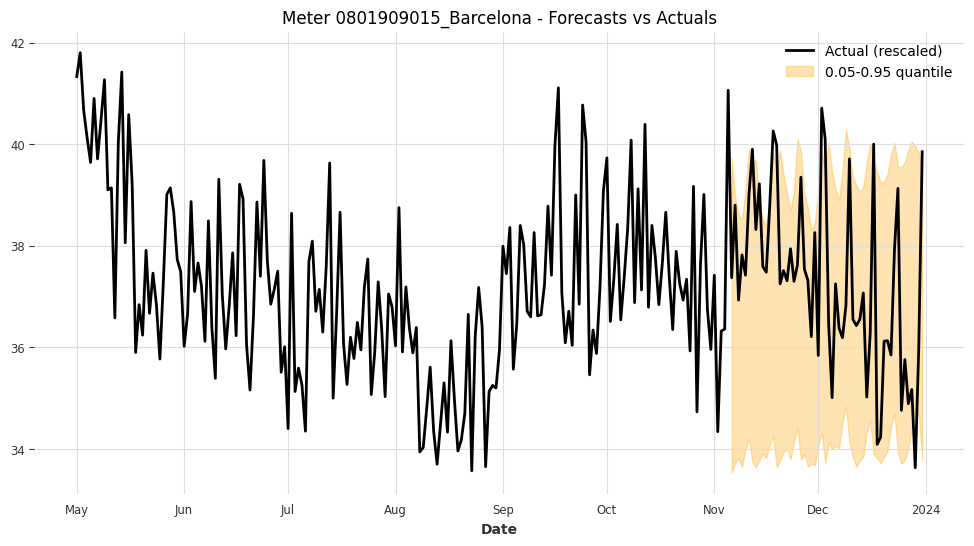

Meter 0801909015_Barcelona - Coverage: 0.8393, Width: 5.3898



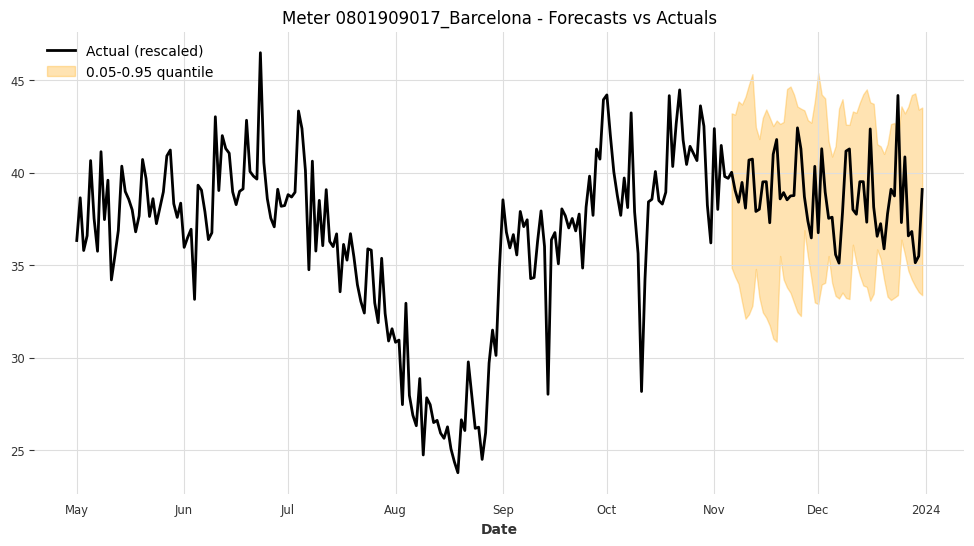

Meter 0801909017_Barcelona - Coverage: 0.9821, Width: 9.4589



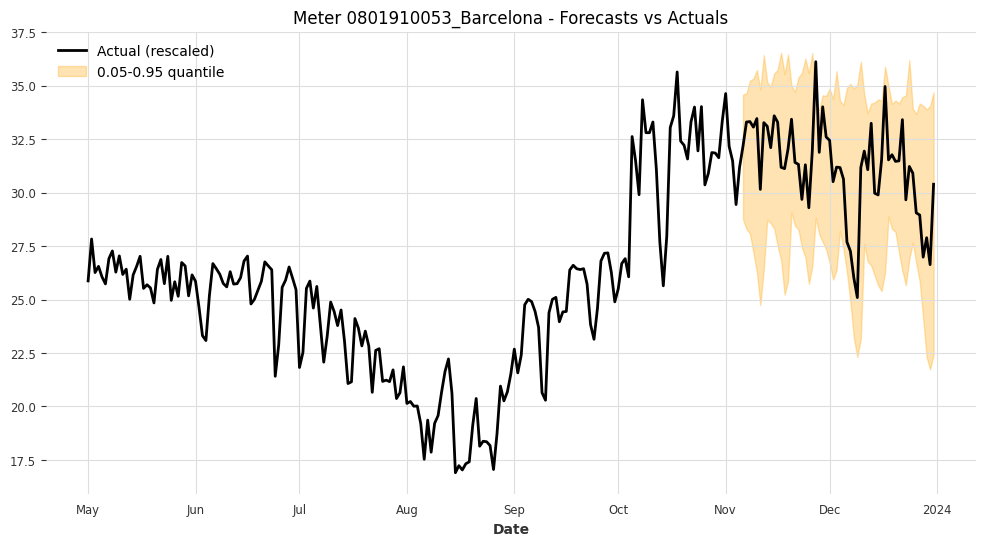

Meter 0801910053_Barcelona - Coverage: 0.9821, Width: 8.3633



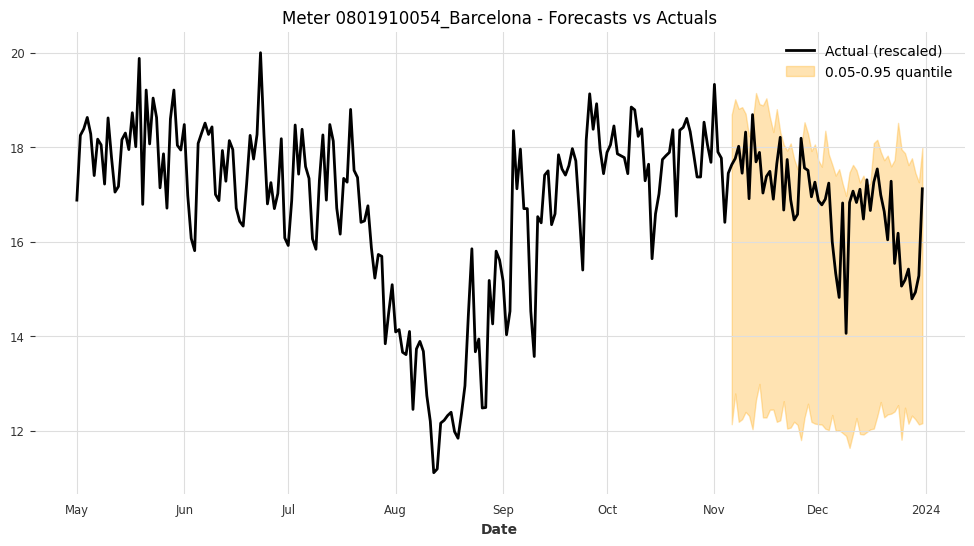

Meter 0801910054_Barcelona - Coverage: 0.9464, Width: 5.7930



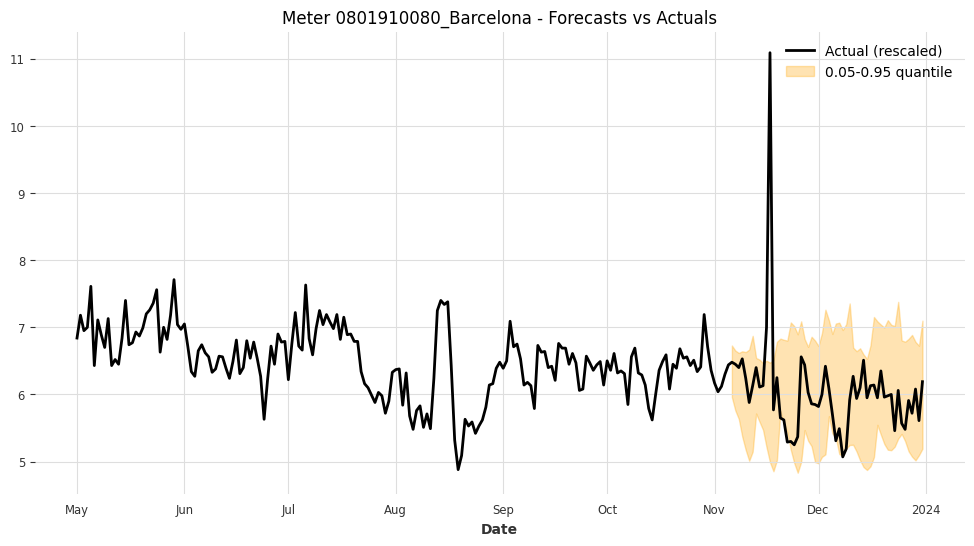

Meter 0801910080_Barcelona - Coverage: 0.8750, Width: 1.6046



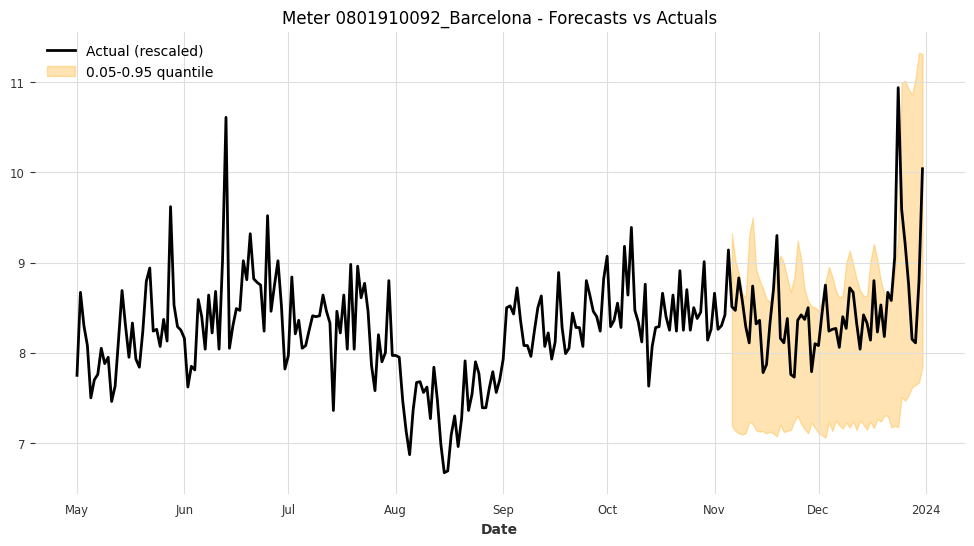

Meter 0801910092_Barcelona - Coverage: 0.8929, Width: 1.8850



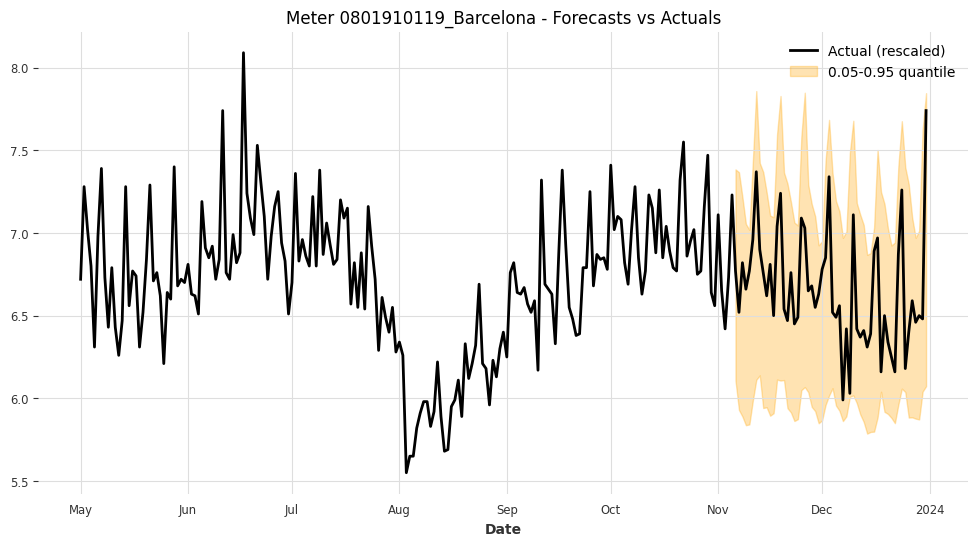

Meter 0801910119_Barcelona - Coverage: 1.0000, Width: 1.3187



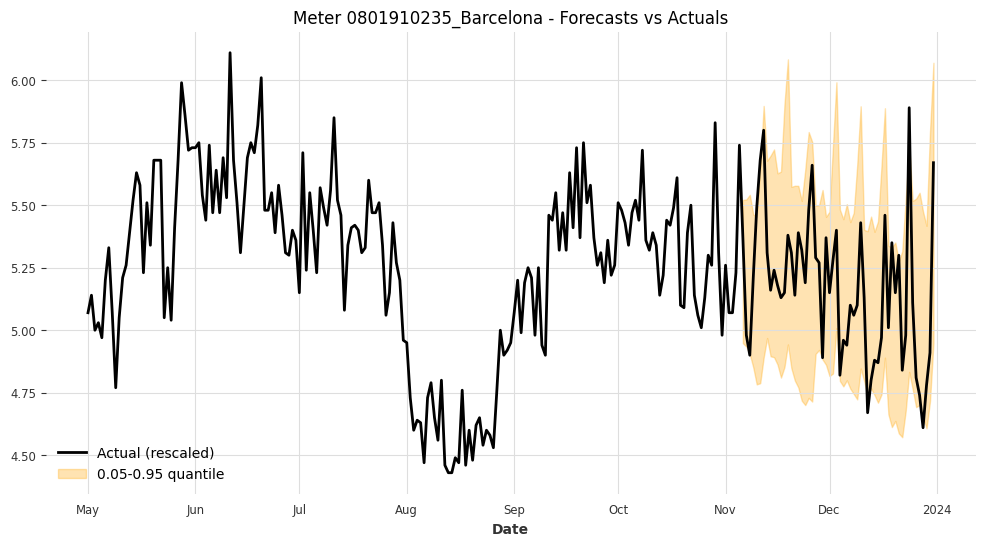

Meter 0801910235_Barcelona - Coverage: 0.8571, Width: 0.7935



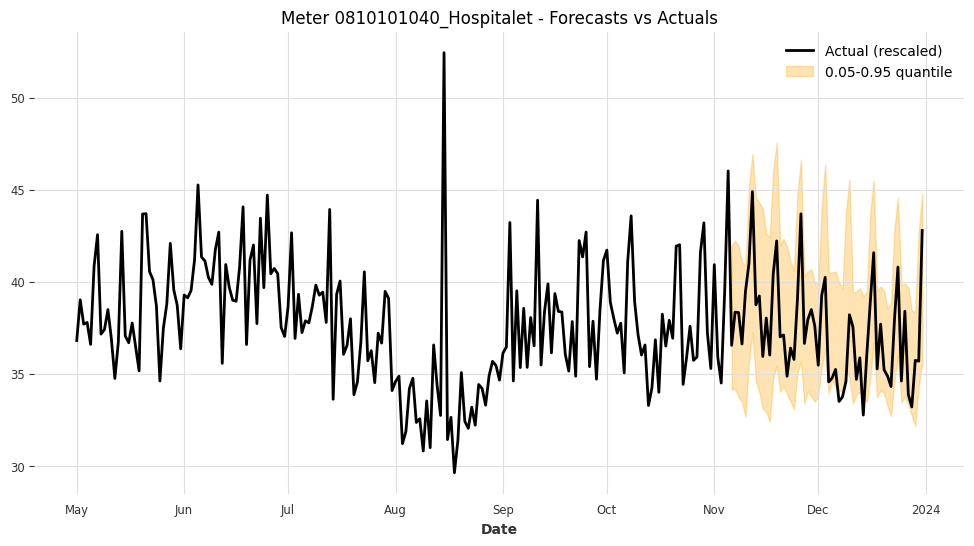

Meter 0810101040_Hospitalet - Coverage: 0.9286, Width: 7.7476



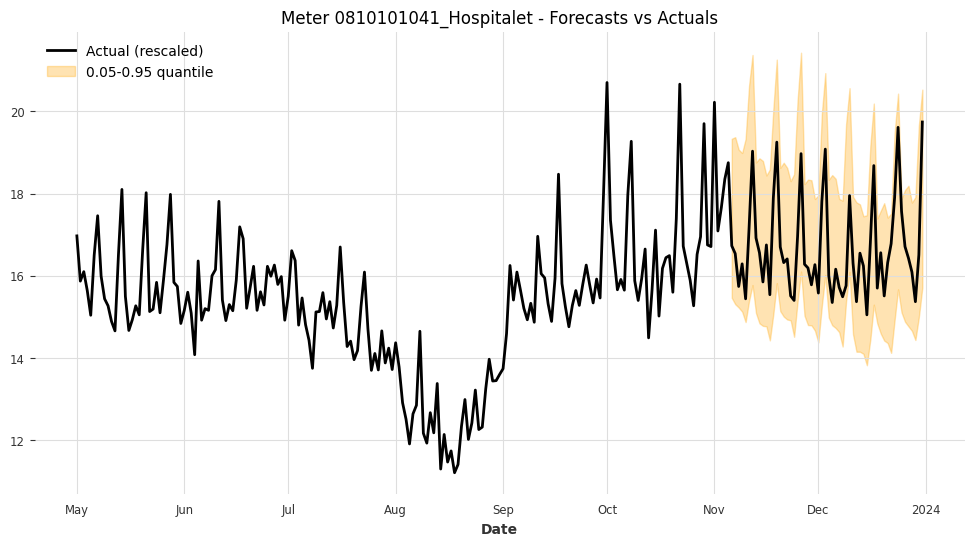

Meter 0810101041_Hospitalet - Coverage: 1.0000, Width: 3.9162



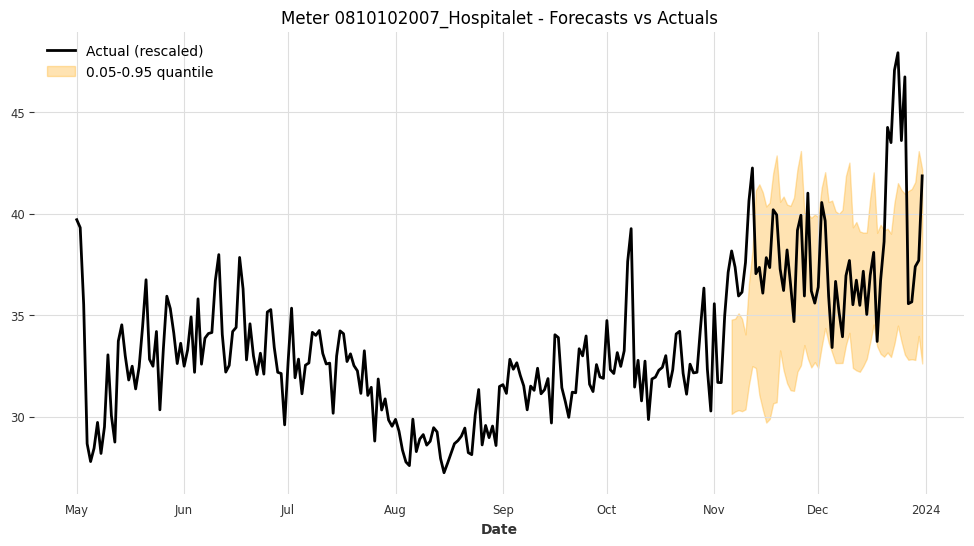

Meter 0810102007_Hospitalet - Coverage: 0.7500, Width: 7.6545



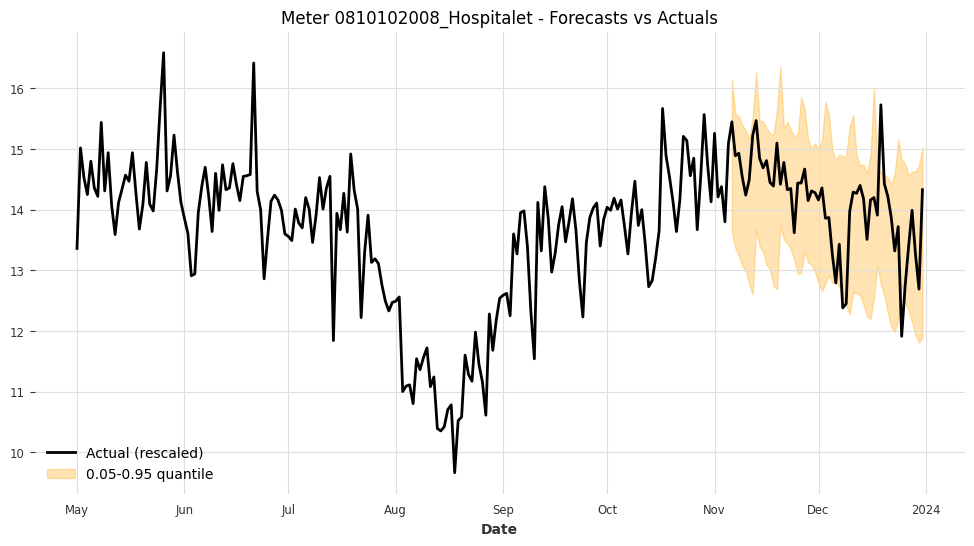

Meter 0810102008_Hospitalet - Coverage: 0.9286, Width: 2.3952



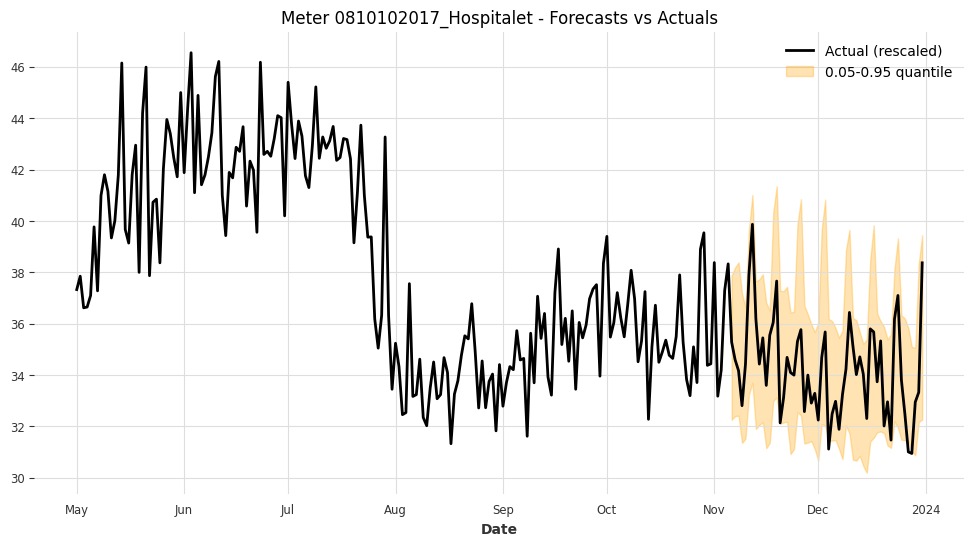

Meter 0810102017_Hospitalet - Coverage: 0.9464, Width: 5.6842



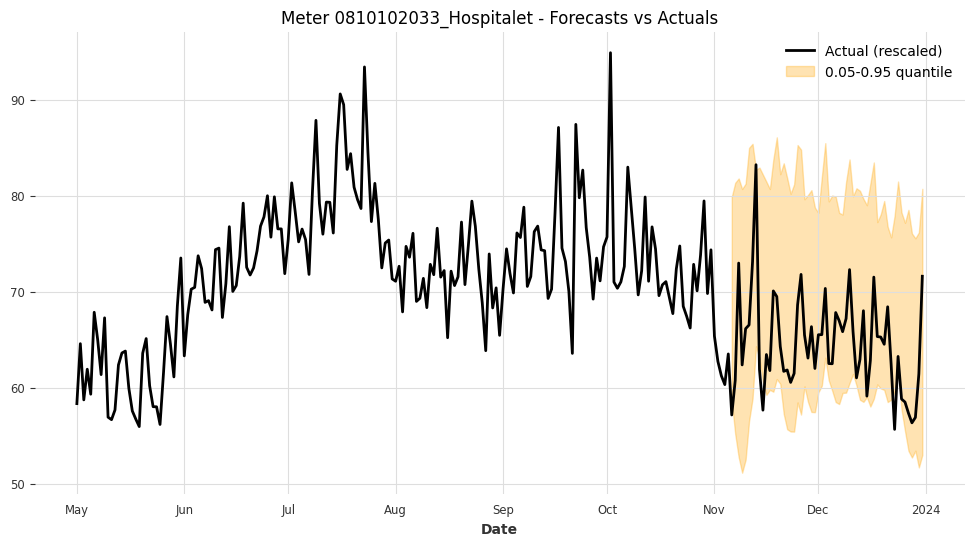

Meter 0810102033_Hospitalet - Coverage: 0.9107, Width: 22.4128



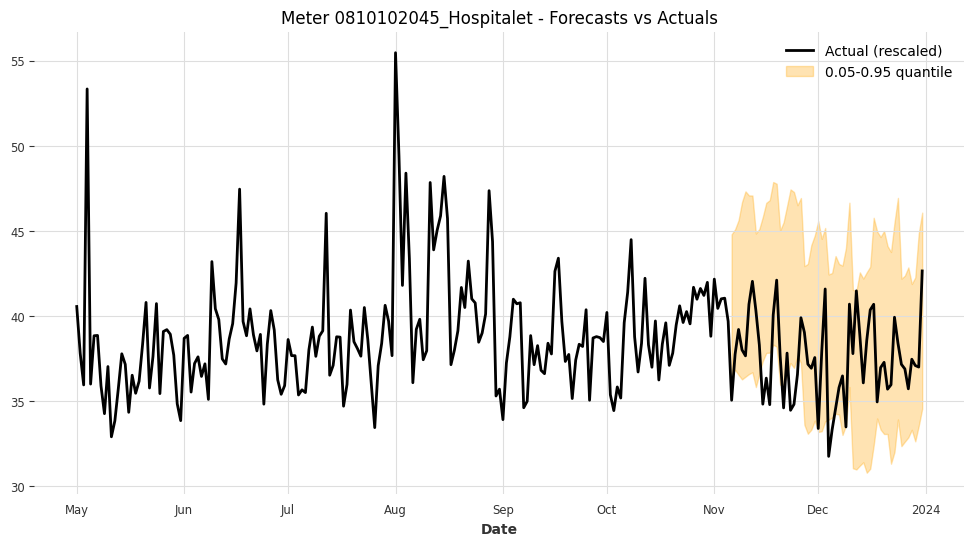

Meter 0810102045_Hospitalet - Coverage: 0.7857, Width: 10.2848



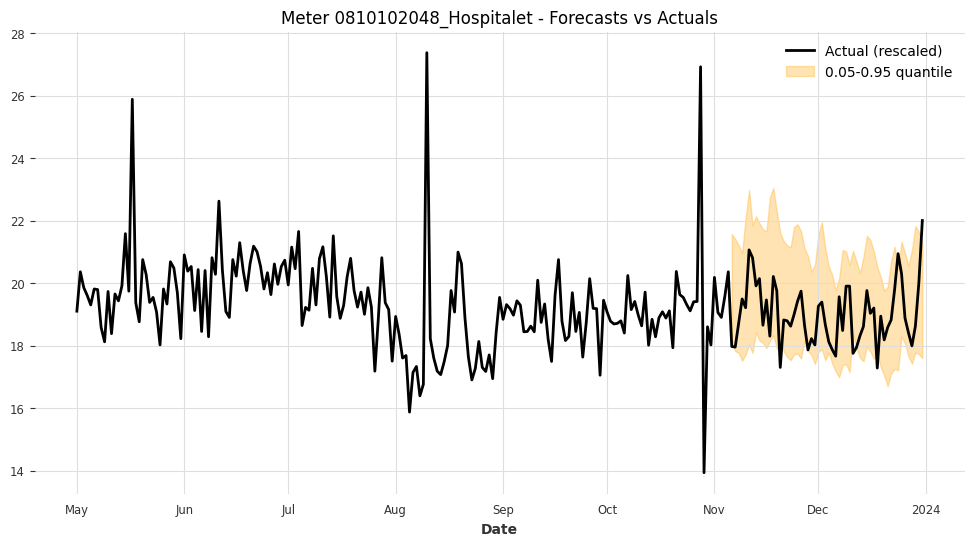

Meter 0810102048_Hospitalet - Coverage: 0.8929, Width: 3.5009



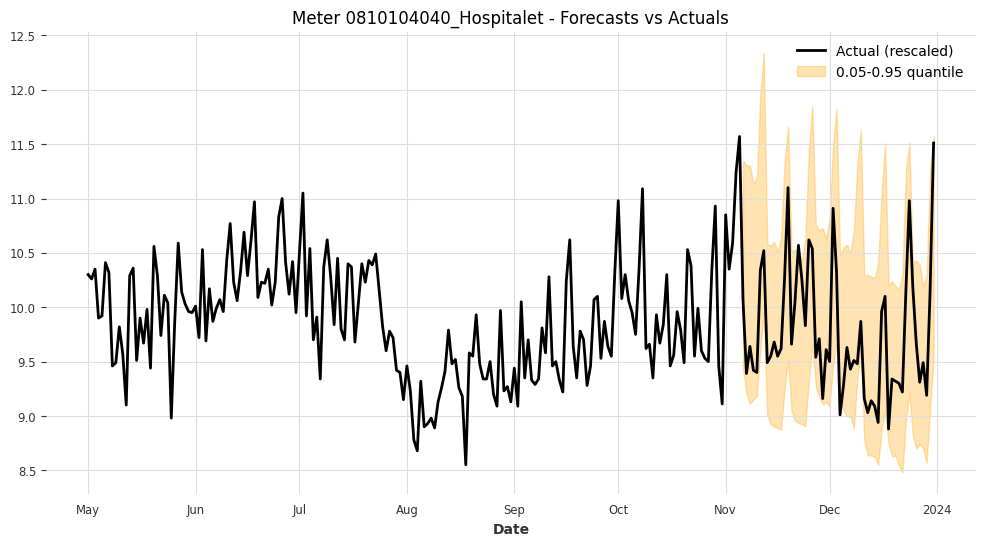

Meter 0810104040_Hospitalet - Coverage: 0.9643, Width: 1.8115



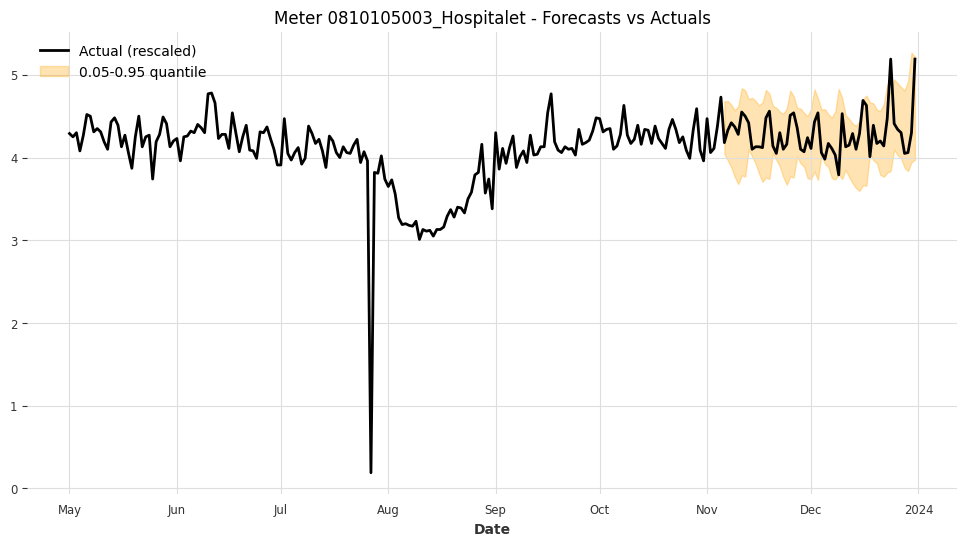

Meter 0810105003_Hospitalet - Coverage: 0.9464, Width: 0.8382



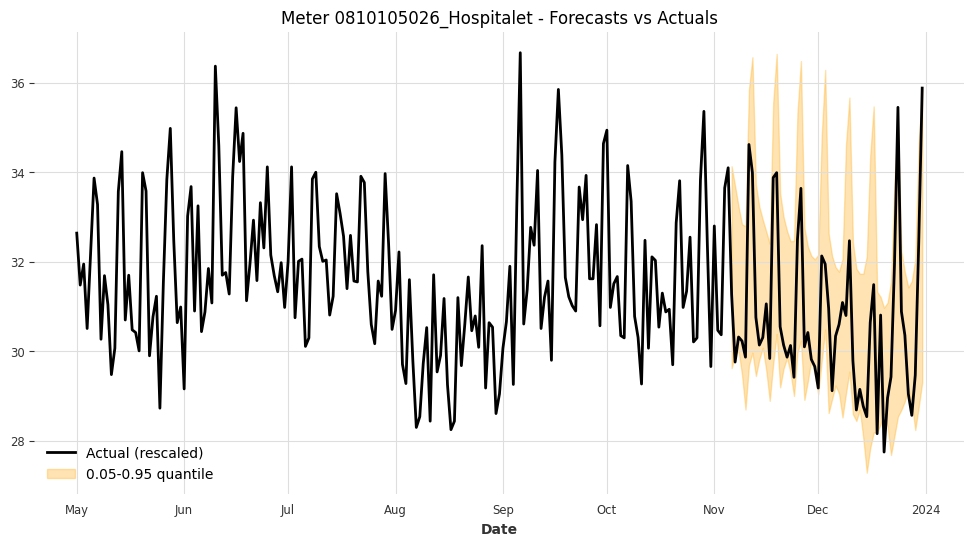

Meter 0810105026_Hospitalet - Coverage: 0.8750, Width: 4.1134



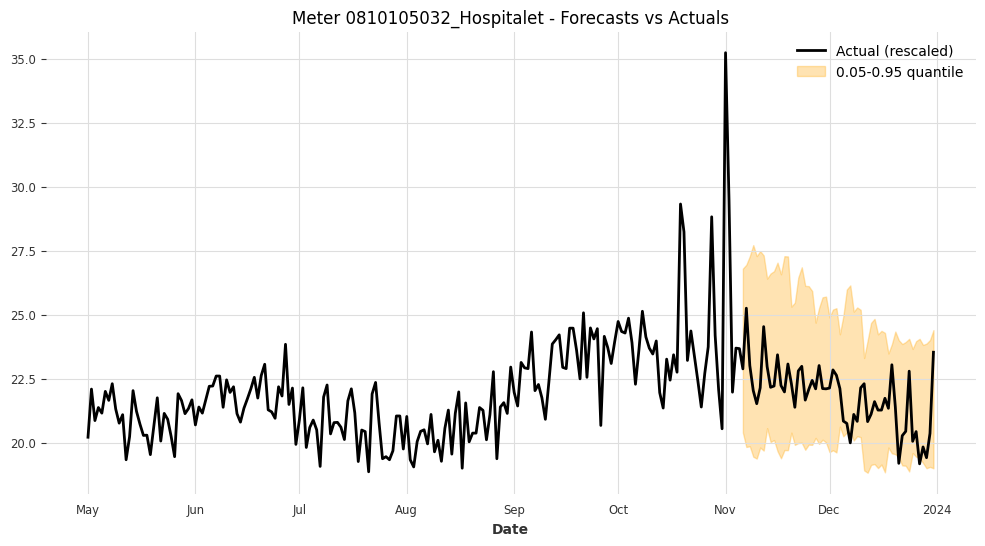

Meter 0810105032_Hospitalet - Coverage: 0.9464, Width: 5.6679



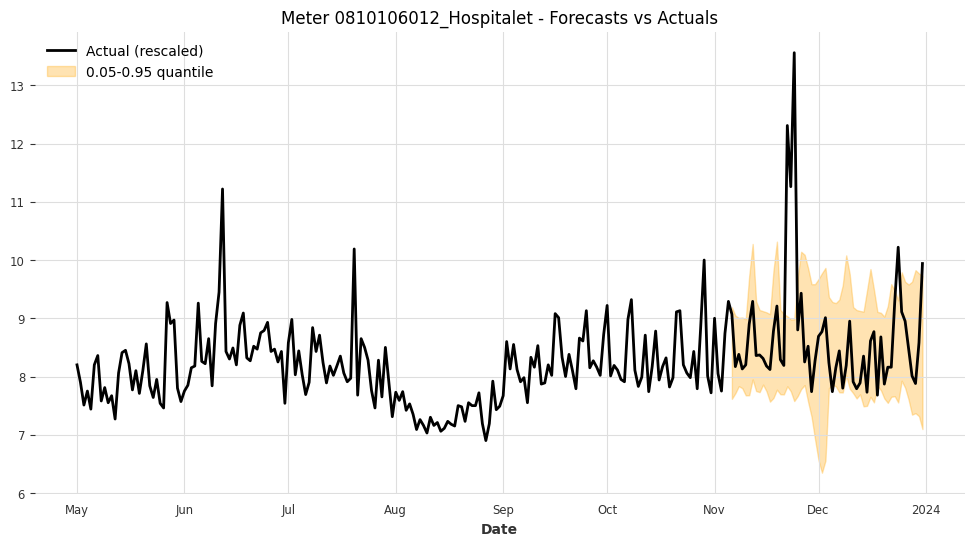

Meter 0810106012_Hospitalet - Coverage: 0.8750, Width: 1.8540



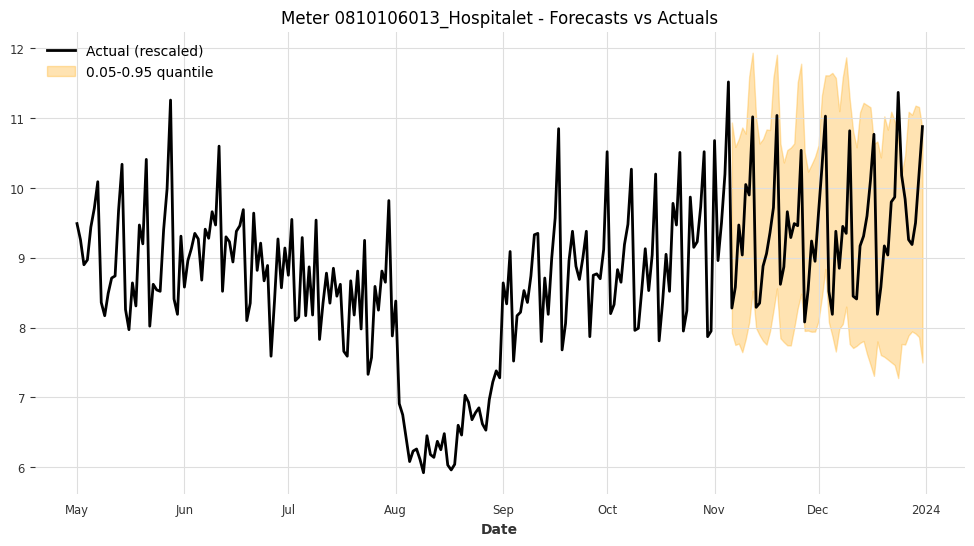

Meter 0810106013_Hospitalet - Coverage: 0.9464, Width: 3.1045



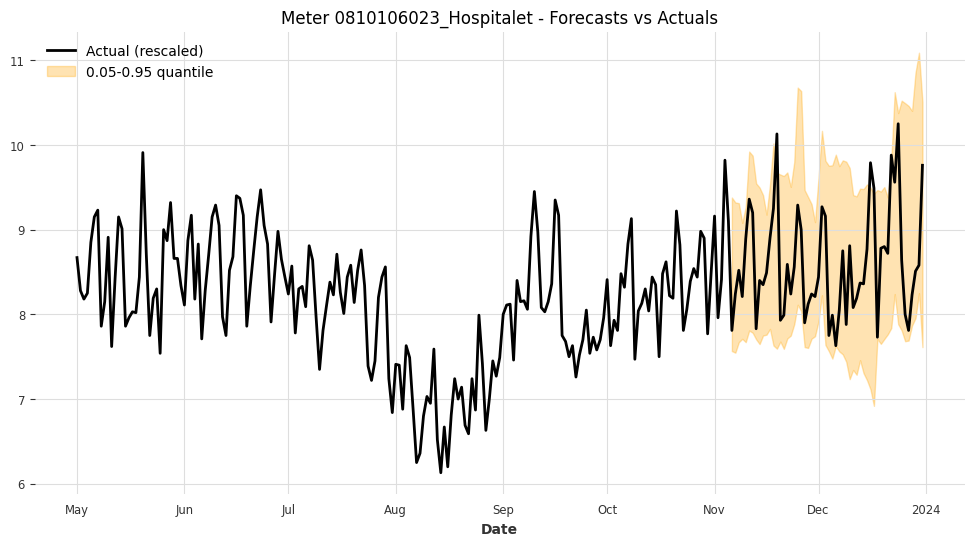

Meter 0810106023_Hospitalet - Coverage: 0.9286, Width: 2.0965



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # Darts utility to merge TimeSeries

for meter_id, hfcs in all_hfcs.items():
    # Get the actual time series
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width = df_result["Width rescaled"].iloc[0]

    # Start a new plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    full_lower = []
    full_upper = []

    # Collect lower and upper quantiles from each forecast window
    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components
            and 'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)


    if full_lower and full_upper:
        # Concatenate all the TimeSeries pieces into full series
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        # Plot the quantile area as a filled region
        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05-0.95 quantile'
        )

    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals")
    ax.legend()
    plt.show()

    # Print the metrics below each plot
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Width: {width:.4f}\n")


In [ ]:
# Let's continue with the standard scaling

In [ ]:
# Load model
model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/simple/TFT_model_standard.pkl")

In [ ]:
# Load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test_standard.pkl')

# Extract components
scaled_val_series = test_data['validation']        # validation not used in our case
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

Loaded 60 time series for testing.


In [ ]:
# Constants
start_date = pd.Timestamp("2023-11-6")
horizon = 7
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}

# Initialize the conformal quantile regression model
cp_model = ConformalQRModel(
    model=model,
    quantiles=quantiles,
    symmetric=False
    # if cal_length is None, it considers all calibration scores
)
q_interval = cp_model.q_interval  # [(0.05, 0.95)]
q_range = cp_model.interval_range  # [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = cp_model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=start_date,
        last_points_only=False,
        stride=7,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    # We evaluate the already-generated historical forecasts
    bt = cp_model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        retrain=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": bt[1], "Width rescaled": mean_width})
    print(f"Results for meter {meter_id}:\n", df_results, "\n")

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 296.18it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801501002_Badalona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  1.878867       22.184278 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 367.36it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801503008_Badalona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  1.519982       24.722222 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 410.72it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  5.654897       11.984187 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 383.73it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  1.006444        1.979381 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 421.58it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.598824        3.806492 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 296.66it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.642857  2.217966        3.831804 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 383.59it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.577236        3.371936 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 335.20it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.821429  1.924901        3.054331 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 382.43it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.947409        0.886628 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 289.30it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  2.462967        1.078191 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 371.58it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  2.329667        4.248137 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 346.98it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  2.313542         4.59444 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 339.90it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  1.815597        1.159386 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 402.66it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903081_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  2.120217        2.895336 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 400.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.732143  1.424799        7.006476 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 418.82it/s]


Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.803571  1.849913        3.792091 



INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 231.69it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801905054_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.976006       17.641971 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 391.34it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.679908        6.753369 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 366.34it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906002_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.839286  1.93443         2.87538 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 344.00it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  2.222365        8.513271 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 360.99it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906041_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.897101        8.164027 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 381.28it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.821429  0.795091        1.689886 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 373.44it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907011_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.857143  1.927369        3.166868 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 270.13it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907013_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  1.563925          2.3062 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 251.69it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  2.650127       11.117977 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 403.48it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  1.978198        5.118823 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 263.00it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  3.824298       13.085531 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 346.22it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9       1.0  1.185428        8.879788 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 265.33it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801907115_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9       1.0  1.584403       23.487253 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 380.80it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.590824        3.732376 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 289.89it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.821429  1.625127         2.78844 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 362.20it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  1.575246        0.709992 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 385.66it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  1.916212        2.270408 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 379.85it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908049_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.892857  1.45868       13.938869 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 375.25it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908061_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  1.621726        1.236957 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 419.67it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  1.397267        5.255769 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 403.11it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.660714  2.284128        8.651166 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 298.45it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  1.155523         5.31766 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 375.14it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  1.481086        8.507994 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 423.08it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  3.683932        10.83326 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 373.29it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910054_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  2.458652        5.237011 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 349.05it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  2.724843        1.776169 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 403.28it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  2.743852        1.665685 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 394.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.839245        0.846597 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 252.32it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  1.495316        0.756966 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 387.53it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  1.843756        7.252253 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 415.54it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  1.642411        3.565751 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 394.12it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9      0.75  4.117111        9.265496 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 277.19it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  1.676252        2.324223 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 382.43it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  1.927795        5.473121 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 411.05it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102033_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.517857  2.985024       17.656571 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 399.78it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.785714  2.218694       10.017416 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 254.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  2.262897        3.725111 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 360.23it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  2.429217         1.46394 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 312.63it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  1.012183        0.638036 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 389.24it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  1.698215        4.102527 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 398.74it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9       1.0  2.111663        5.713133 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 371.31it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106012_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  1.563741        1.983493 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 372.24it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  2.504813        2.853121 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 250.34it/s]

Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  2.175066        2.066804 



In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()
mean_width_rescaled = combined_results["Width rescaled"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")
print(f"Mean Width rescaled: {mean_width_rescaled:.4f}")

Mean Coverage: 0.8920
Mean Width: 2.0014
Mean Width rescaled: 6.0837


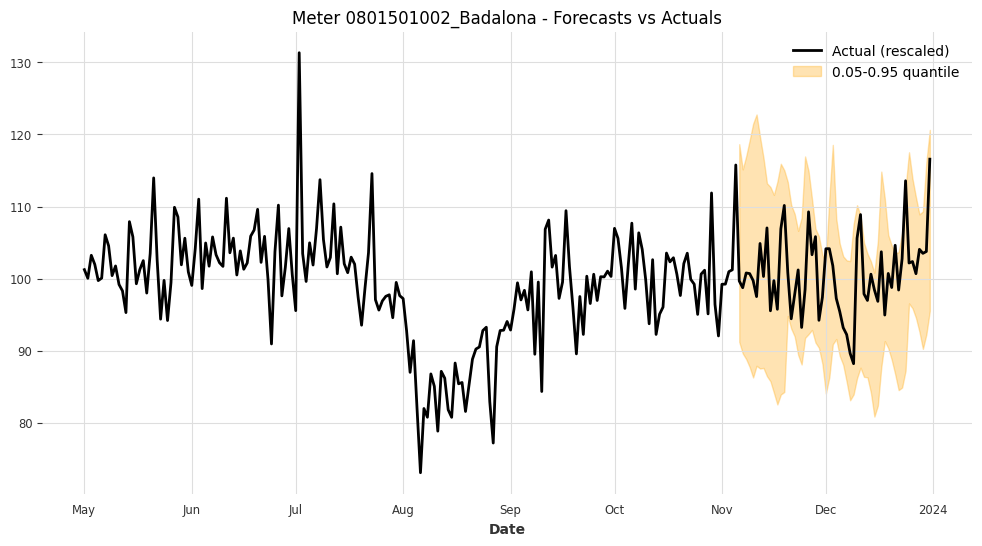

Meter 0801501002_Badalona - Coverage: 0.9286, Width: 22.1843



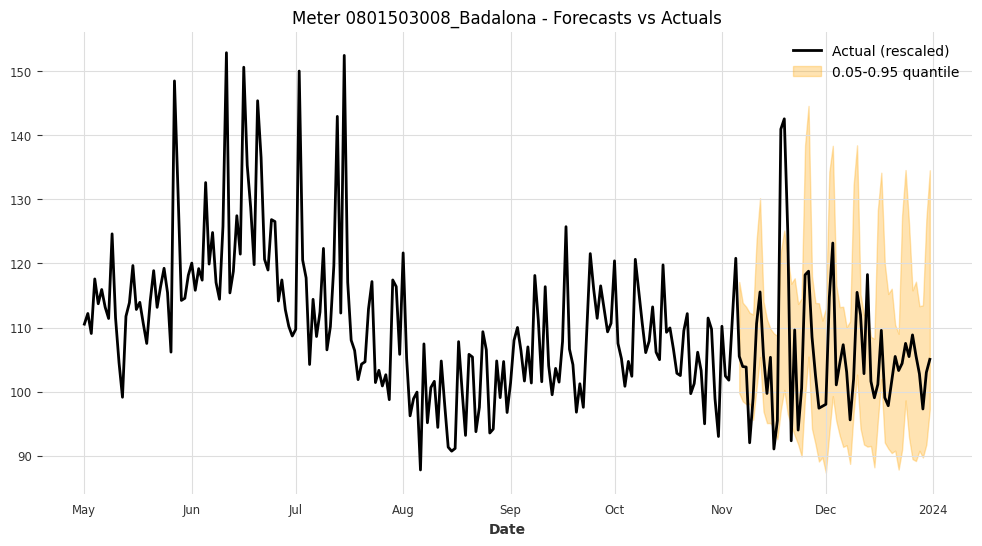

Meter 0801503008_Badalona - Coverage: 0.8750, Width: 24.7222



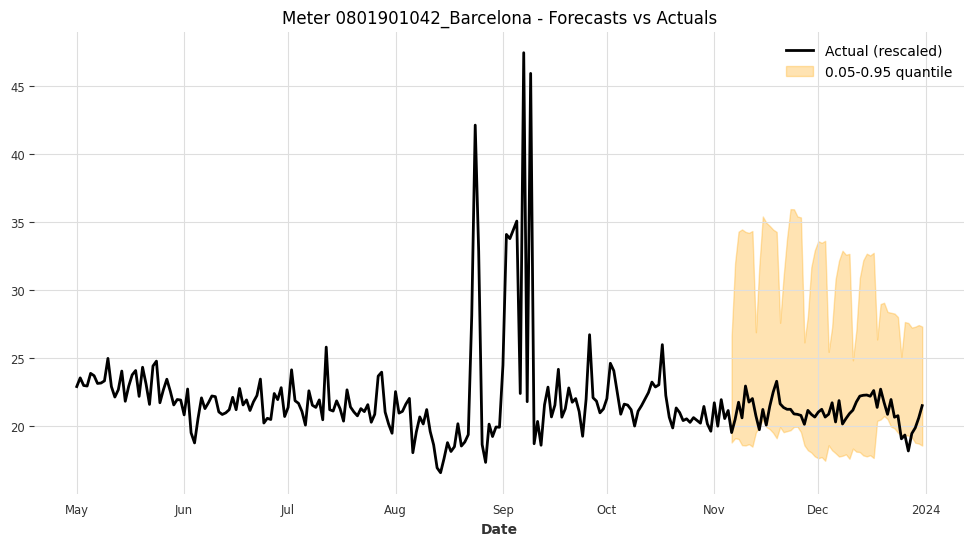

Meter 0801901042_Barcelona - Coverage: 0.9464, Width: 11.9842



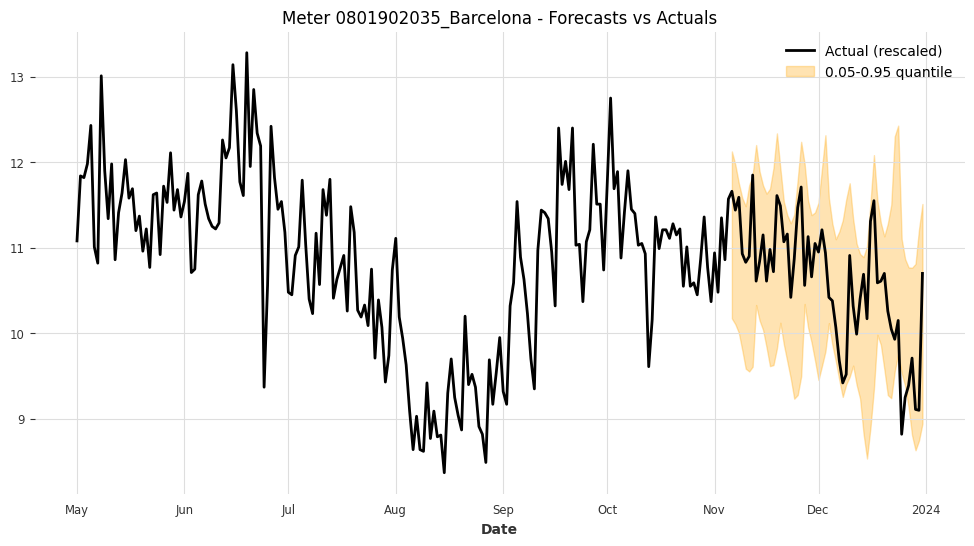

Meter 0801902035_Barcelona - Coverage: 0.9643, Width: 1.9794



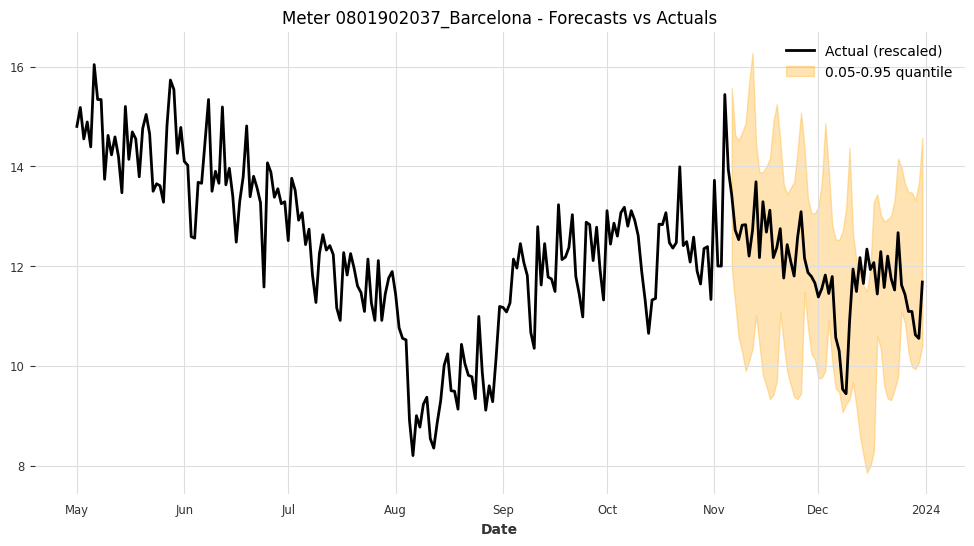

Meter 0801902037_Barcelona - Coverage: 0.9464, Width: 3.8065



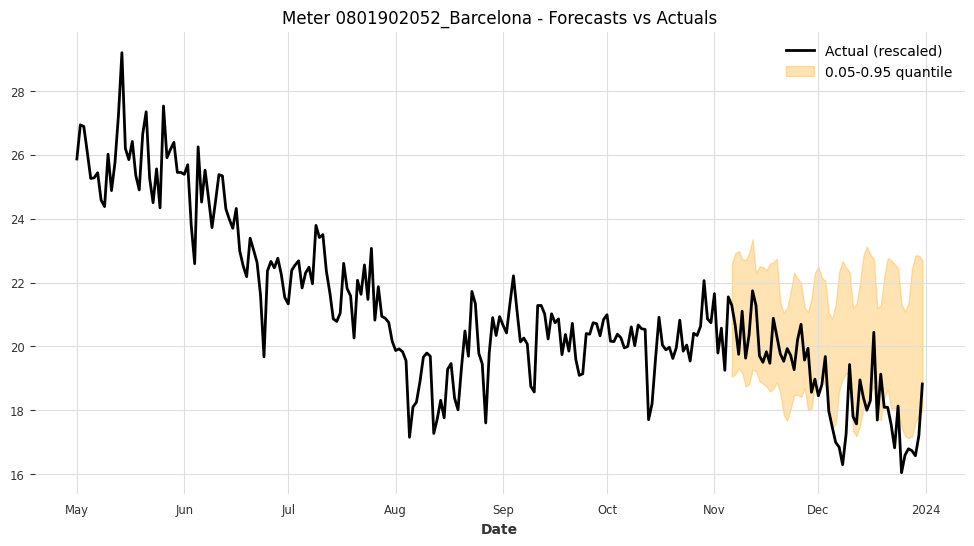

Meter 0801902052_Barcelona - Coverage: 0.6429, Width: 3.8318



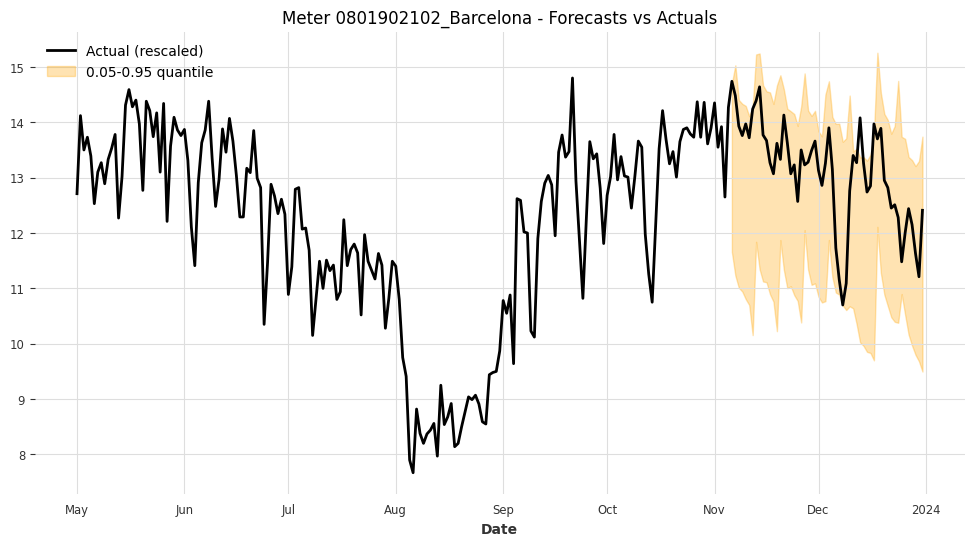

Meter 0801902102_Barcelona - Coverage: 0.9464, Width: 3.3719



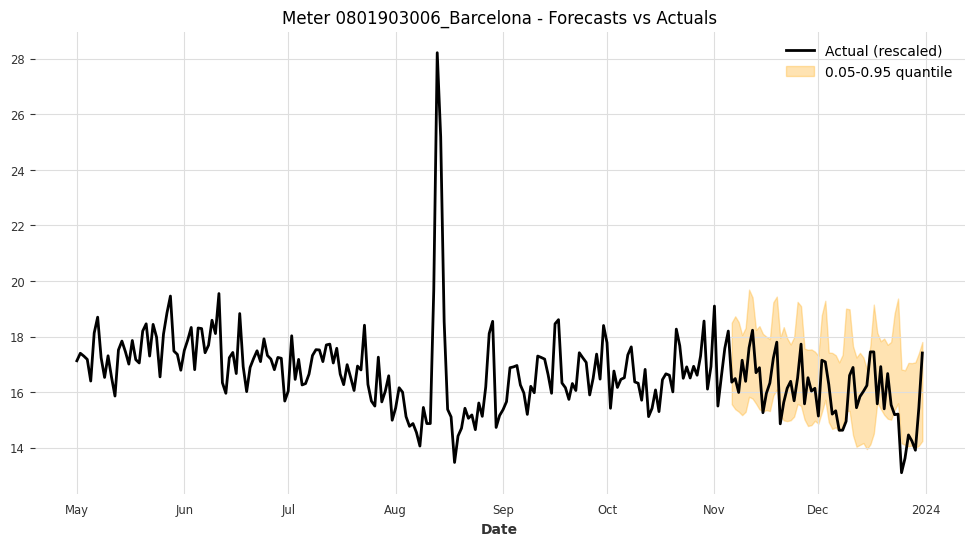

Meter 0801903006_Barcelona - Coverage: 0.8214, Width: 3.0543



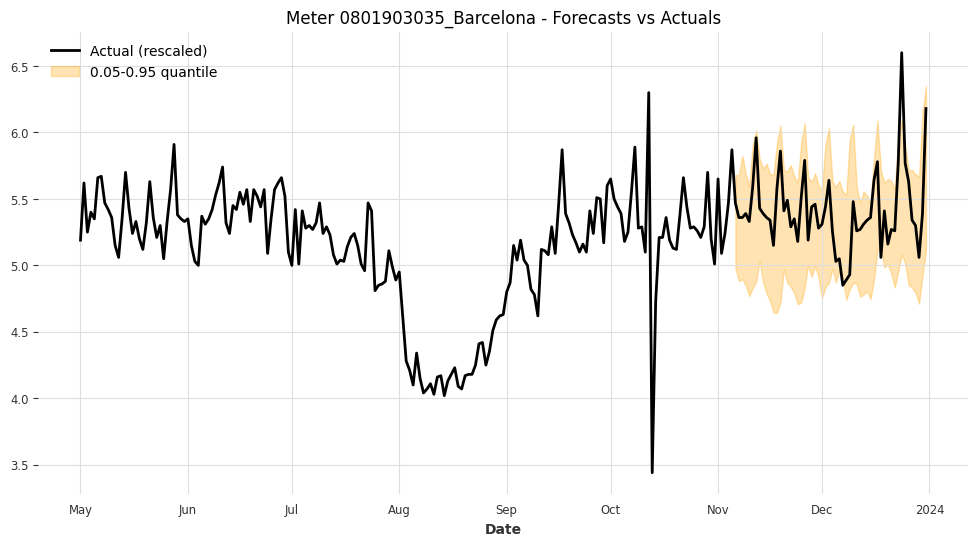

Meter 0801903035_Barcelona - Coverage: 0.9464, Width: 0.8866



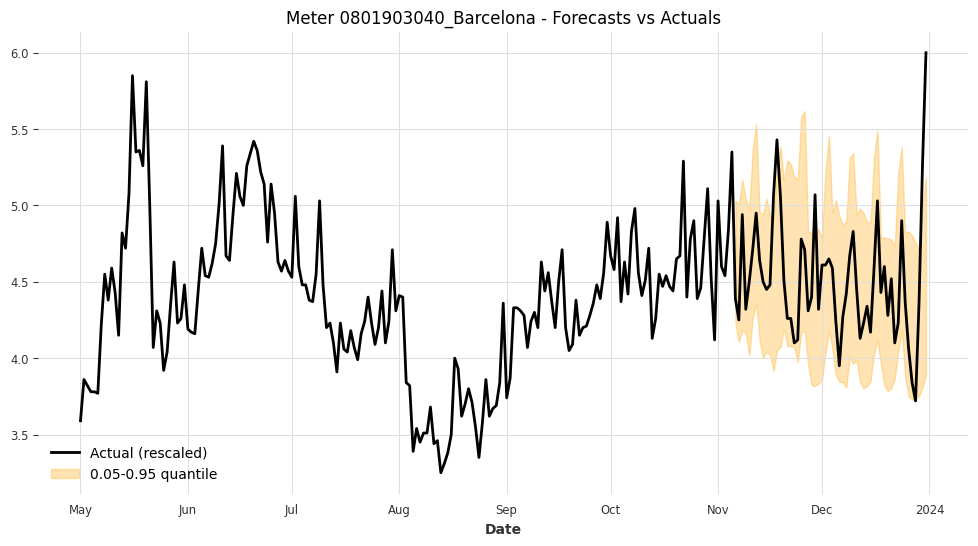

Meter 0801903040_Barcelona - Coverage: 0.8929, Width: 1.0782



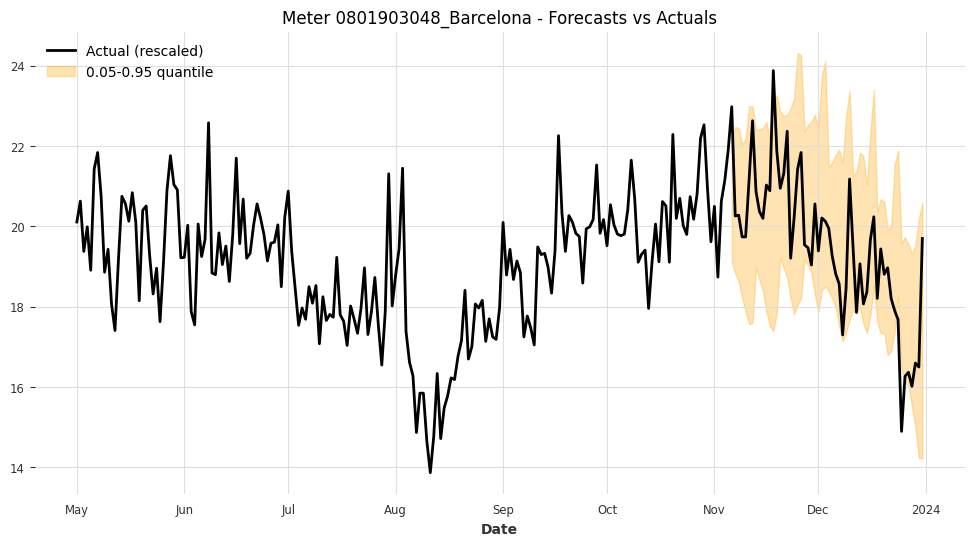

Meter 0801903048_Barcelona - Coverage: 0.9286, Width: 4.2481



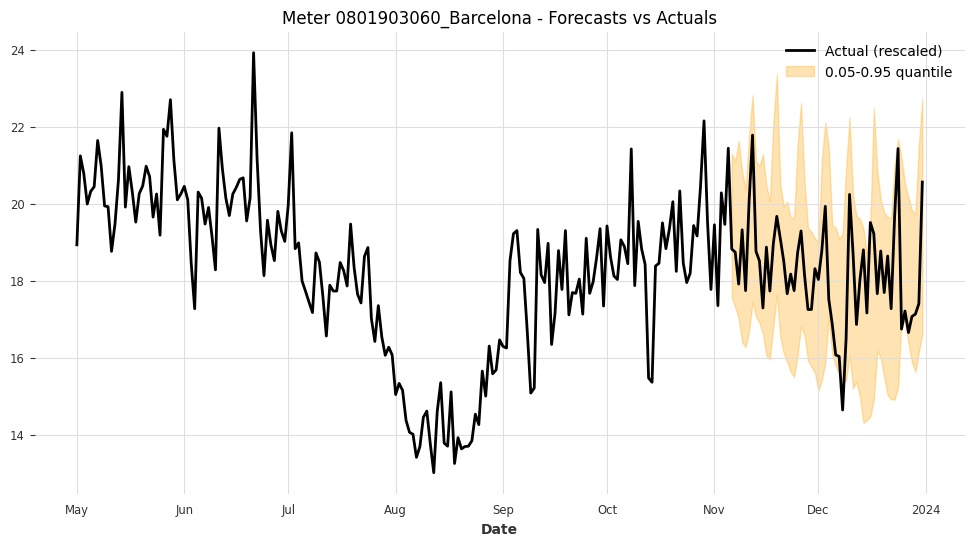

Meter 0801903060_Barcelona - Coverage: 0.9464, Width: 4.5944



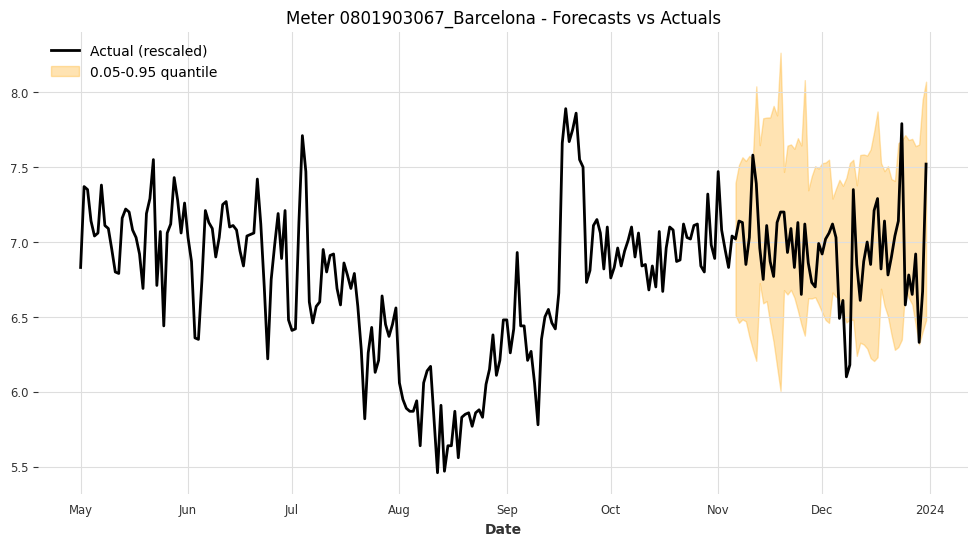

Meter 0801903067_Barcelona - Coverage: 0.8929, Width: 1.1594



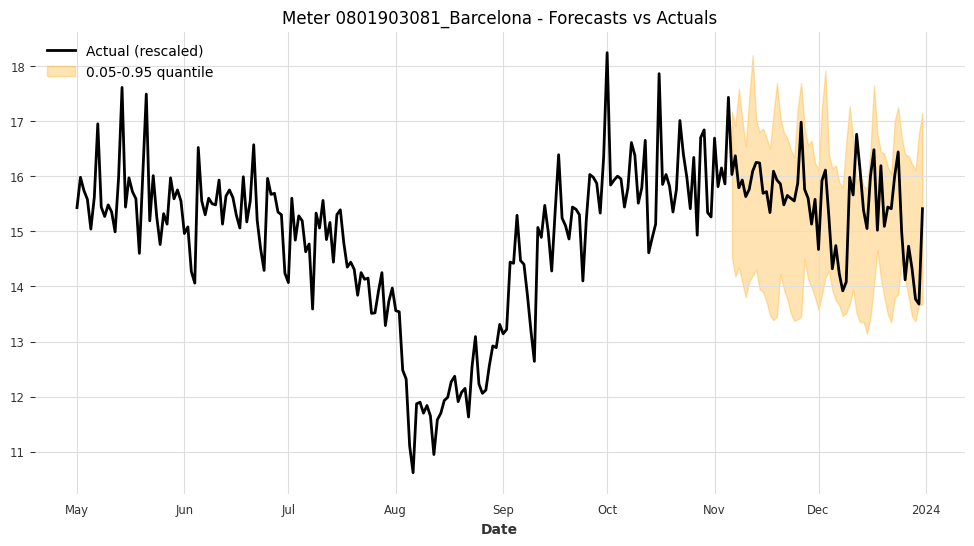

Meter 0801903081_Barcelona - Coverage: 0.9464, Width: 2.8953



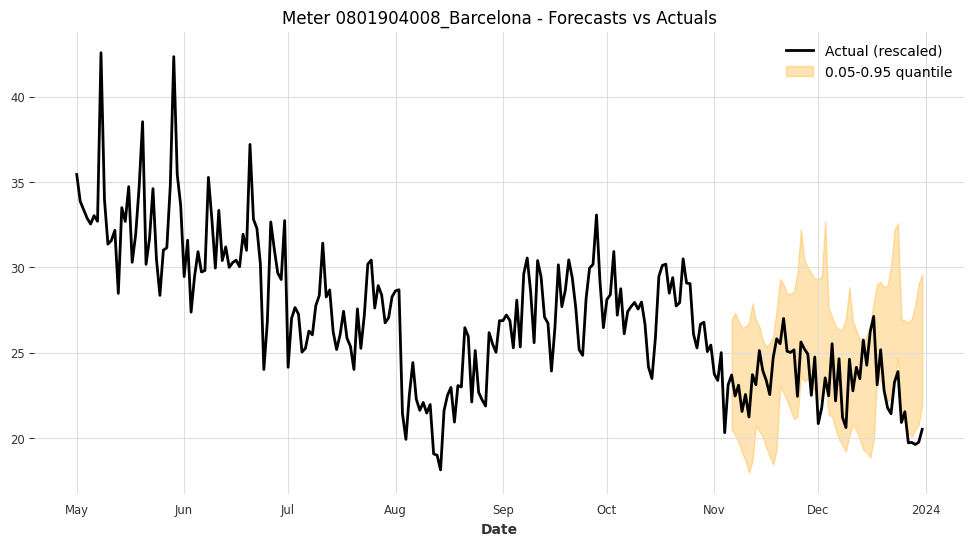

Meter 0801904008_Barcelona - Coverage: 0.7321, Width: 7.0065



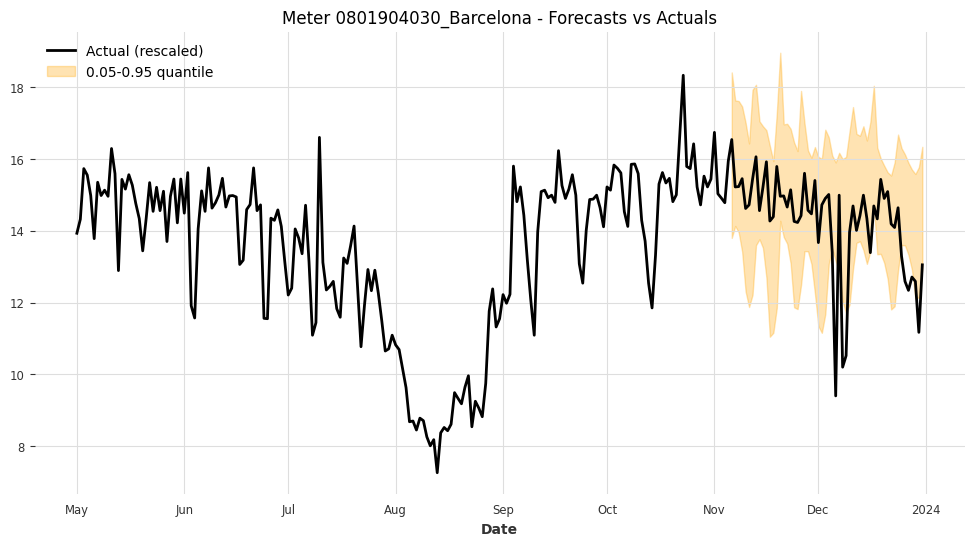

Meter 0801904030_Barcelona - Coverage: 0.8036, Width: 3.7921



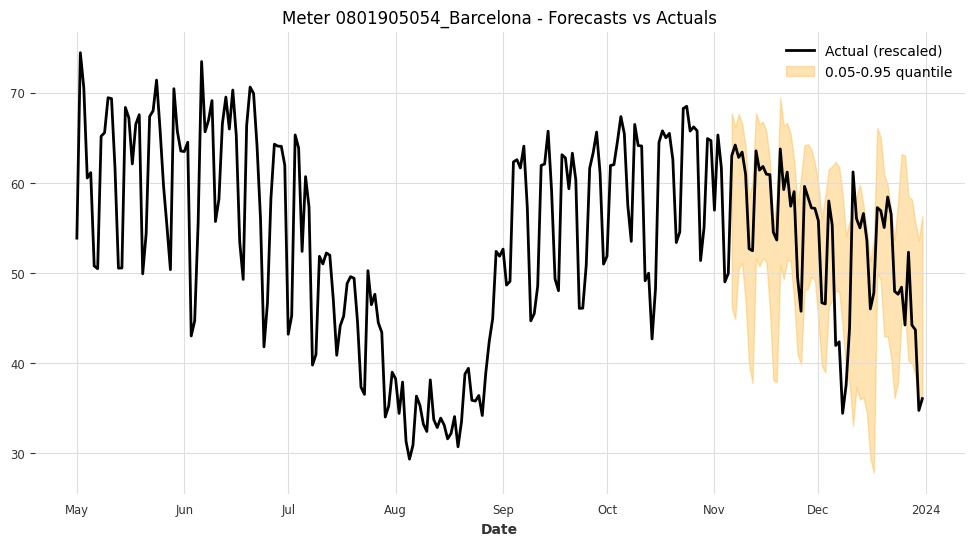

Meter 0801905054_Barcelona - Coverage: 0.8750, Width: 17.6420



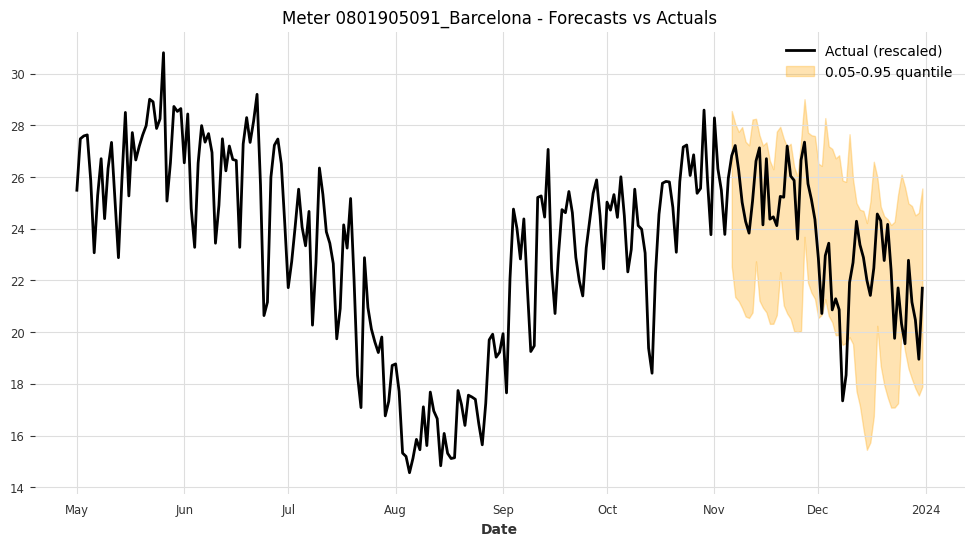

Meter 0801905091_Barcelona - Coverage: 0.9464, Width: 6.7534



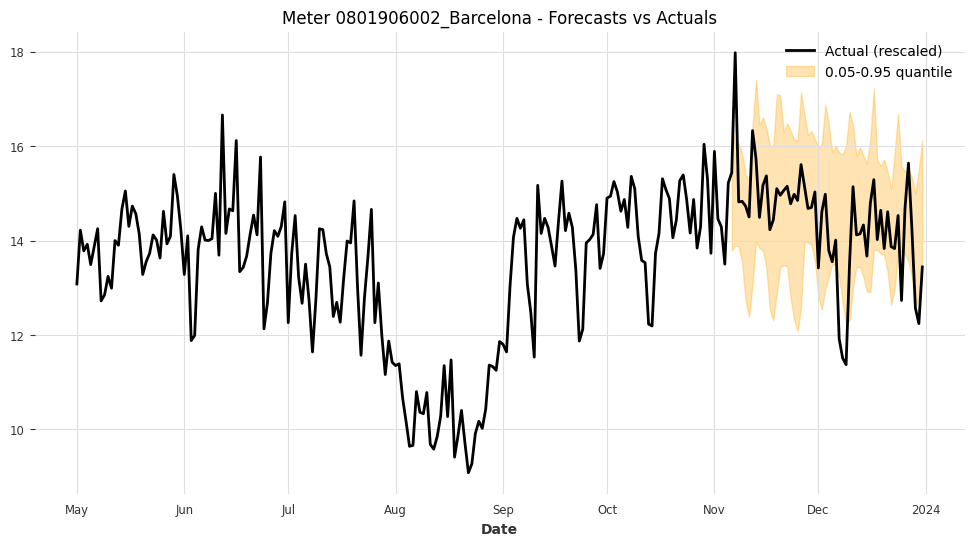

Meter 0801906002_Barcelona - Coverage: 0.8393, Width: 2.8754



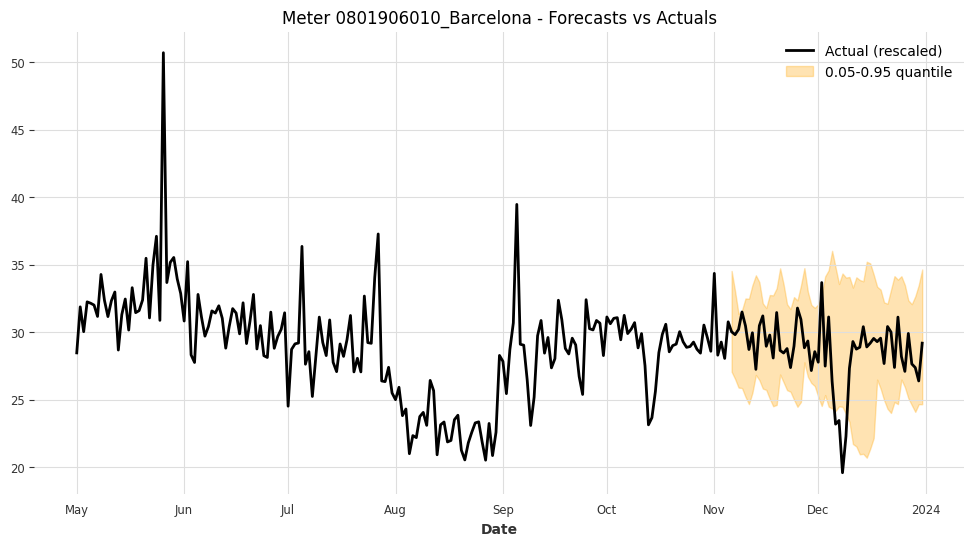

Meter 0801906010_Barcelona - Coverage: 0.9107, Width: 8.5133



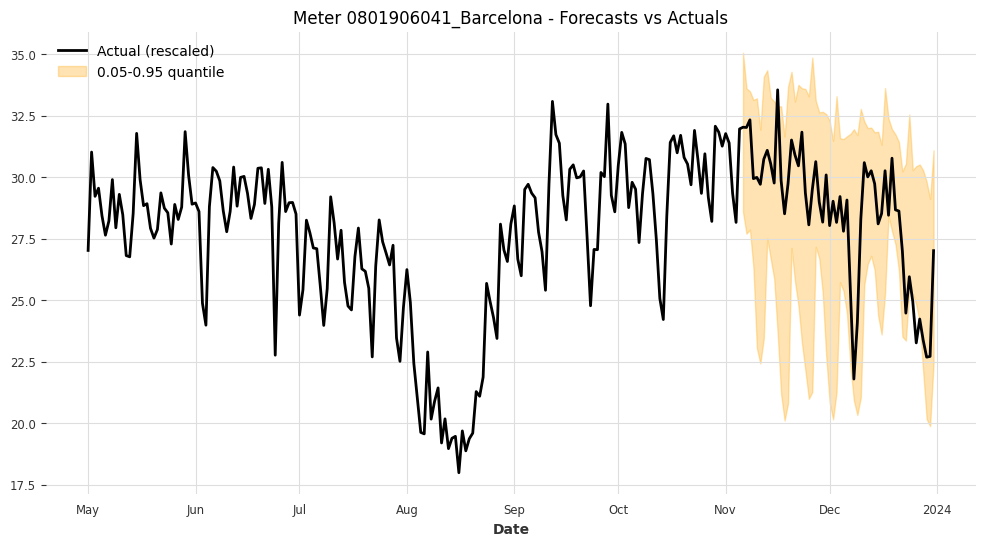

Meter 0801906041_Barcelona - Coverage: 0.9464, Width: 8.1640



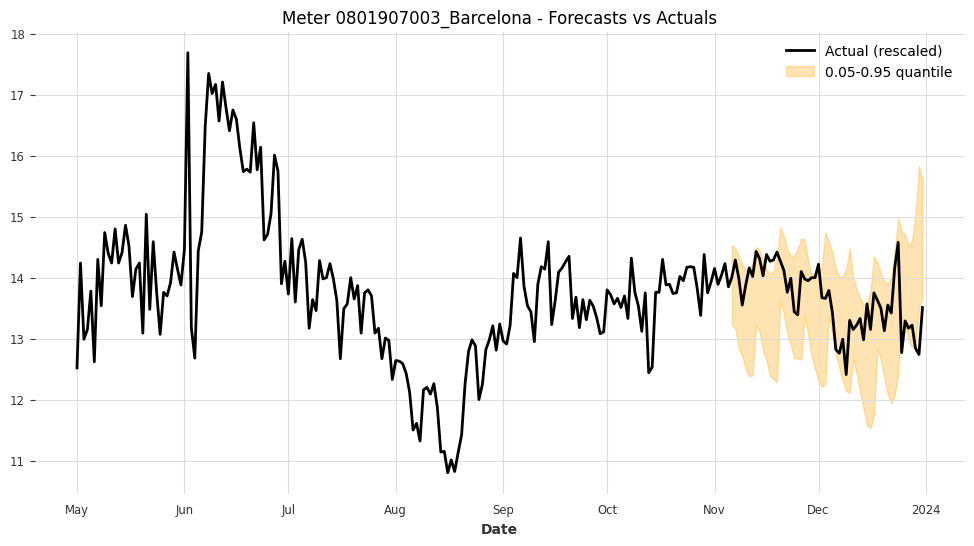

Meter 0801907003_Barcelona - Coverage: 0.8214, Width: 1.6899



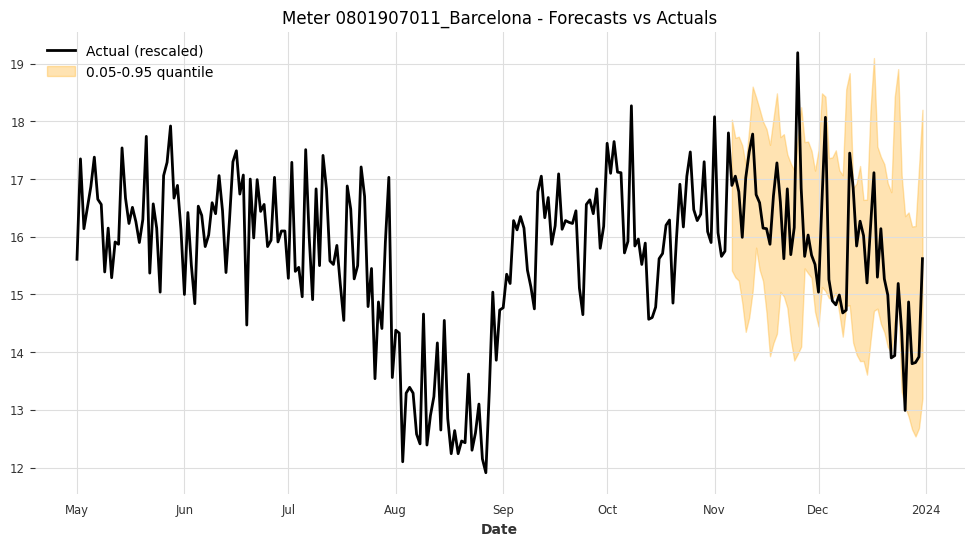

Meter 0801907011_Barcelona - Coverage: 0.8571, Width: 3.1669



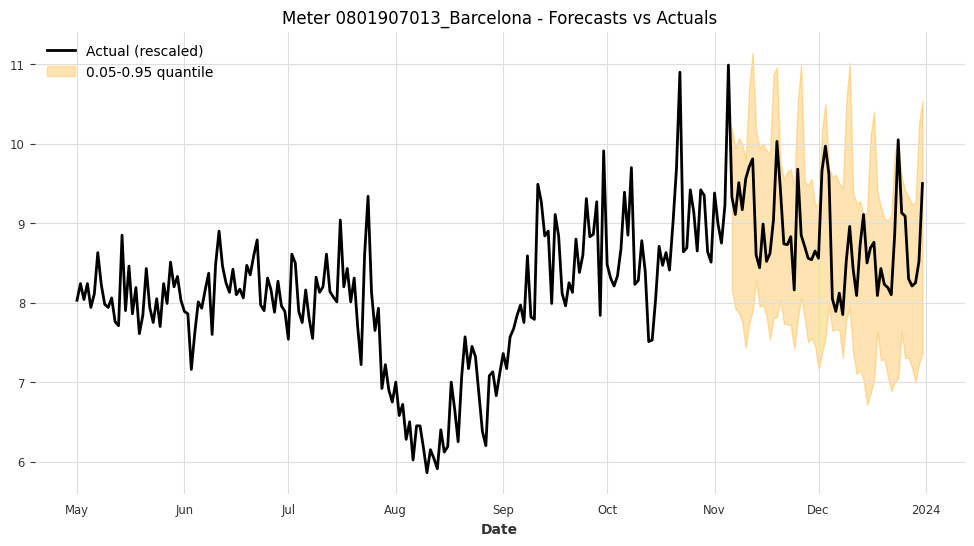

Meter 0801907013_Barcelona - Coverage: 0.9821, Width: 2.3062



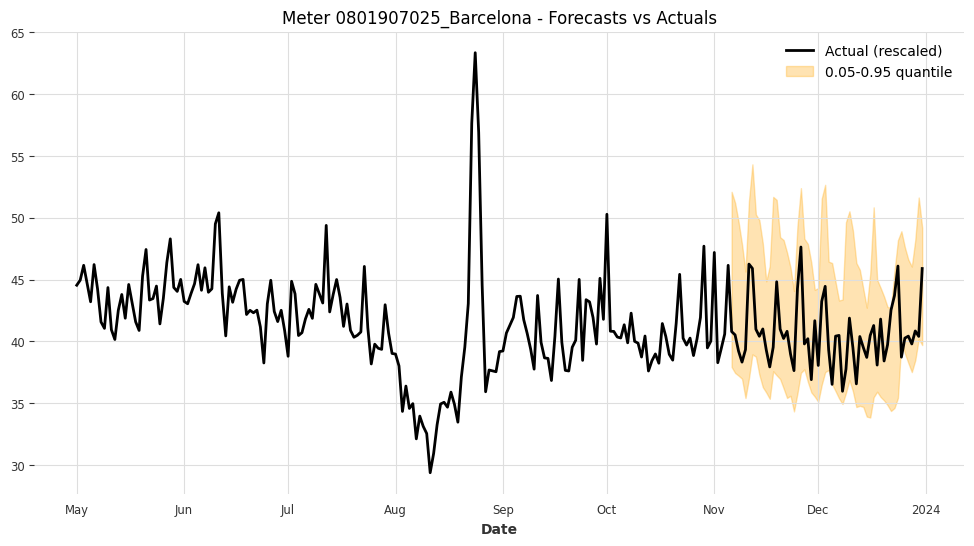

Meter 0801907025_Barcelona - Coverage: 0.9643, Width: 11.1180



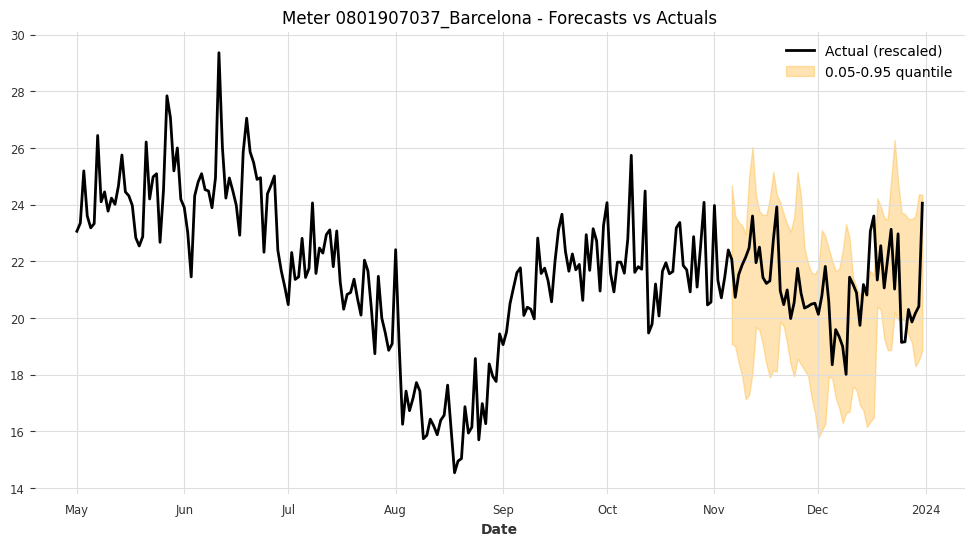

Meter 0801907037_Barcelona - Coverage: 0.9107, Width: 5.1188



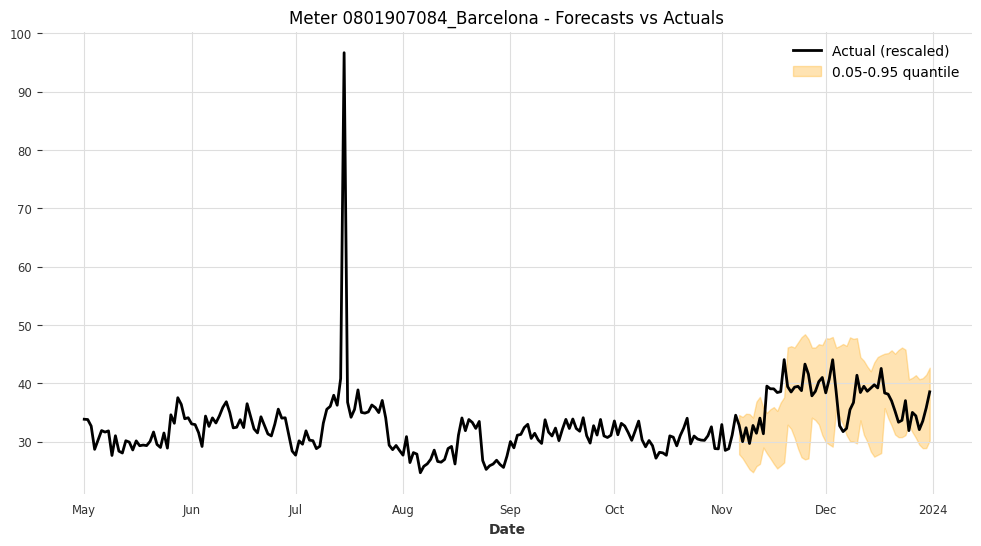

Meter 0801907084_Barcelona - Coverage: 0.8393, Width: 13.0855



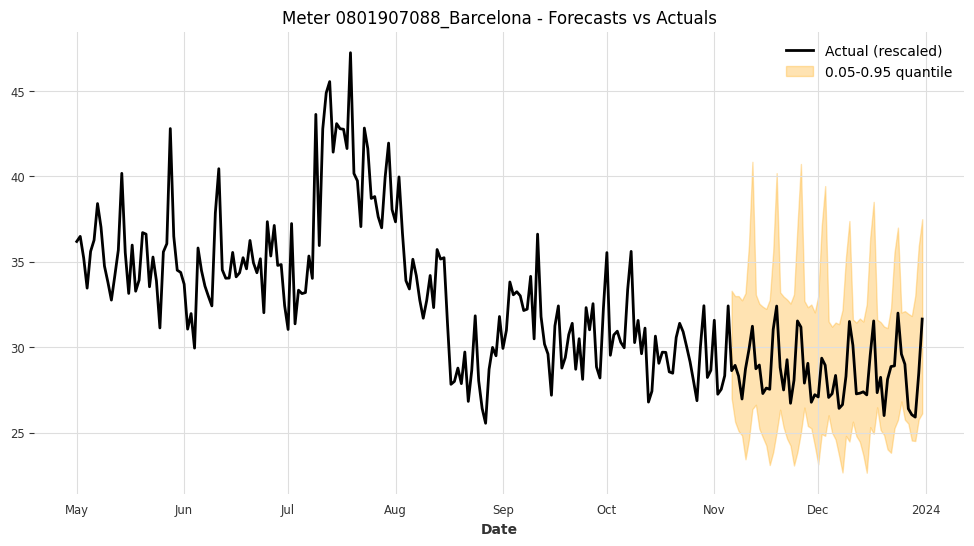

Meter 0801907088_Barcelona - Coverage: 1.0000, Width: 8.8798



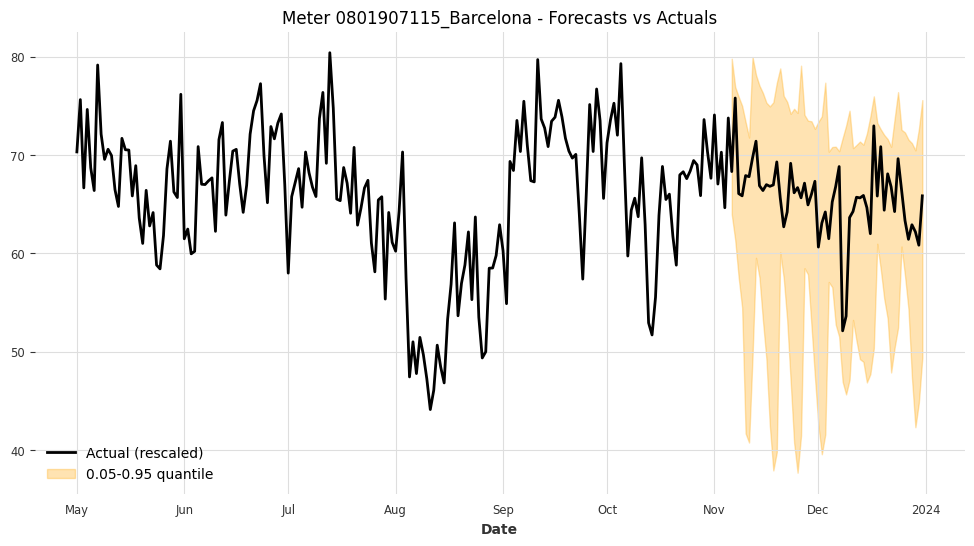

Meter 0801907115_Barcelona - Coverage: 1.0000, Width: 23.4873



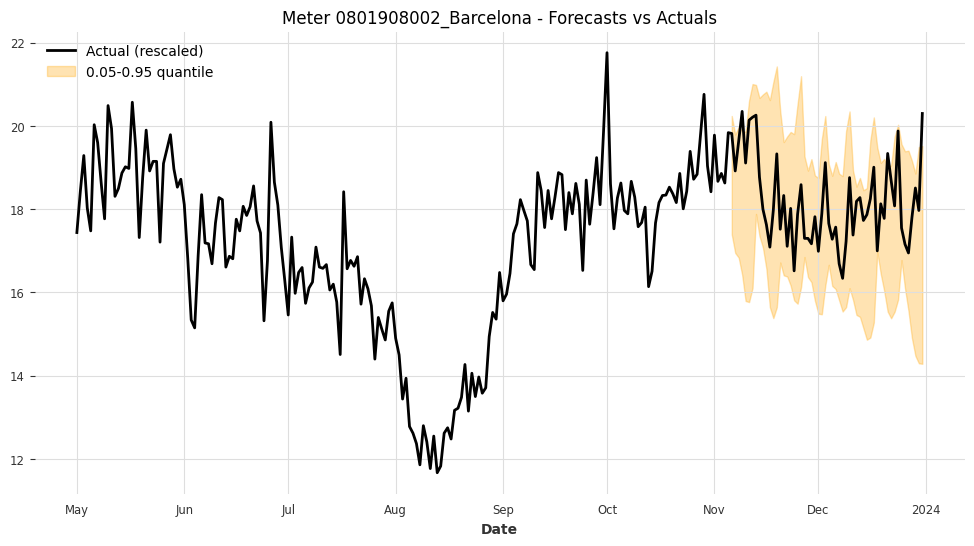

Meter 0801908002_Barcelona - Coverage: 0.9464, Width: 3.7324



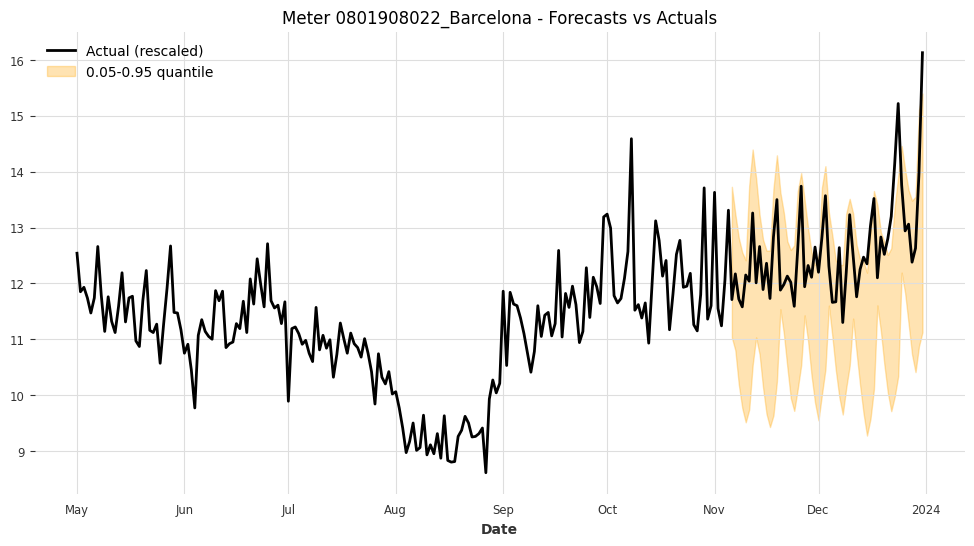

Meter 0801908022_Barcelona - Coverage: 0.8214, Width: 2.7884



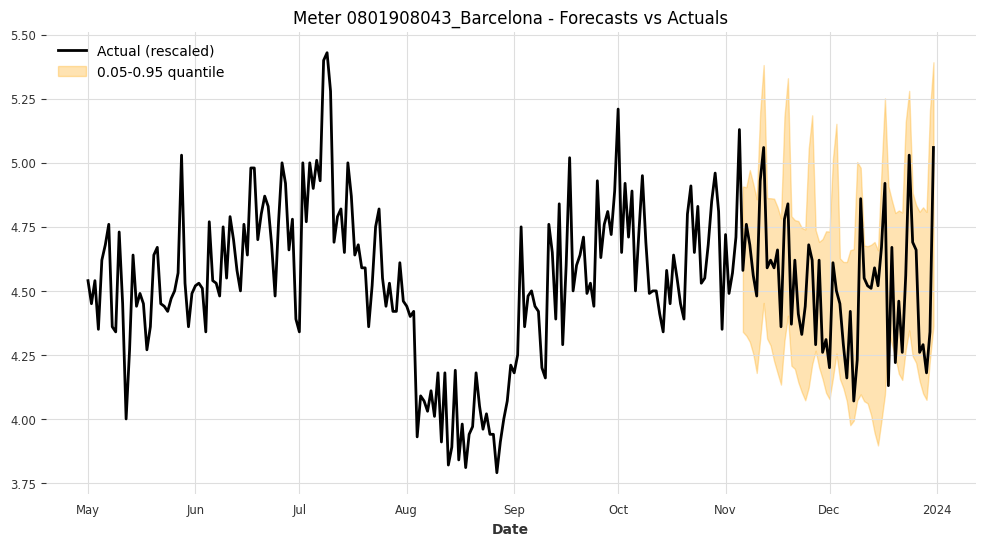

Meter 0801908043_Barcelona - Coverage: 0.9643, Width: 0.7100



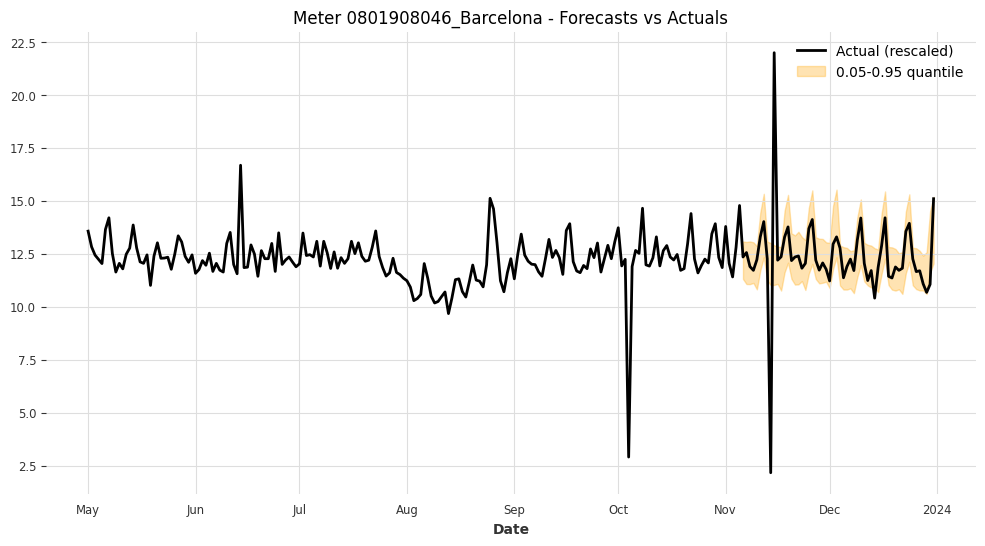

Meter 0801908046_Barcelona - Coverage: 0.9286, Width: 2.2704



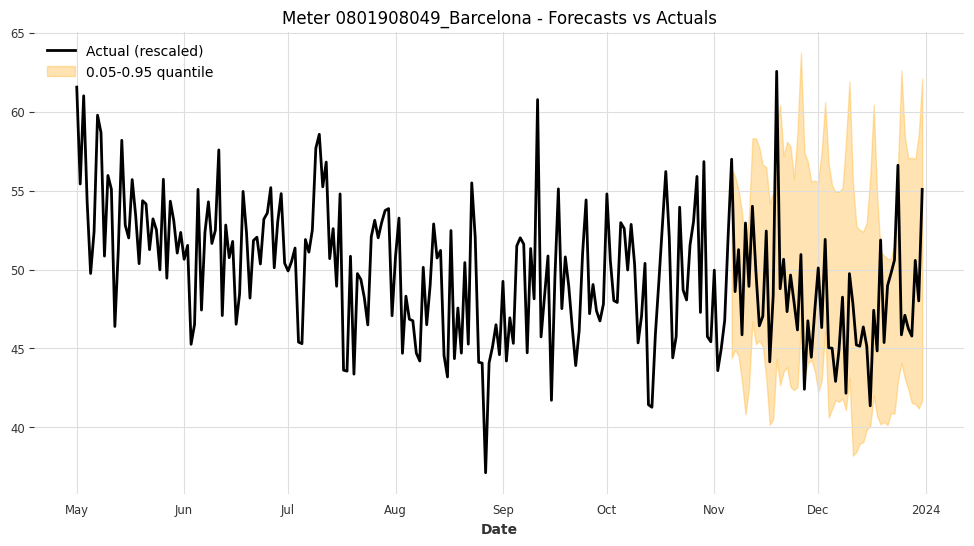

Meter 0801908049_Barcelona - Coverage: 0.8929, Width: 13.9389



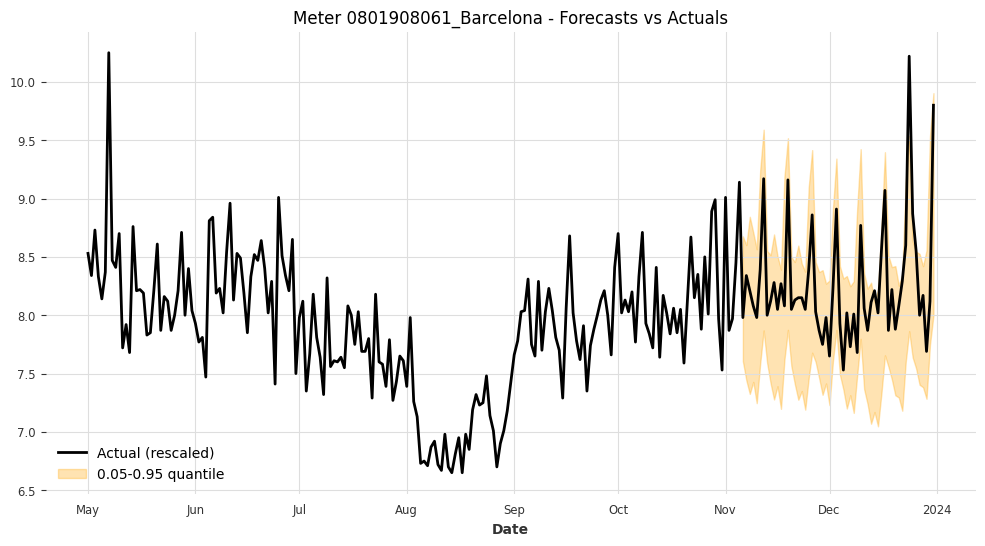

Meter 0801908061_Barcelona - Coverage: 0.9286, Width: 1.2370



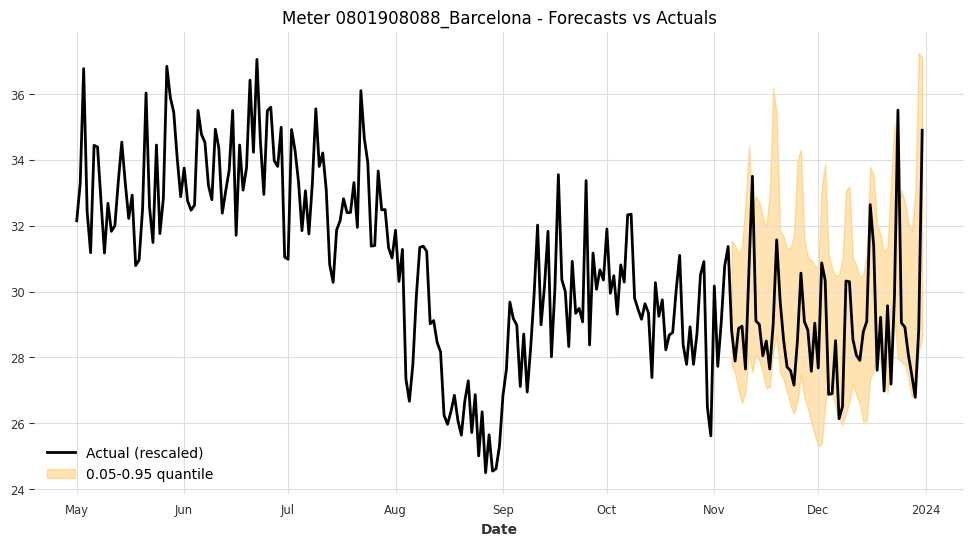

Meter 0801908088_Barcelona - Coverage: 0.8393, Width: 5.2558



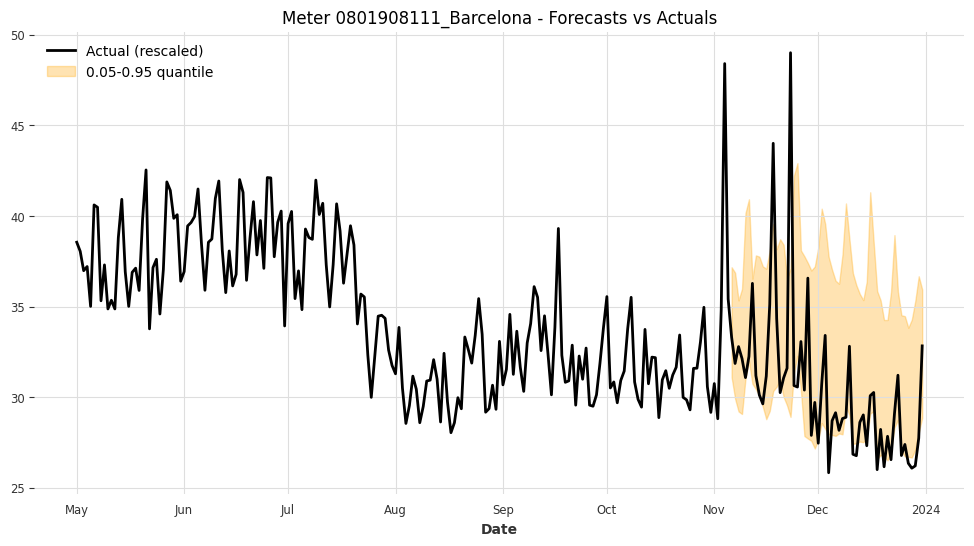

Meter 0801908111_Barcelona - Coverage: 0.6607, Width: 8.6512



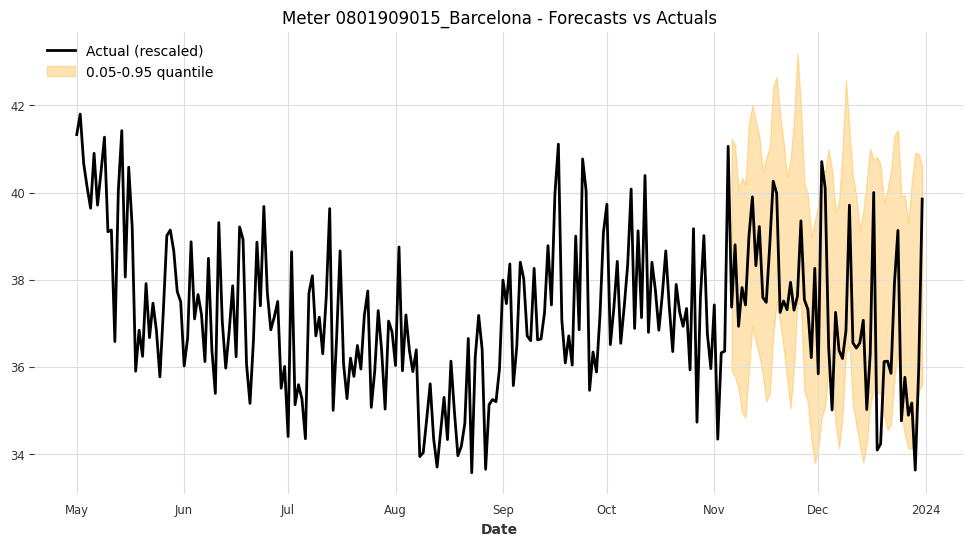

Meter 0801909015_Barcelona - Coverage: 0.8929, Width: 5.3177



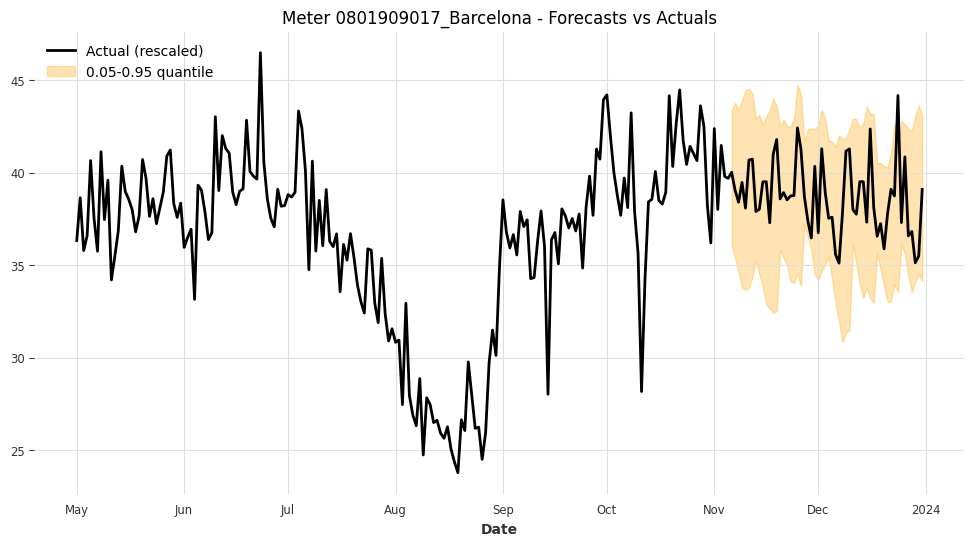

Meter 0801909017_Barcelona - Coverage: 0.9821, Width: 8.5080



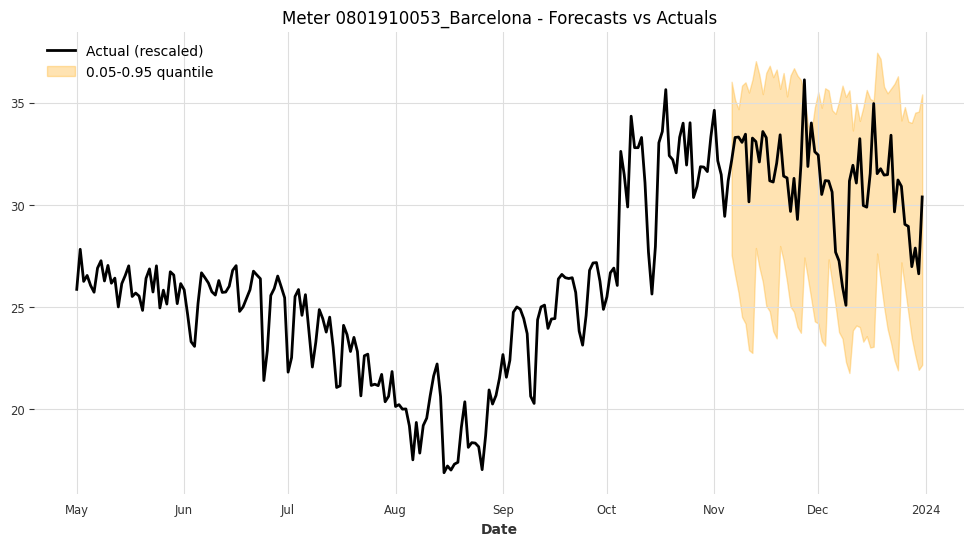

Meter 0801910053_Barcelona - Coverage: 0.9643, Width: 10.8333



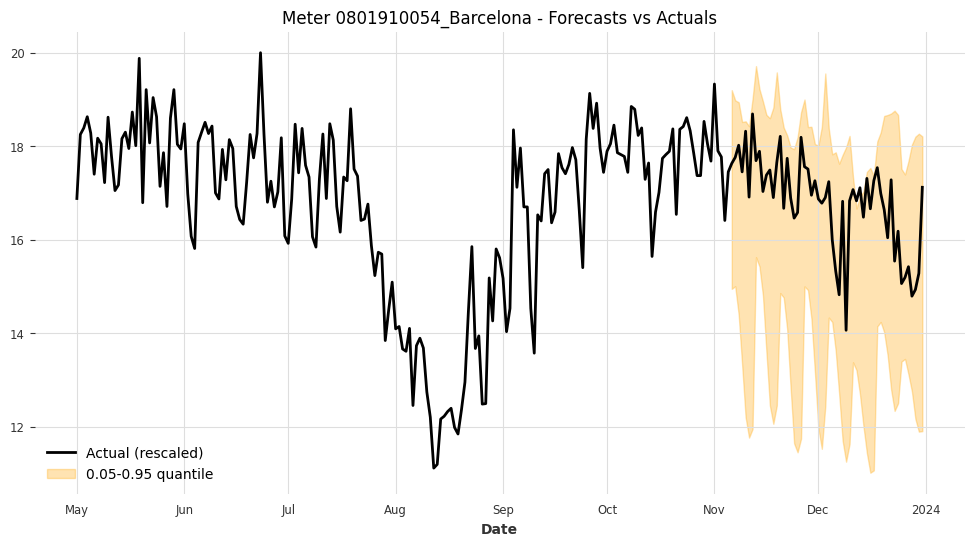

Meter 0801910054_Barcelona - Coverage: 0.9643, Width: 5.2370



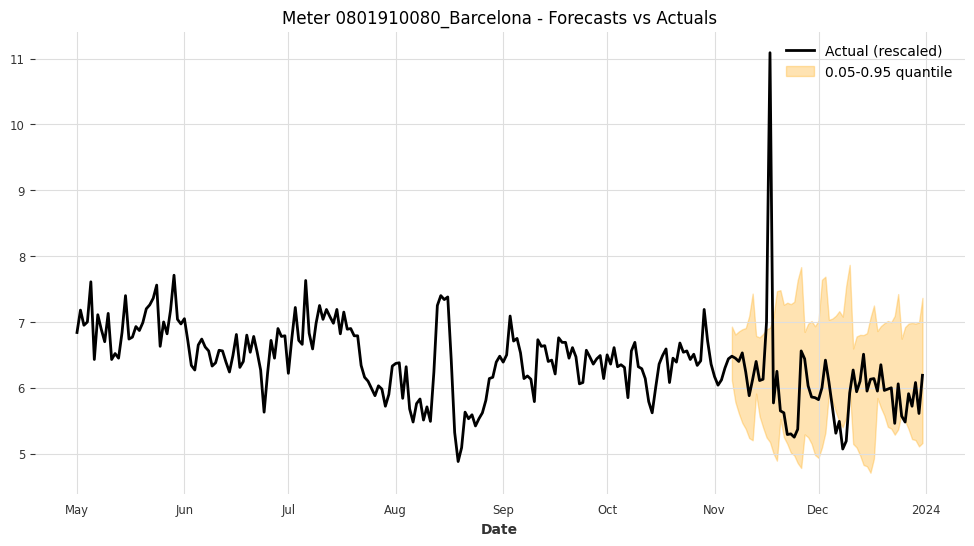

Meter 0801910080_Barcelona - Coverage: 0.8393, Width: 1.7762



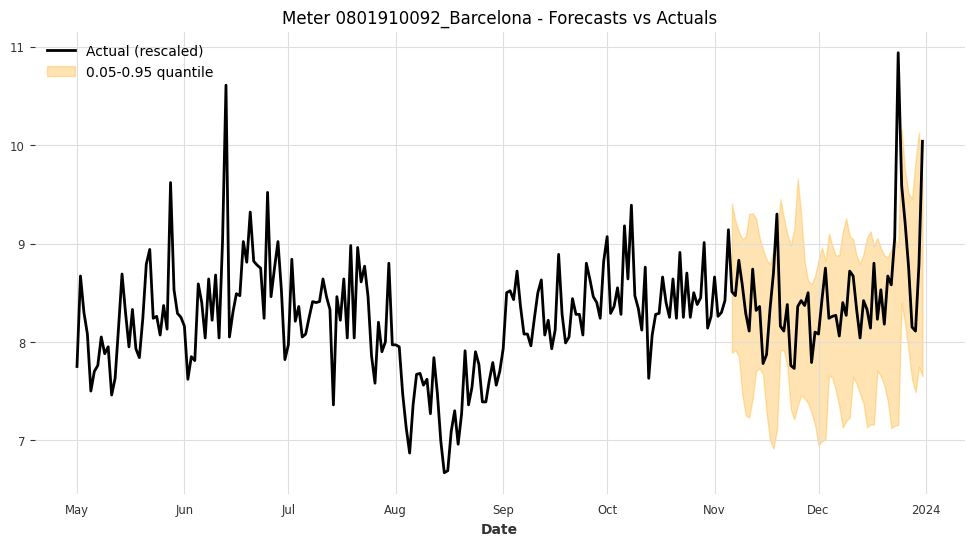

Meter 0801910092_Barcelona - Coverage: 0.9286, Width: 1.6657



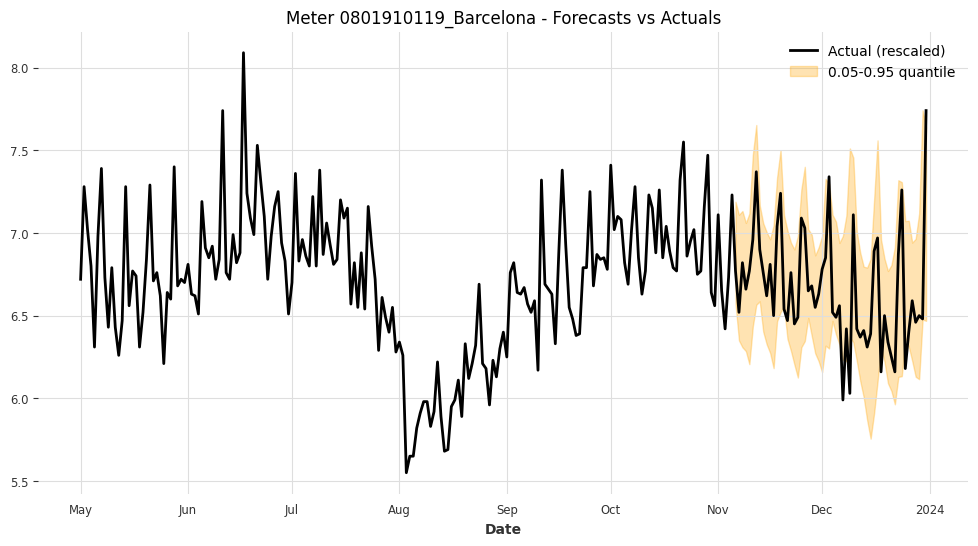

Meter 0801910119_Barcelona - Coverage: 0.8750, Width: 0.8466



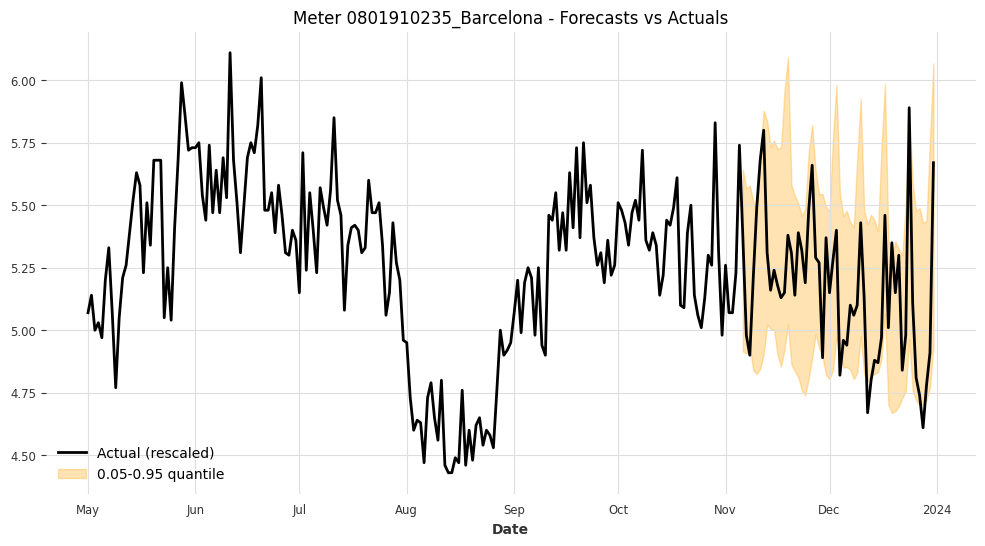

Meter 0801910235_Barcelona - Coverage: 0.8393, Width: 0.7570



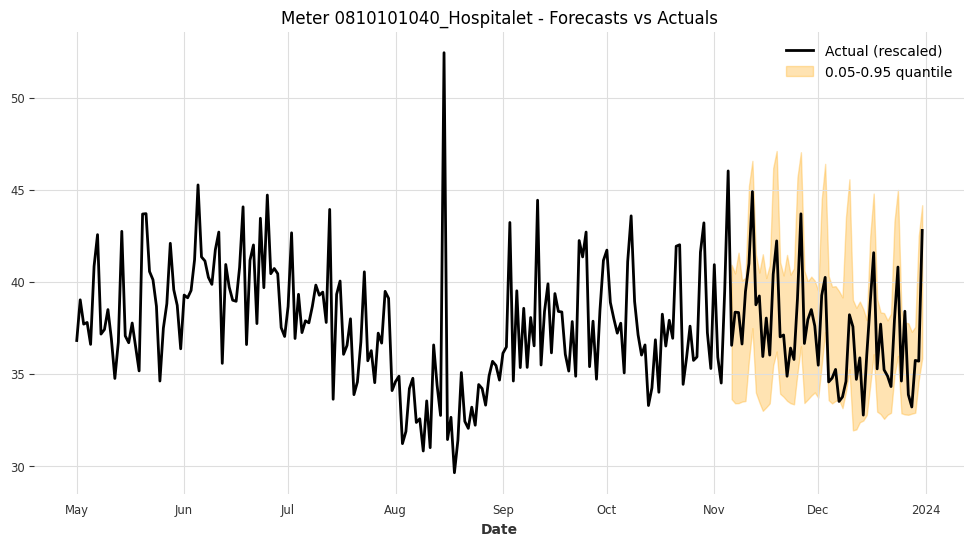

Meter 0810101040_Hospitalet - Coverage: 0.9643, Width: 7.2523



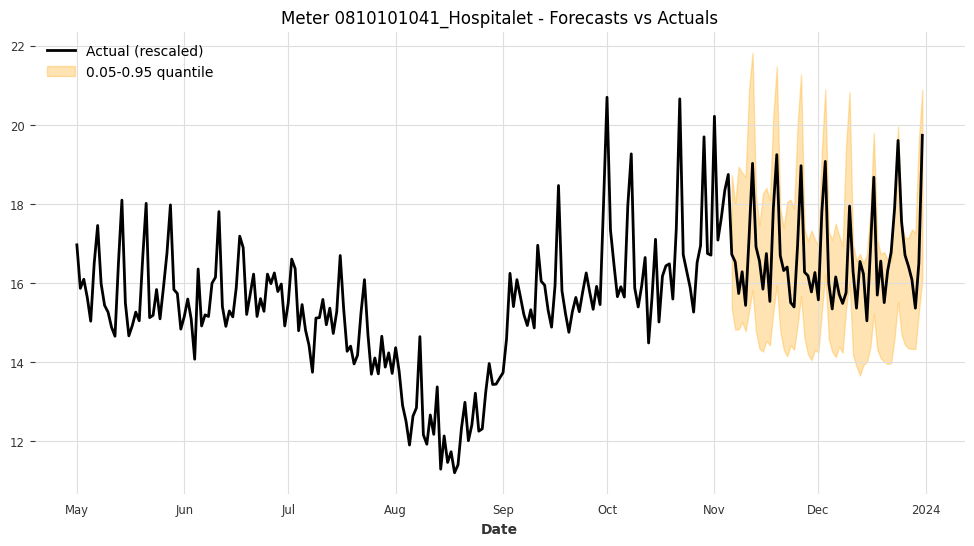

Meter 0810101041_Hospitalet - Coverage: 0.9643, Width: 3.5658



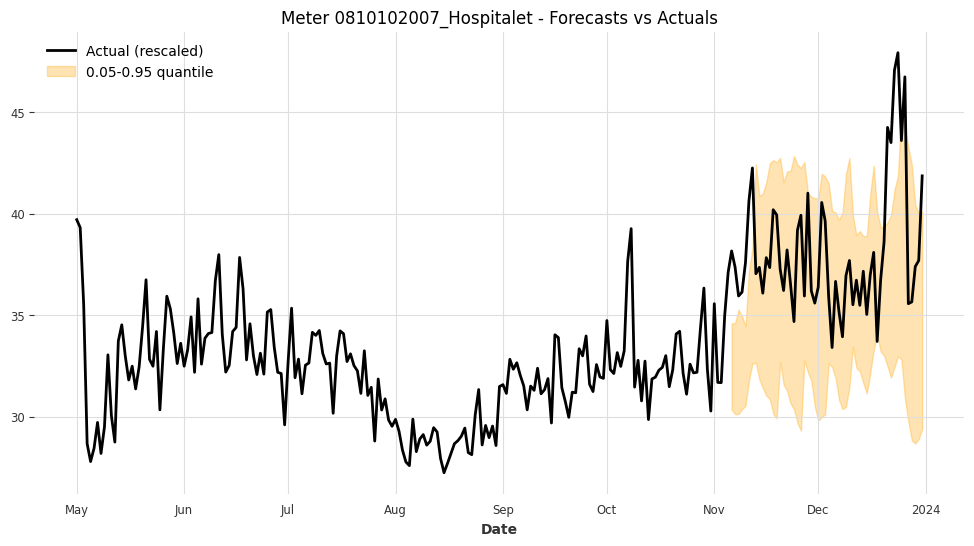

Meter 0810102007_Hospitalet - Coverage: 0.7500, Width: 9.2655



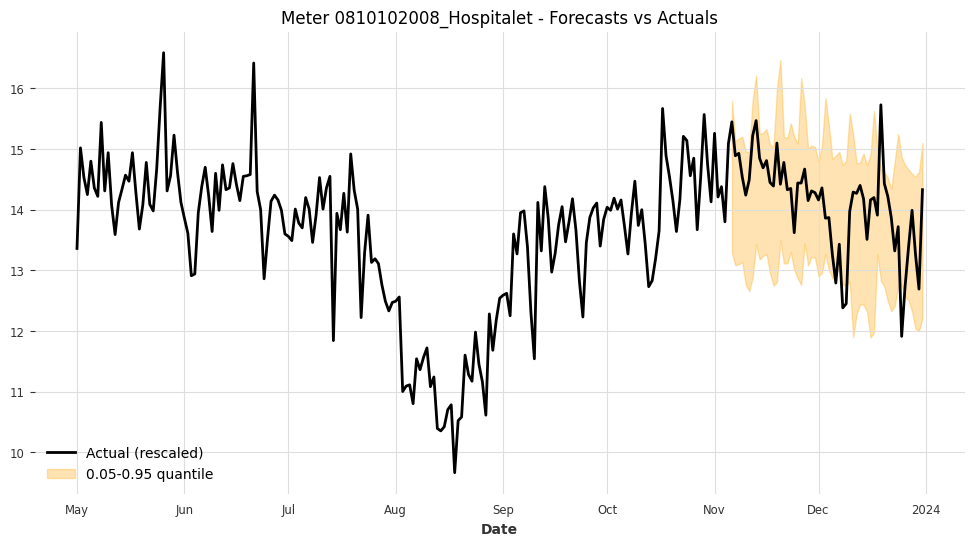

Meter 0810102008_Hospitalet - Coverage: 0.9107, Width: 2.3242



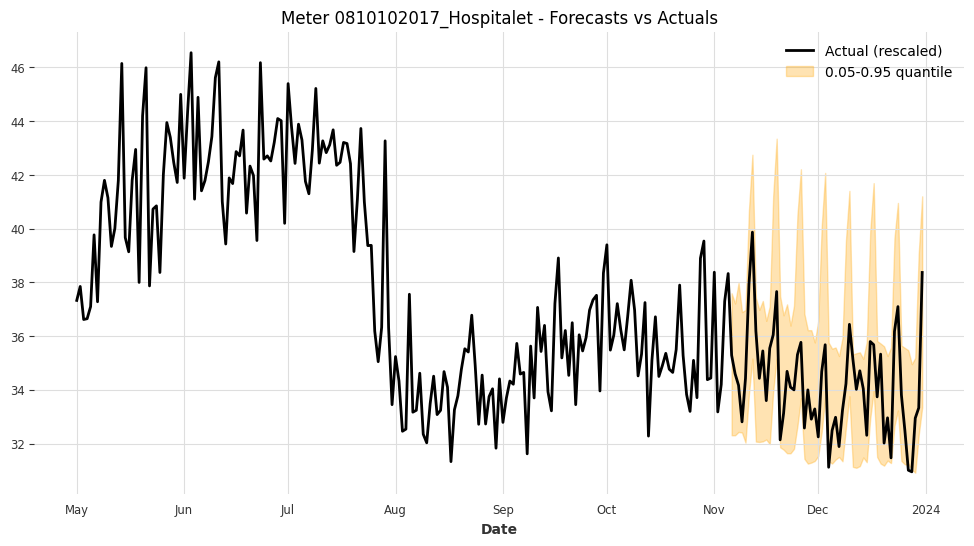

Meter 0810102017_Hospitalet - Coverage: 0.9464, Width: 5.4731



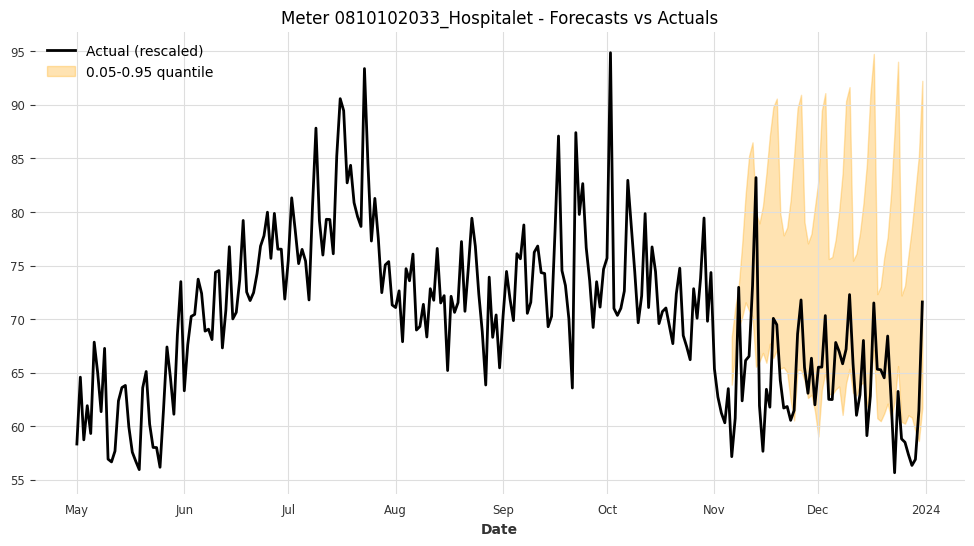

Meter 0810102033_Hospitalet - Coverage: 0.5179, Width: 17.6566



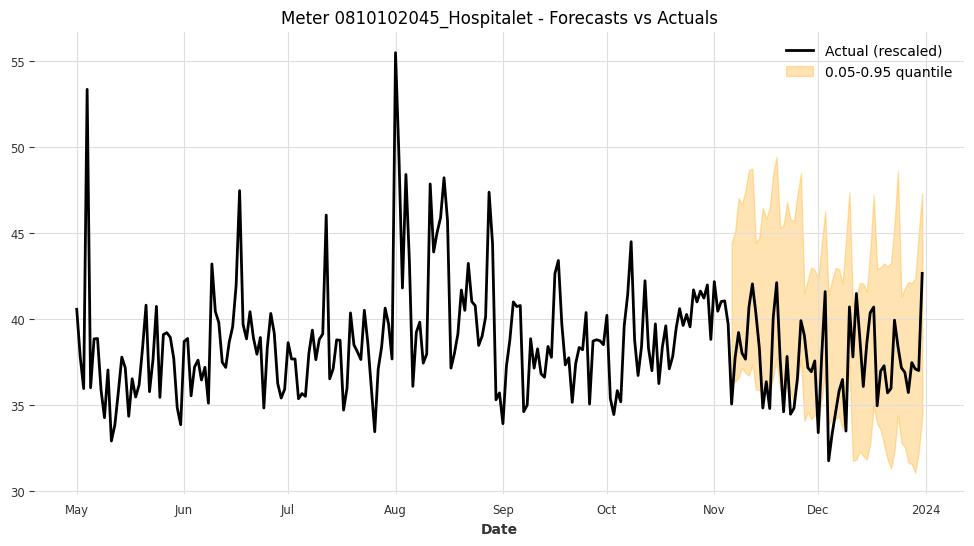

Meter 0810102045_Hospitalet - Coverage: 0.7857, Width: 10.0174



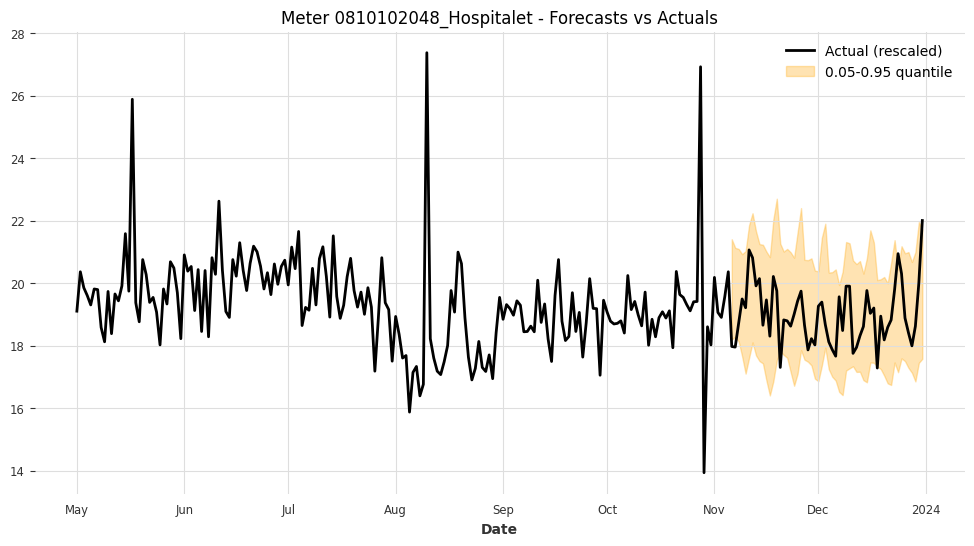

Meter 0810102048_Hospitalet - Coverage: 0.8929, Width: 3.7251



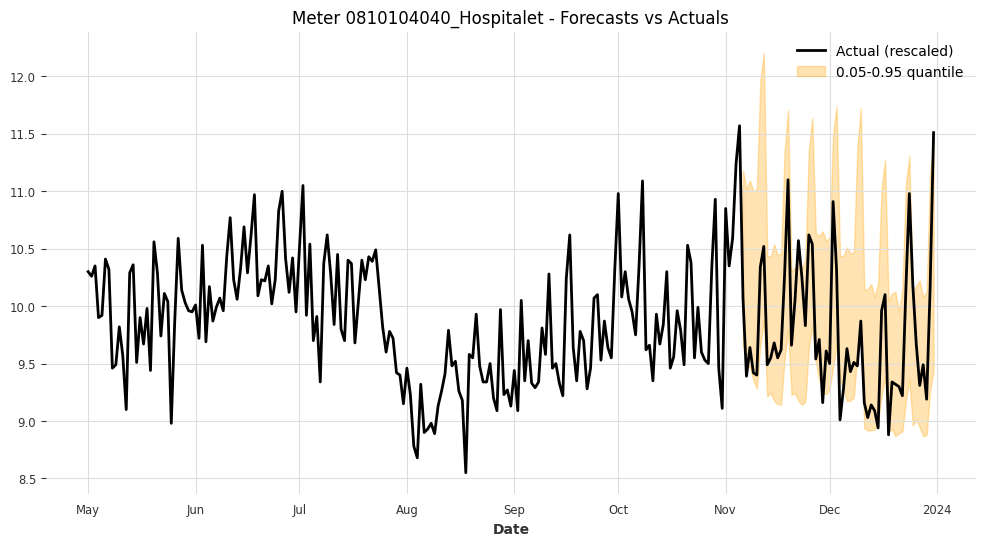

Meter 0810104040_Hospitalet - Coverage: 0.8393, Width: 1.4639



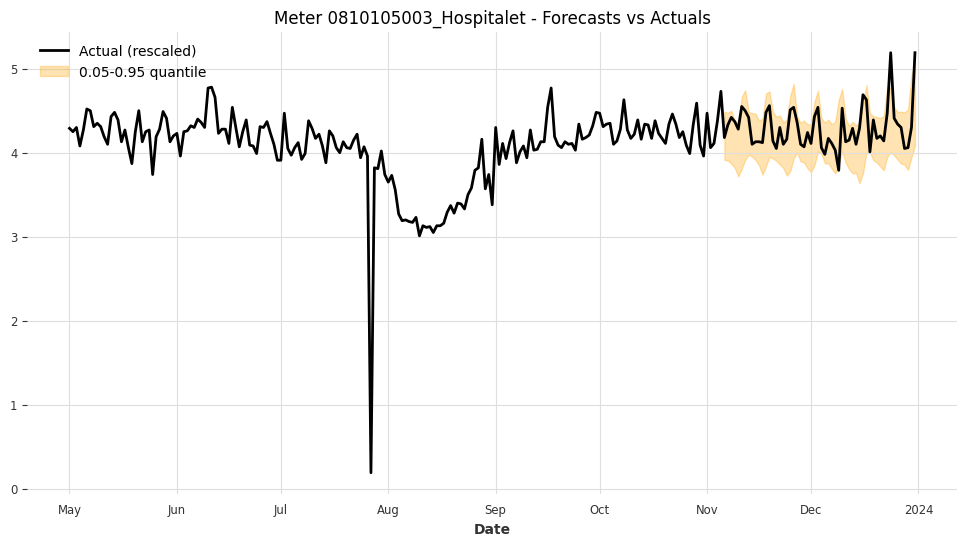

Meter 0810105003_Hospitalet - Coverage: 0.9286, Width: 0.6380



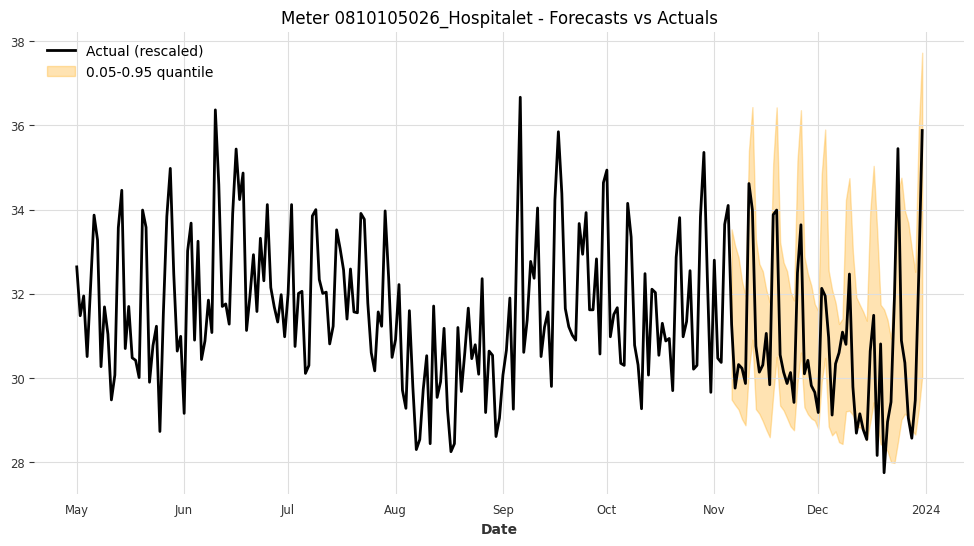

Meter 0810105026_Hospitalet - Coverage: 0.8929, Width: 4.1025



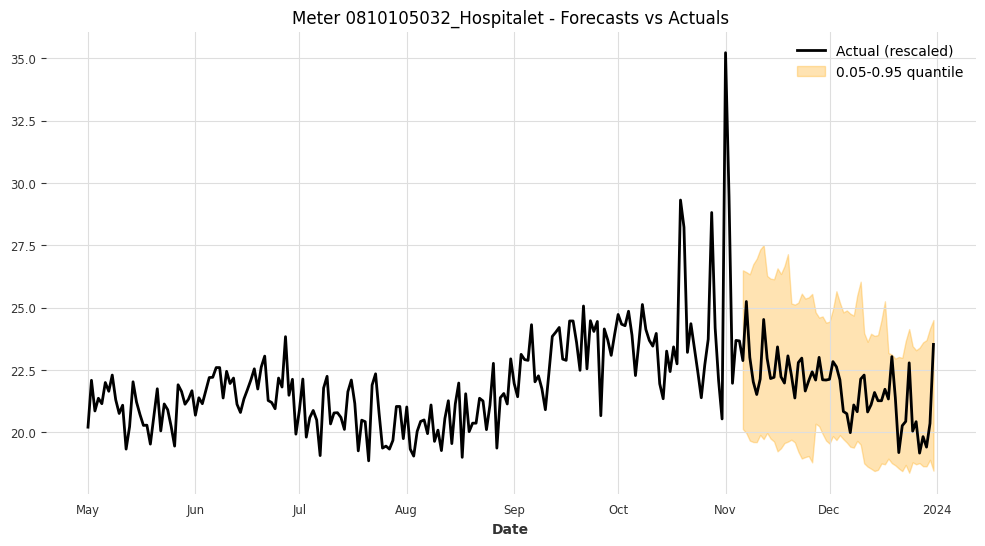

Meter 0810105032_Hospitalet - Coverage: 1.0000, Width: 5.7131



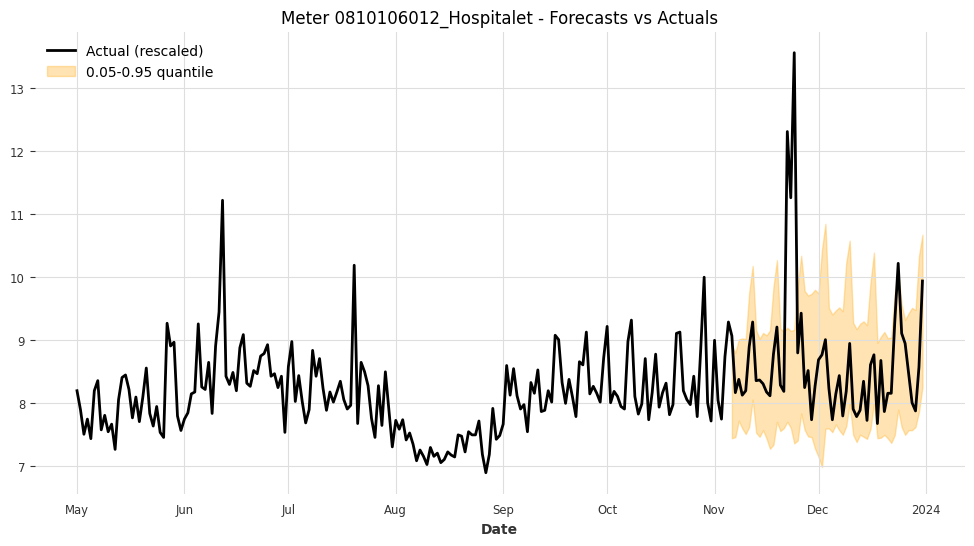

Meter 0810106012_Hospitalet - Coverage: 0.9107, Width: 1.9835



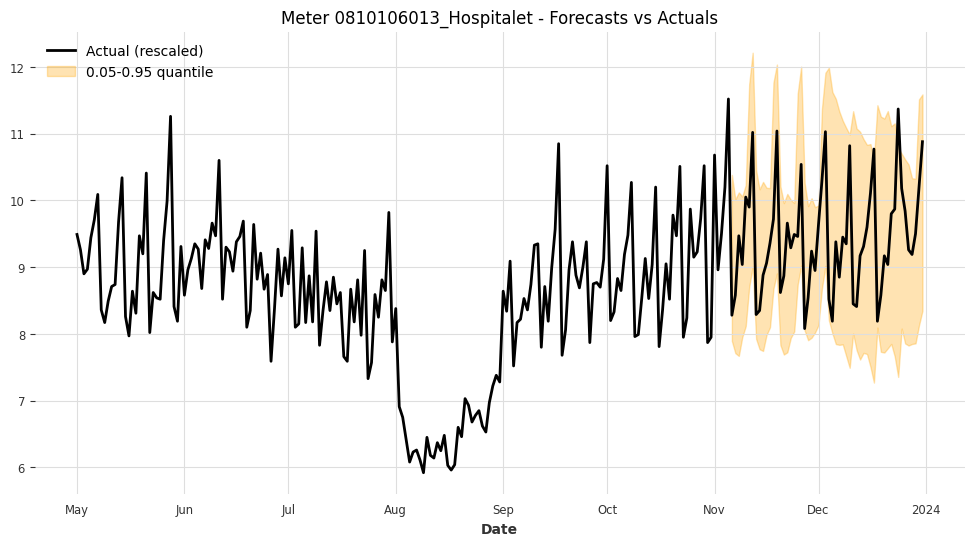

Meter 0810106013_Hospitalet - Coverage: 0.9643, Width: 2.8531



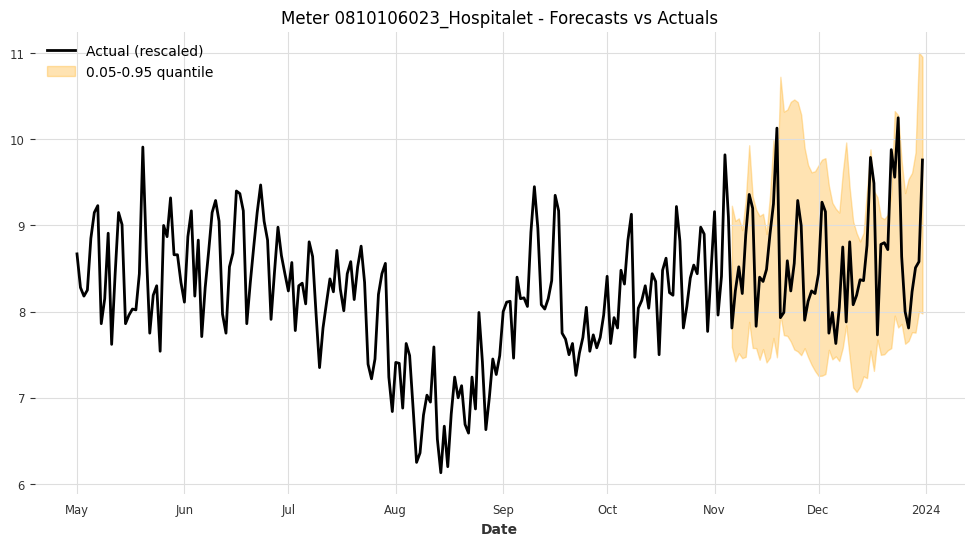

Meter 0810106023_Hospitalet - Coverage: 0.9286, Width: 2.0668



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # Darts utility to merge TimeSeries

for meter_id, hfcs in all_hfcs.items():
    # Get the actual time series
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width = df_result["Width rescaled"].iloc[0]

    # Start a new plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    full_lower = []
    full_upper = []

    # Collect lower and upper quantiles from each forecast window
    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components
            and 'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)


    if full_lower and full_upper:
        # Concatenate all the TimeSeries pieces into full series
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        # Plot the quantile area as a filled region
        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05-0.95 quantile'
        )

    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals")
    ax.legend()
    plt.show()

    # Print the metrics below each plot
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Width: {width:.4f}\n")


In [ ]:
# Let's finish with the specifically selected test

In [ ]:
# Load model
model = TFTModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/TFT/simple/TFT_model.pkl")

In [ ]:
# Load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test_reduced/scaled_test_reduced.pkl')

# Extract components
scaled_val_series = test_data['validation']        # validation not used in our case
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

Loaded 60 time series for testing.


In [ ]:
# Constants
start_date = pd.Timestamp("2023-11-6")
horizon = 7
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}

# Initialize the conformal quantile regression model
cp_model = ConformalQRModel(
    model=model,
    quantiles=quantiles,
    symmetric=False
    # if cal_length is None, it considers all calibration scores
)
q_interval = cp_model.q_interval  # [(0.05, 0.95)]
q_range = cp_model.interval_range  # [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = cp_model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=start_date,
        last_points_only=False,
        stride=7,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    # We evaluate the already-generated historical forecasts
    bt = cp_model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        retrain=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": bt[1], "Width rescaled": mean_width})
    print(f"Results for meter {meter_id}:\n", df_results, "\n")

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 393.99it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801902043_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.217979        2.587406 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 315.22it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903008_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.182366        3.603551 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 393.60it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903021_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.414929        1.701209 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 370.62it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903026_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.347168        2.496141 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 396.38it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.305993         0.85678 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 302.83it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903037_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.370349        2.177653 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 413.86it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801903213_Barcelona:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.928571  0.31529        0.482393 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 398.09it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801904027_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.252698         4.01789 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 407.95it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801904047_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.245092        3.722951 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 304.19it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801904049_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.497206        4.469885 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 369.99it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801905057_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.360506         3.97638 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 311.11it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801906071_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.326183         1.72551 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 311.48it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0801910007_Barcelona:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.857143  0.326173        1.066586 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 383.41it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0807302003_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.195668         6.16941 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 389.38it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0807710008_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.785714  0.169472       70.500283 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 399.65it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101004_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.381893        8.791179 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 312.29it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101011_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.261677         3.92254 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 393.97it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101018_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.277557        1.398889 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 409.04it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101019_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.246912        1.743198 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 403.55it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101024_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  0.441267        3.799307 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 302.00it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101029_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.260142        6.428102 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 269.10it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101033_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.386674        5.919975 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 387.17it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101039_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.298913        4.388044 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 354.86it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.385787         7.71574 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 388.06it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102005_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.345108        3.257816 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 434.22it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102007_Hospitalet:
    Interval  Coverage    Width  Width rescaled
0       0.9      0.75  0.54656        7.668234 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 416.00it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102016_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.318741        4.551615 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 384.09it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102024_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.435933         3.10384 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 425.77it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102034_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  0.229317        6.336027 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 400.73it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102038_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.519695        7.384865 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 395.48it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102039_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.471478        7.147608 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 273.32it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.803571  0.414995        10.28358 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 436.55it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.145807        3.531436 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 409.45it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810102049_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.498966        4.735185 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 304.28it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810103002_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.767006        1.503332 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 315.21it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810103006_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.245471        6.374875 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 413.90it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810103011_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.350119        4.033371 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 424.26it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810103012_Hospitalet:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.946429  0.30923        0.470029 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 395.92it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810103018_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.383857        2.364557 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 368.67it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810103022_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.239184        3.107002 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 417.75it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104007_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.354395        4.210208 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 422.71it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104010_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.946429  0.458266        3.093293 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 432.20it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104011_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.136643        3.744021 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 420.15it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104033_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.324632        3.655353 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 404.28it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104035_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.451807        1.048192 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 401.66it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.964286  0.404992        1.818415 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 289.47it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105001_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.839286  0.269502        0.878576 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 434.59it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105007_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.982143  0.321358        6.022252 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 420.58it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810105018_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.377344        2.630085 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 278.69it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106005_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.126828        1.202331 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 296.00it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106008_Hospitalet:
    Interval  Coverage    Width  Width rescaled
0       0.9  0.892857  0.32242        1.763638 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 379.58it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106010_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.274007        1.383738 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 370.47it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106014_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.412294        1.632683 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 393.82it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106016_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.892857  0.220779        0.865453 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 312.10it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106019_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.910714  0.324948        1.384278 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 378.61it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106021_Hospitalet:
    Interval  Coverage  Width  Width rescaled
0       0.9  0.964286   0.17        2.036601 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 392.29it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106022_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.307038        0.936466 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 395.01it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9  0.928571  0.349794        2.091766 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 346.75it/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Results for meter 0810106026_Hospitalet:
    Interval  Coverage   Width  Width rescaled
0       0.9  0.910714  0.1616        0.554289 



Predicting: |          | 0/? [00:00<?, ?it/s]

conformal forecasts: 100%|██████████| 8/8 [00:00<00:00, 385.98it/s]

Results for meter 0810106032_Hospitalet:
    Interval  Coverage     Width  Width rescaled
0       0.9     0.875  0.327209        1.842187 



In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()
mean_width_rescaled = combined_results["Width rescaled"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")
print(f"Mean Width rescaled: {mean_width_rescaled:.4f}")

Mean Coverage: 0.9107
Mean Width: 0.3298
Mean Width rescaled: 4.5385


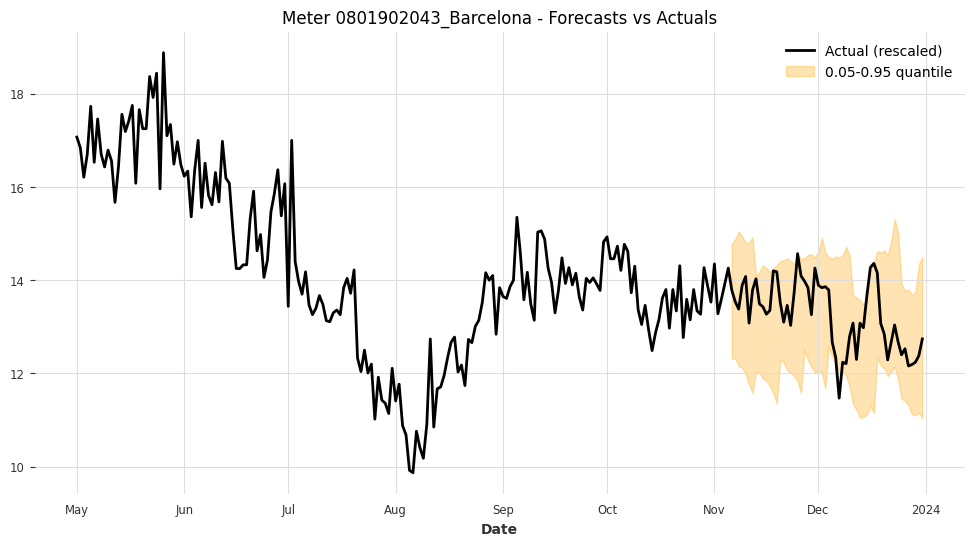

Meter 0801902043_Barcelona - Coverage: 0.9464, Width: 2.5874



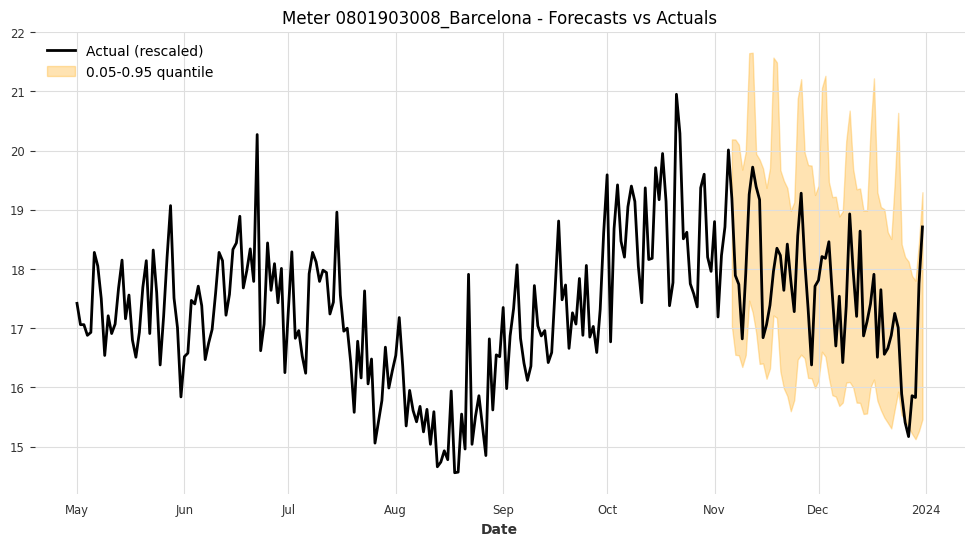

Meter 0801903008_Barcelona - Coverage: 0.9643, Width: 3.6036



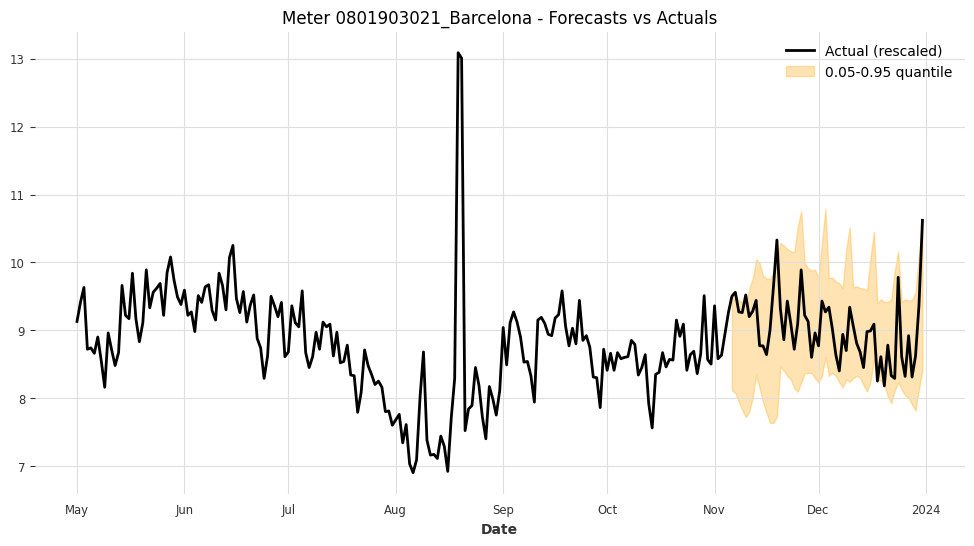

Meter 0801903021_Barcelona - Coverage: 0.8929, Width: 1.7012



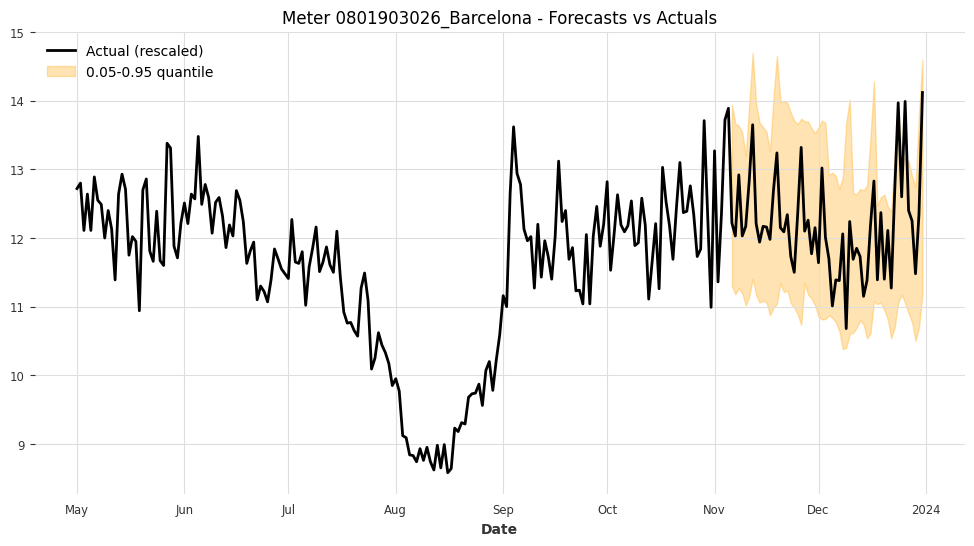

Meter 0801903026_Barcelona - Coverage: 0.9643, Width: 2.4961



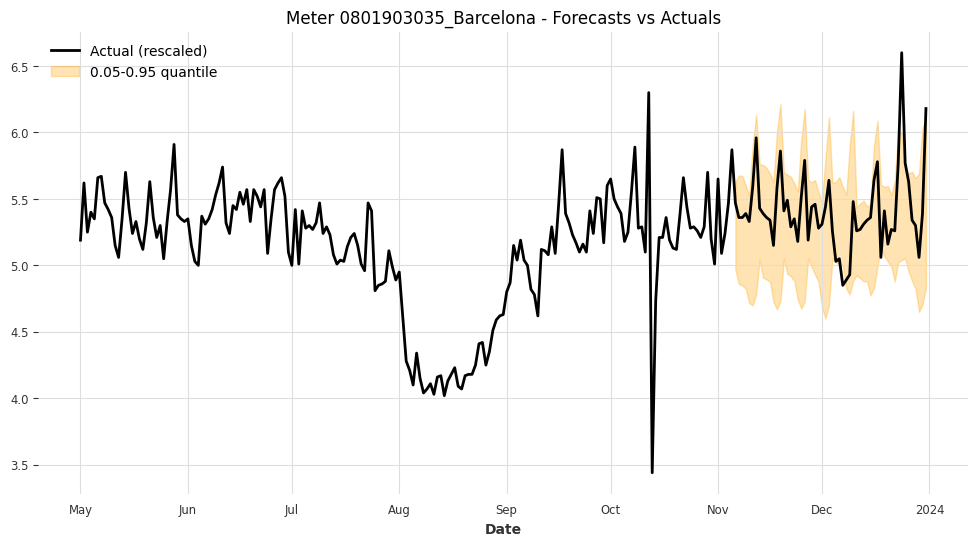

Meter 0801903035_Barcelona - Coverage: 0.9107, Width: 0.8568



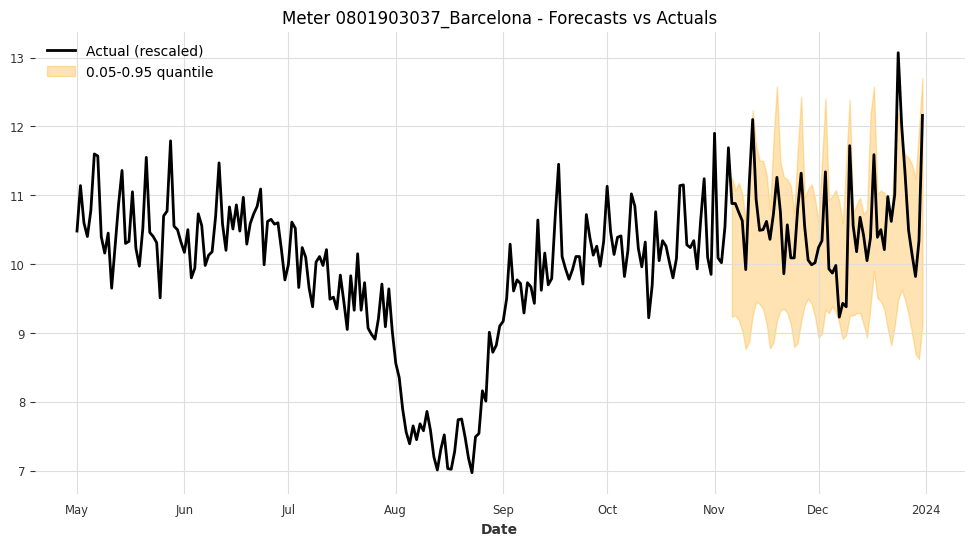

Meter 0801903037_Barcelona - Coverage: 0.9464, Width: 2.1777



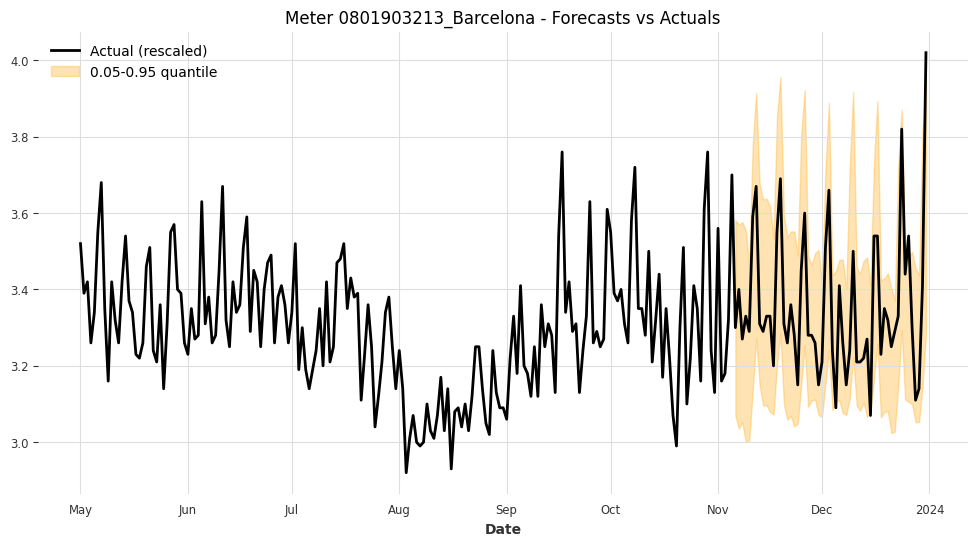

Meter 0801903213_Barcelona - Coverage: 0.9286, Width: 0.4824



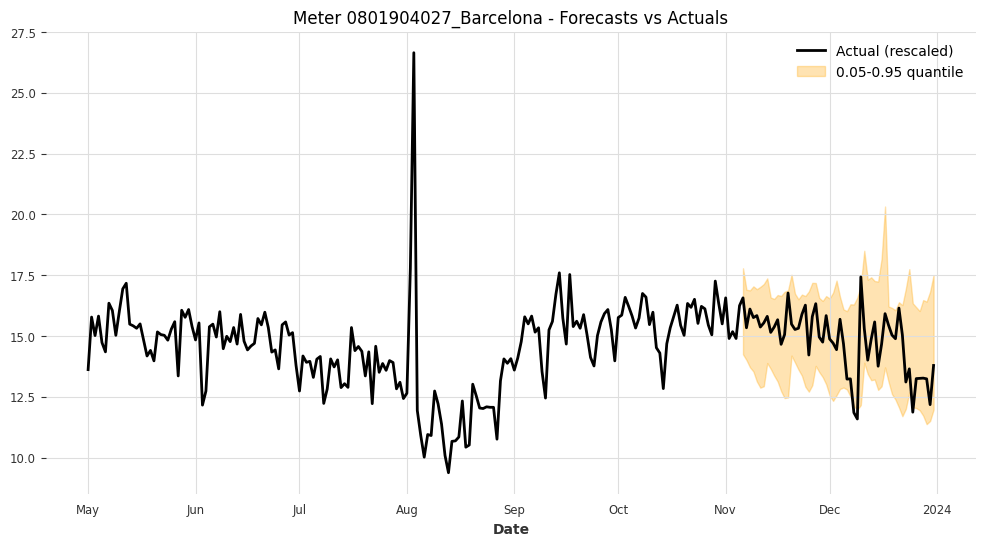

Meter 0801904027_Barcelona - Coverage: 0.9286, Width: 4.0179



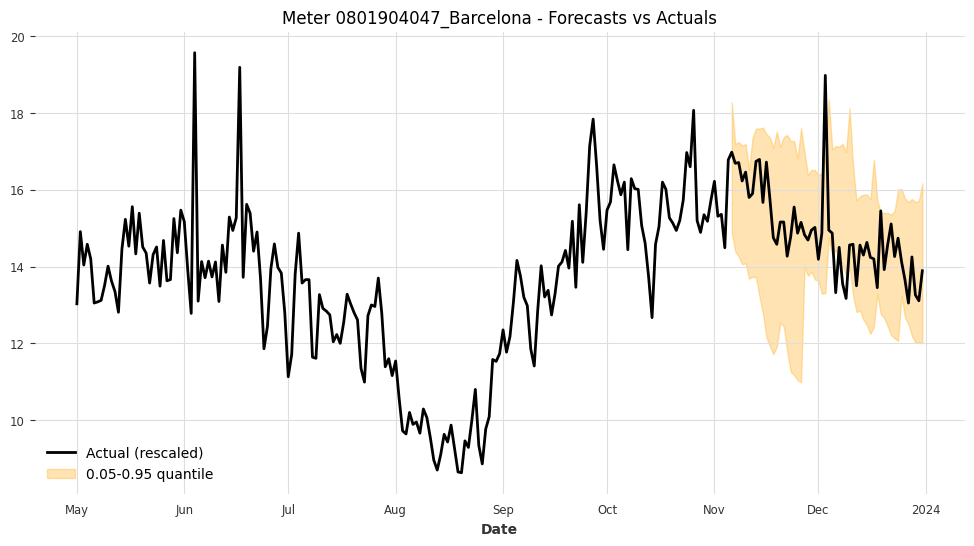

Meter 0801904047_Barcelona - Coverage: 0.9107, Width: 3.7230



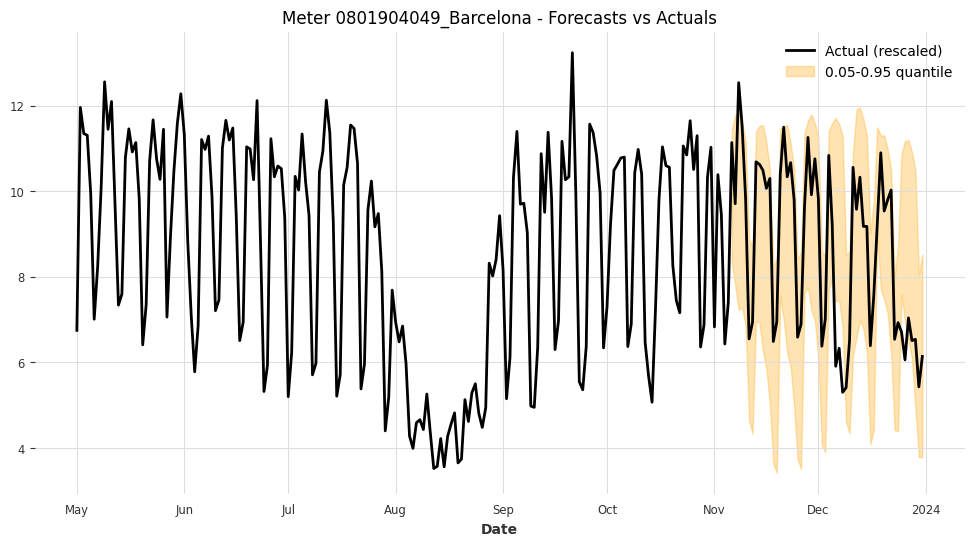

Meter 0801904049_Barcelona - Coverage: 0.8750, Width: 4.4699



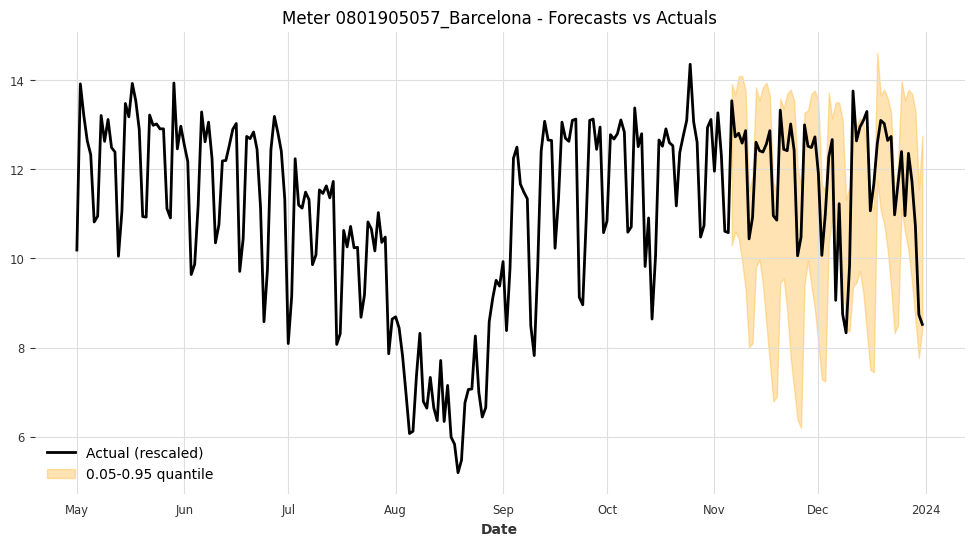

Meter 0801905057_Barcelona - Coverage: 0.8750, Width: 3.9764



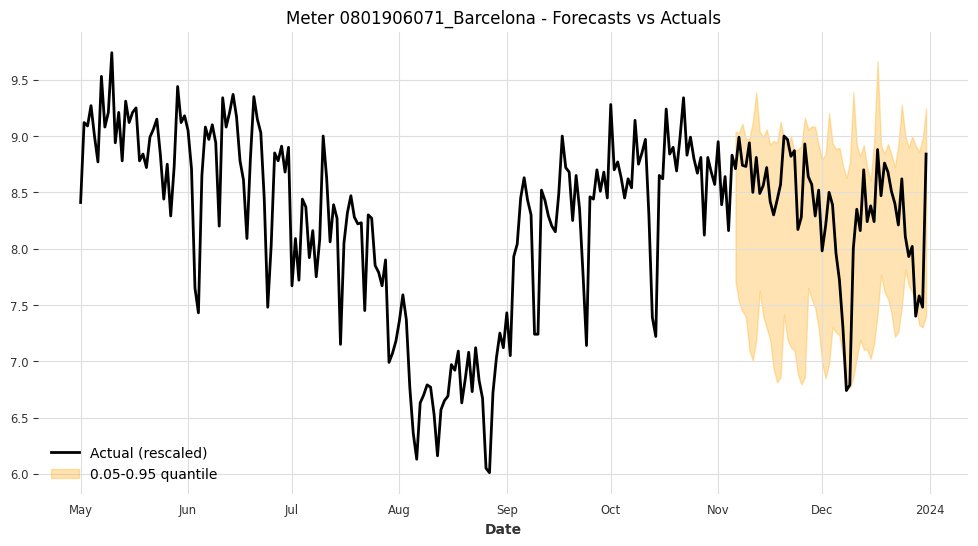

Meter 0801906071_Barcelona - Coverage: 0.9107, Width: 1.7255



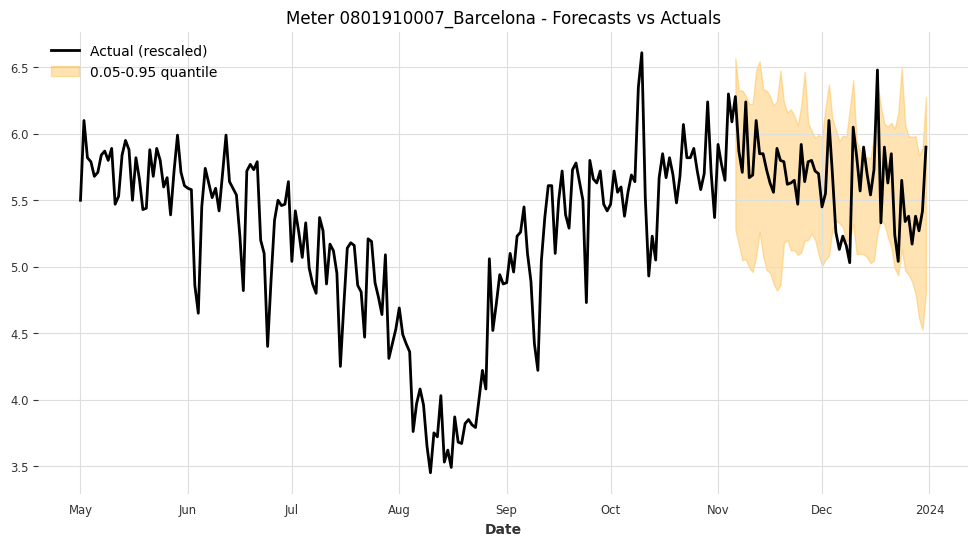

Meter 0801910007_Barcelona - Coverage: 0.8571, Width: 1.0666



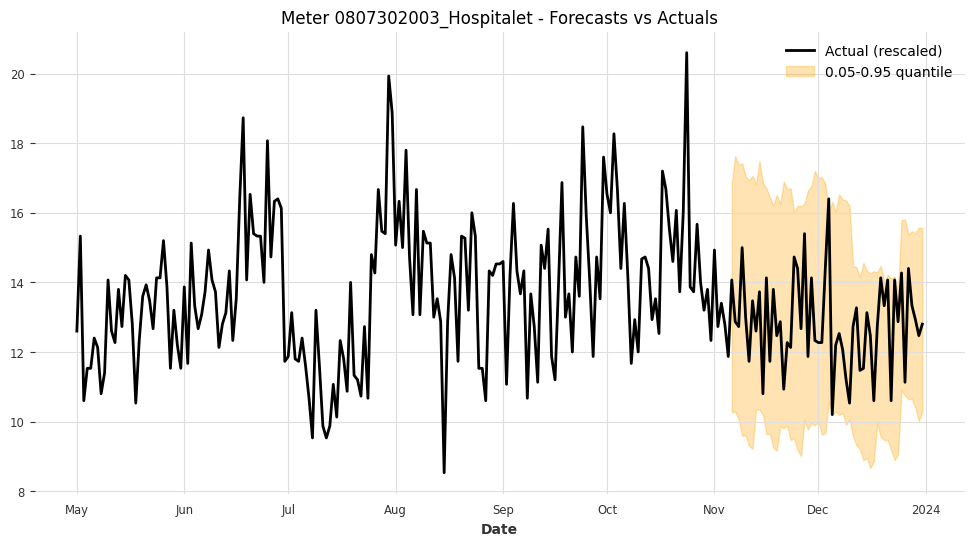

Meter 0807302003_Hospitalet - Coverage: 0.9821, Width: 6.1694



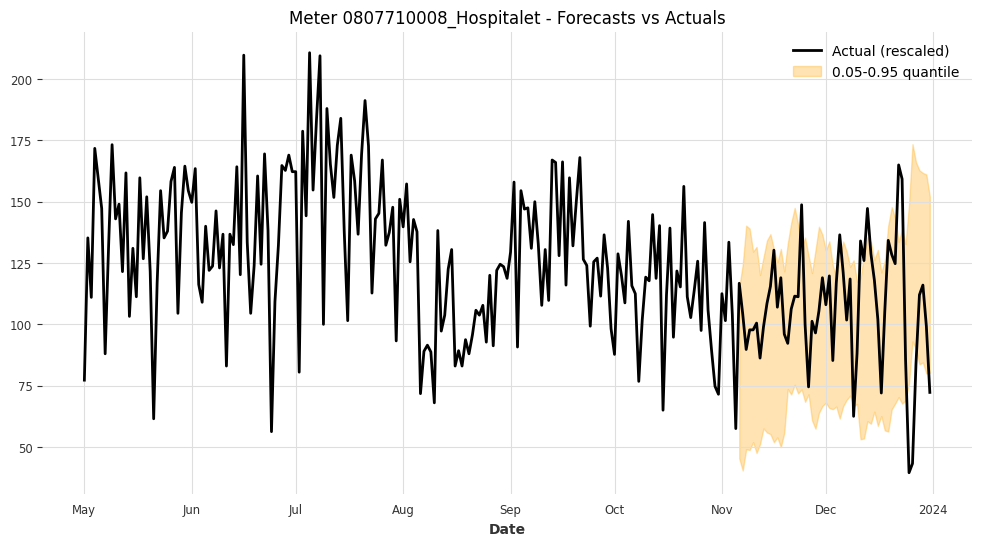

Meter 0807710008_Hospitalet - Coverage: 0.7857, Width: 70.5003



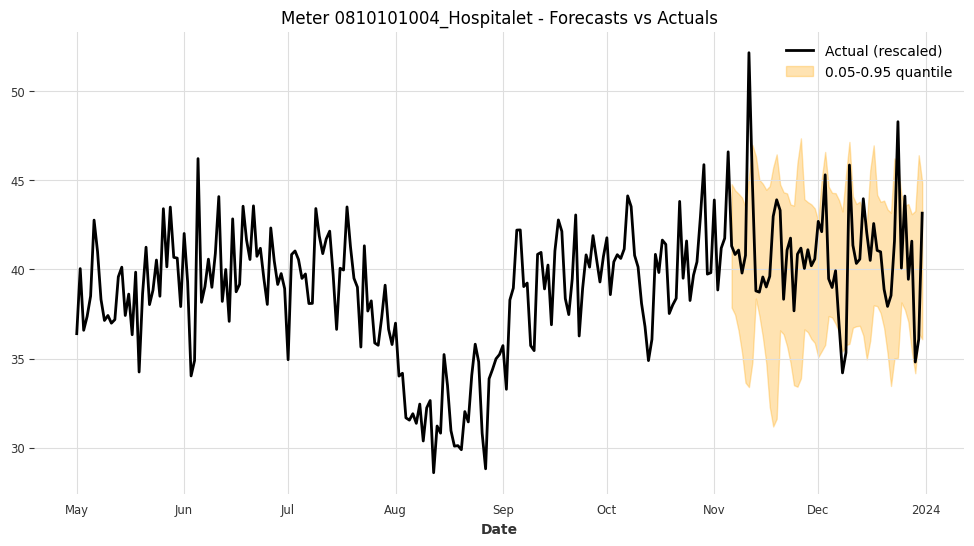

Meter 0810101004_Hospitalet - Coverage: 0.8750, Width: 8.7912



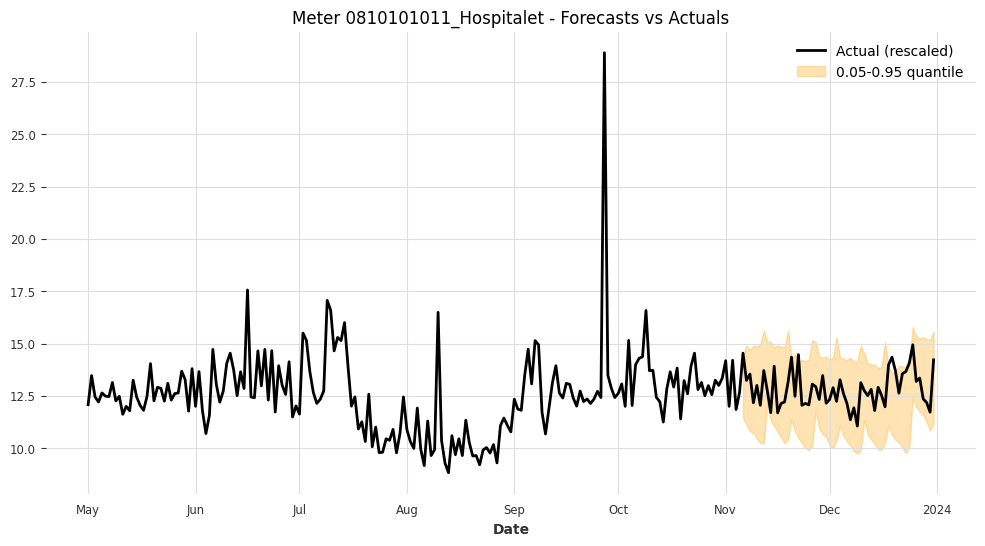

Meter 0810101011_Hospitalet - Coverage: 0.9107, Width: 3.9225



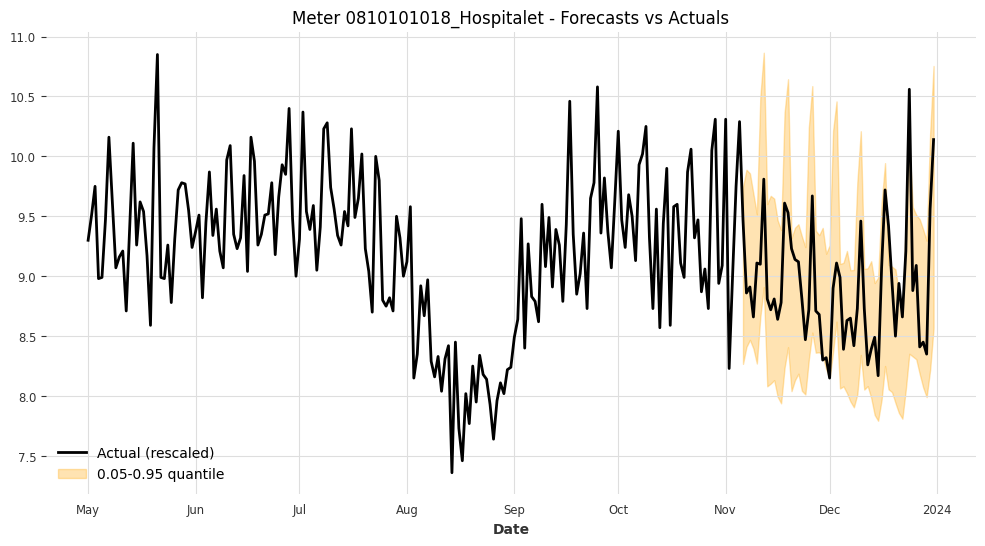

Meter 0810101018_Hospitalet - Coverage: 0.9286, Width: 1.3989



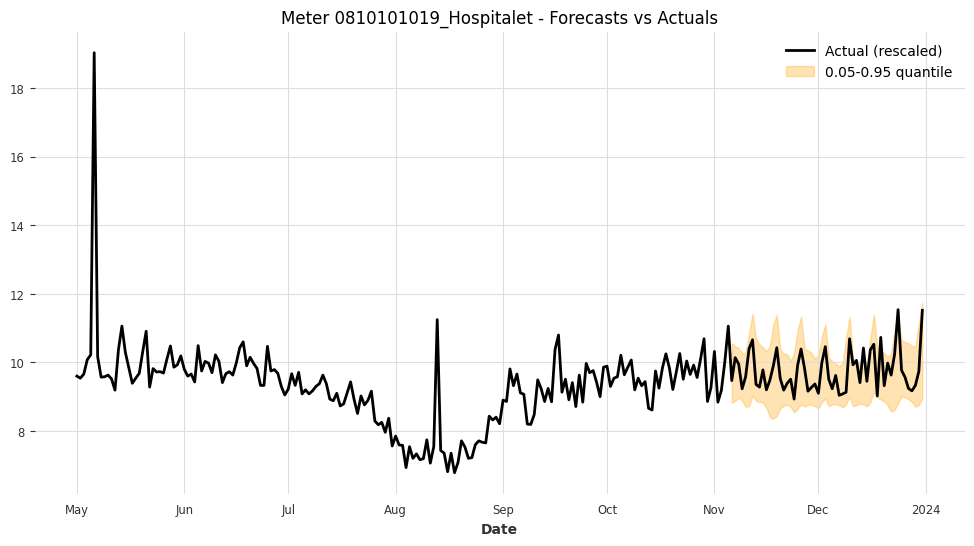

Meter 0810101019_Hospitalet - Coverage: 0.9286, Width: 1.7432



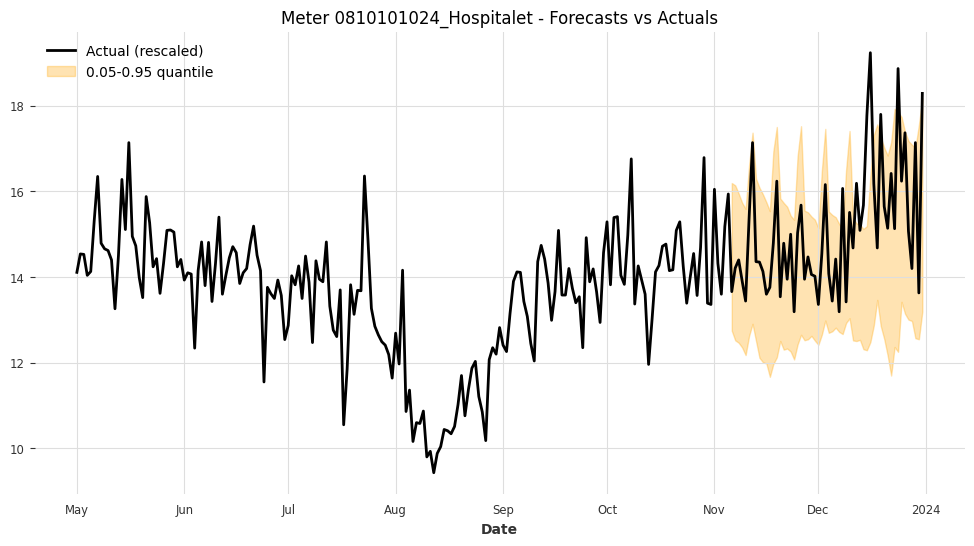

Meter 0810101024_Hospitalet - Coverage: 0.8393, Width: 3.7993



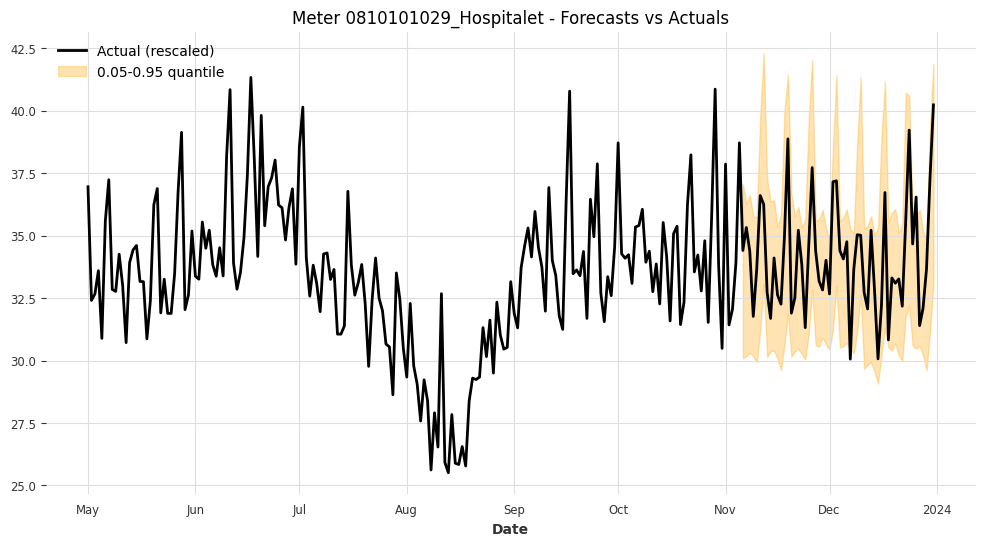

Meter 0810101029_Hospitalet - Coverage: 0.9643, Width: 6.4281



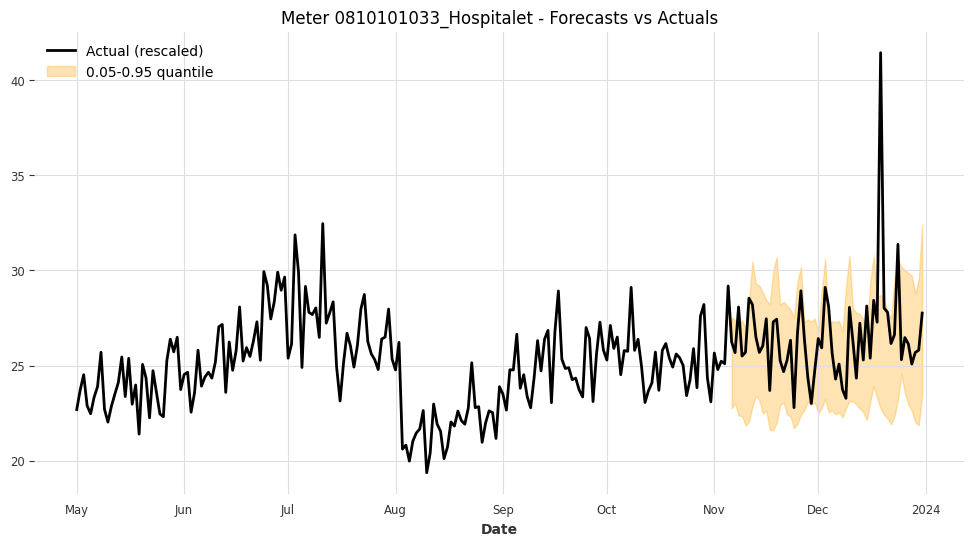

Meter 0810101033_Hospitalet - Coverage: 0.8929, Width: 5.9200



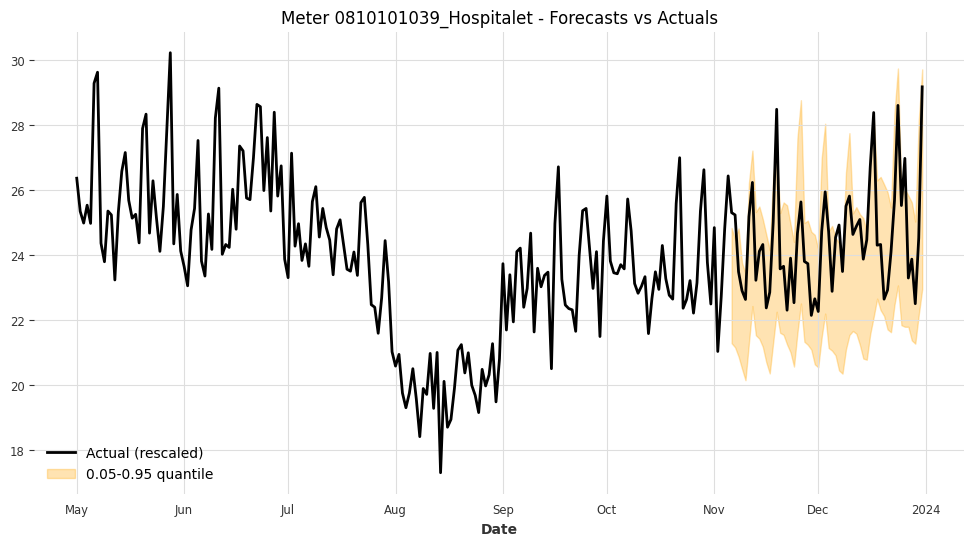

Meter 0810101039_Hospitalet - Coverage: 0.8750, Width: 4.3880



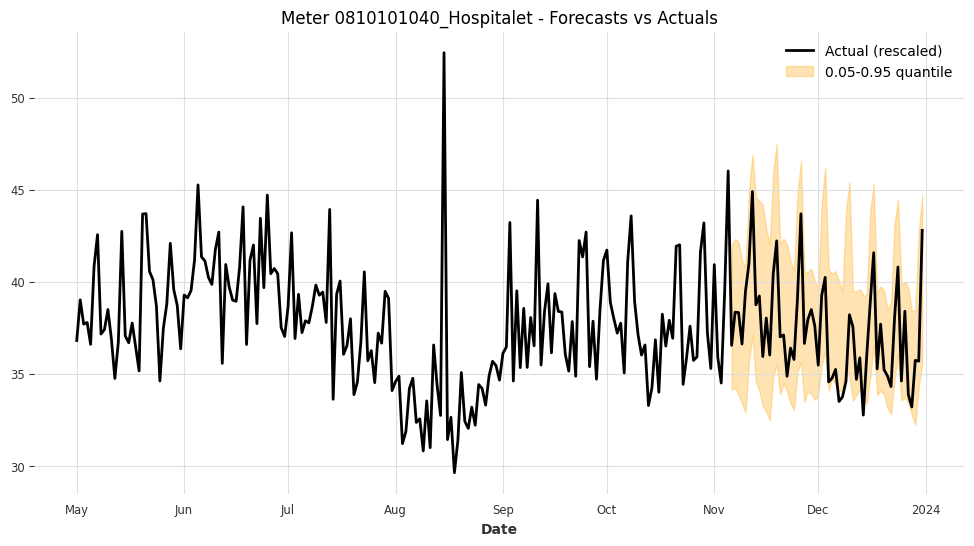

Meter 0810101040_Hospitalet - Coverage: 0.9286, Width: 7.7157



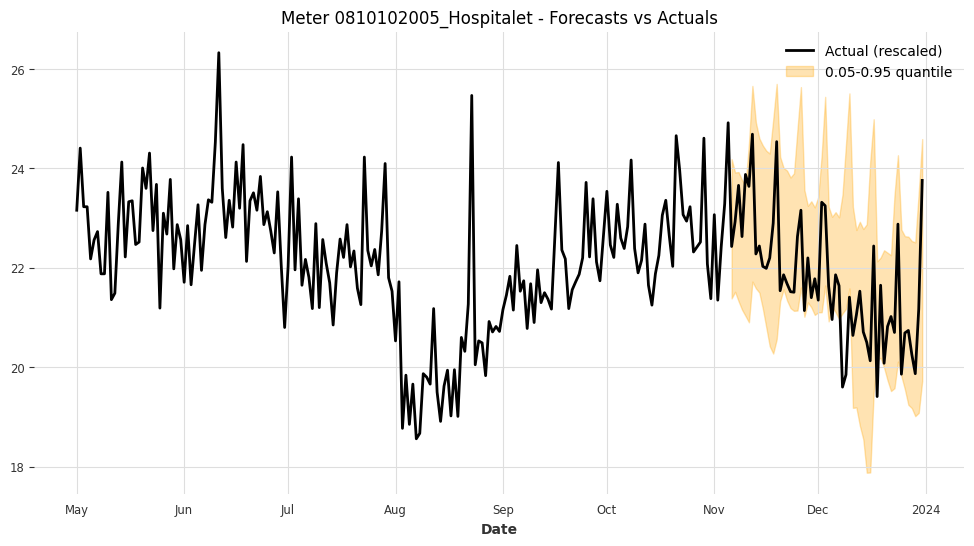

Meter 0810102005_Hospitalet - Coverage: 0.8929, Width: 3.2578



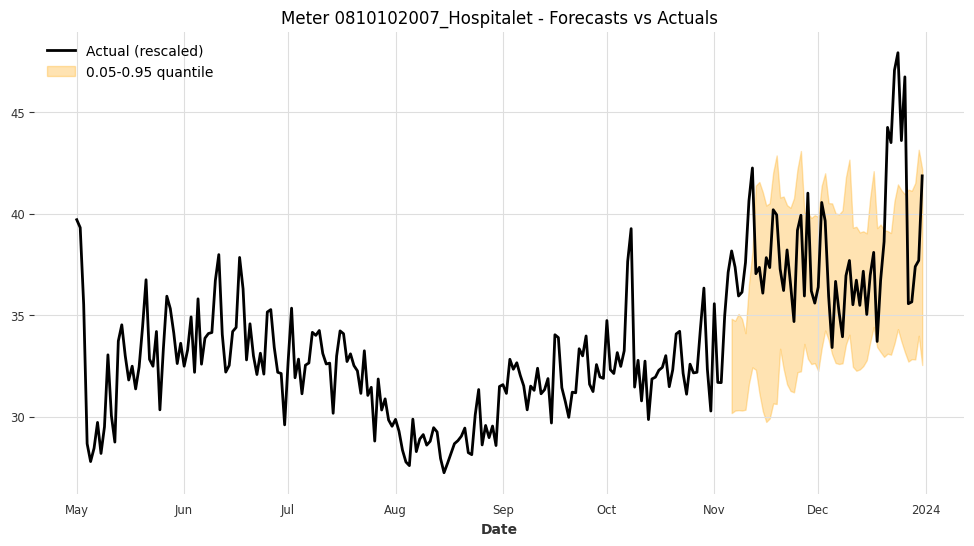

Meter 0810102007_Hospitalet - Coverage: 0.7500, Width: 7.6682



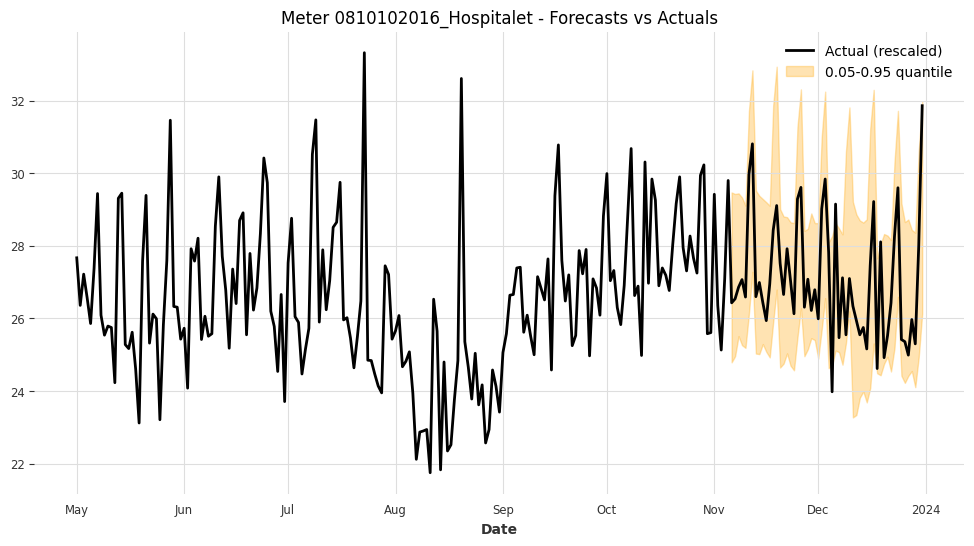

Meter 0810102016_Hospitalet - Coverage: 0.9464, Width: 4.5516



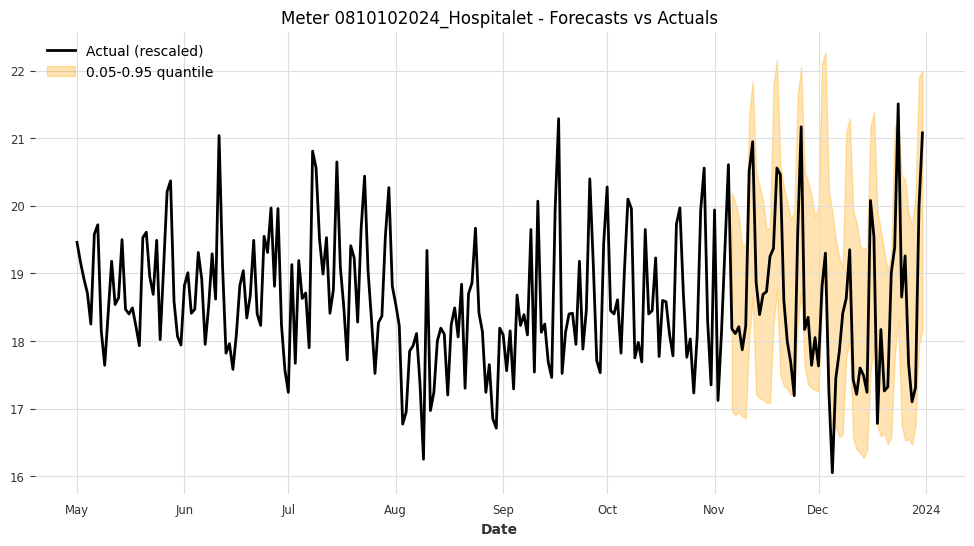

Meter 0810102024_Hospitalet - Coverage: 0.9464, Width: 3.1038



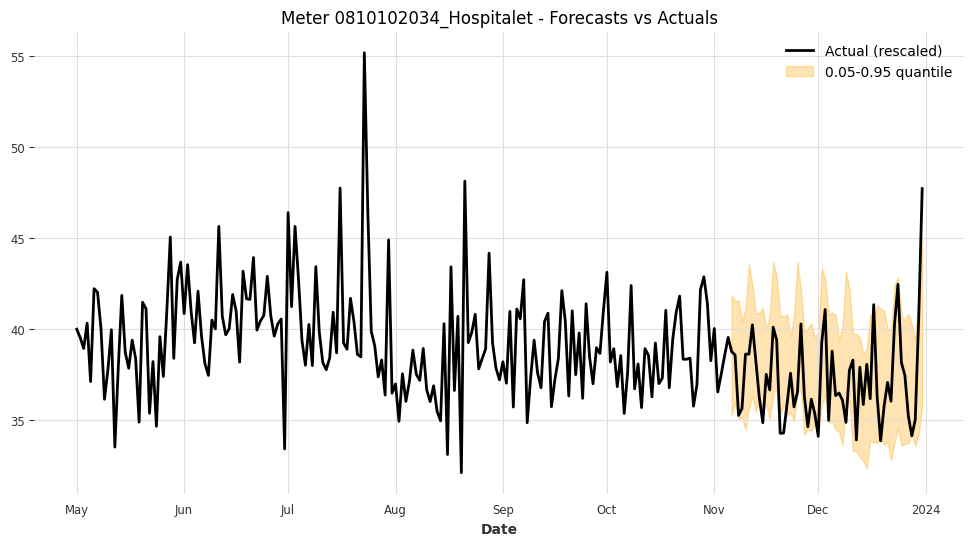

Meter 0810102034_Hospitalet - Coverage: 0.8393, Width: 6.3360



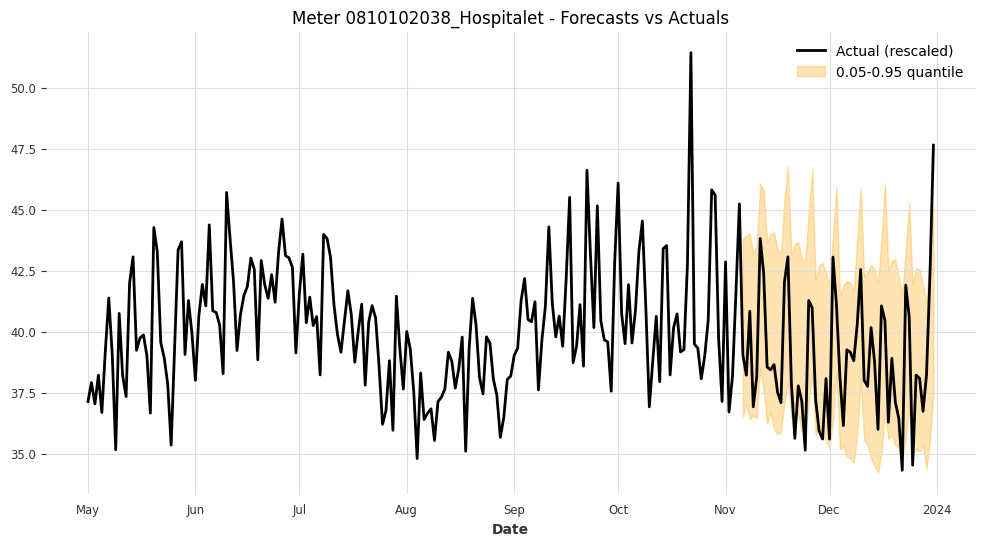

Meter 0810102038_Hospitalet - Coverage: 0.8750, Width: 7.3849



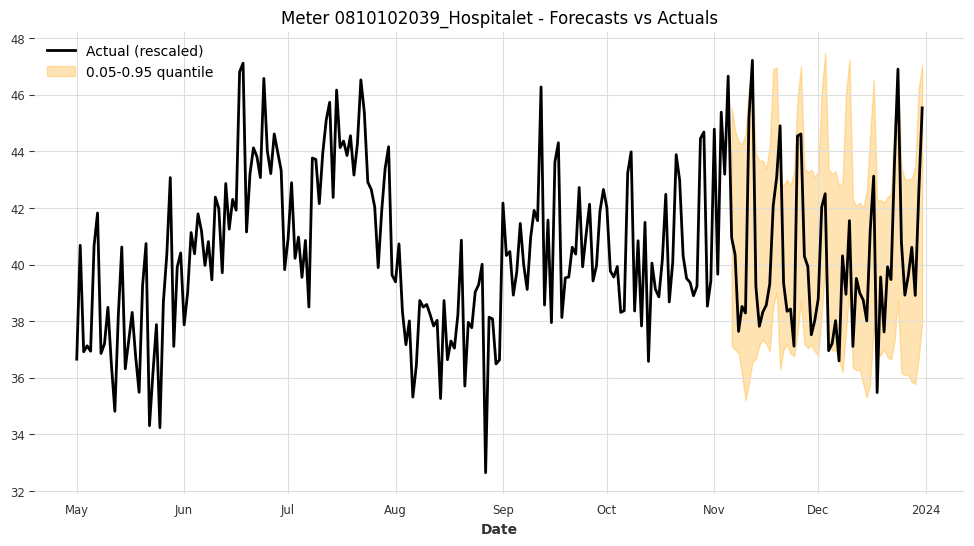

Meter 0810102039_Hospitalet - Coverage: 0.9107, Width: 7.1476



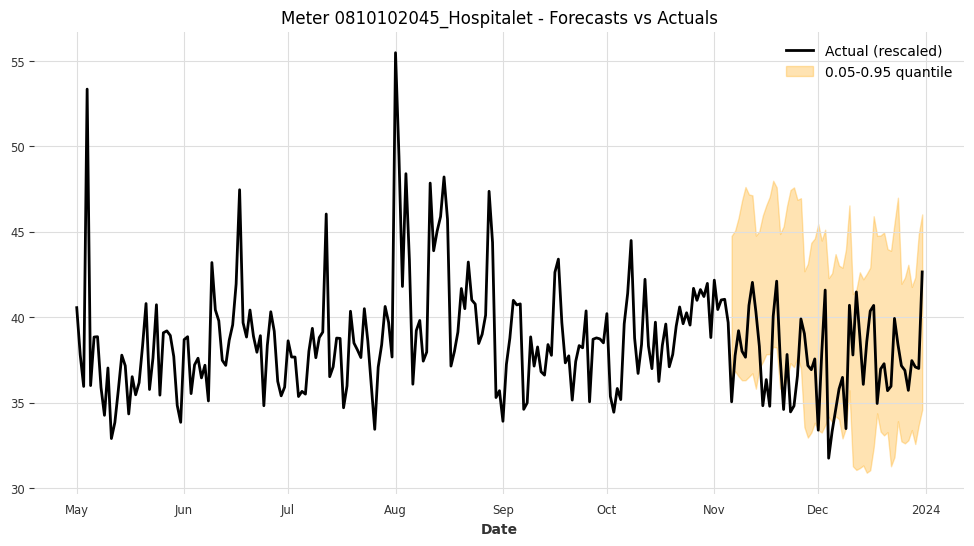

Meter 0810102045_Hospitalet - Coverage: 0.8036, Width: 10.2836



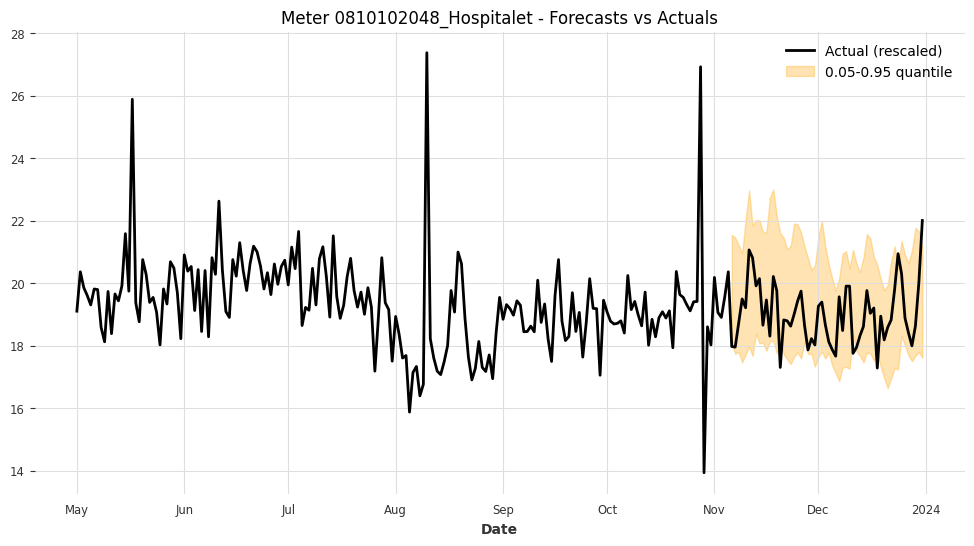

Meter 0810102048_Hospitalet - Coverage: 0.8929, Width: 3.5314



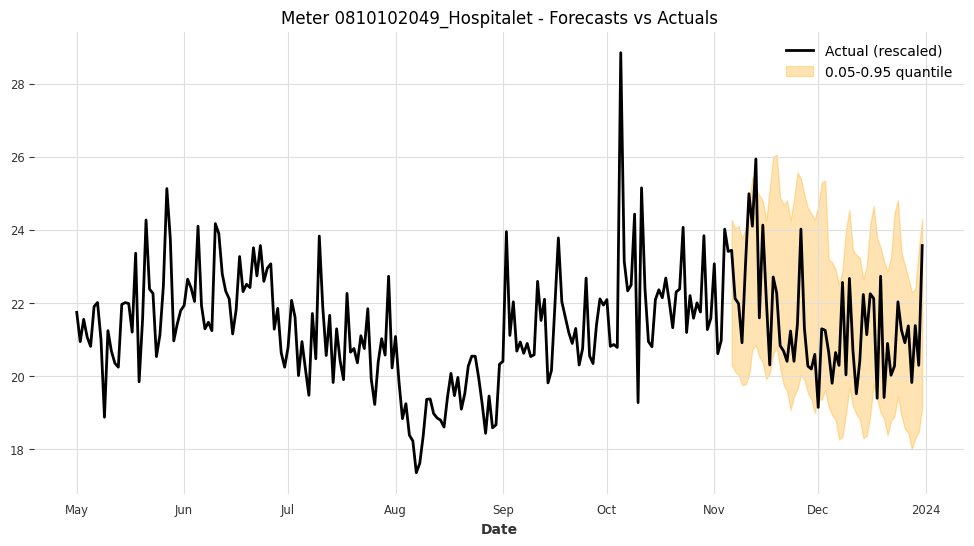

Meter 0810102049_Hospitalet - Coverage: 0.9464, Width: 4.7352



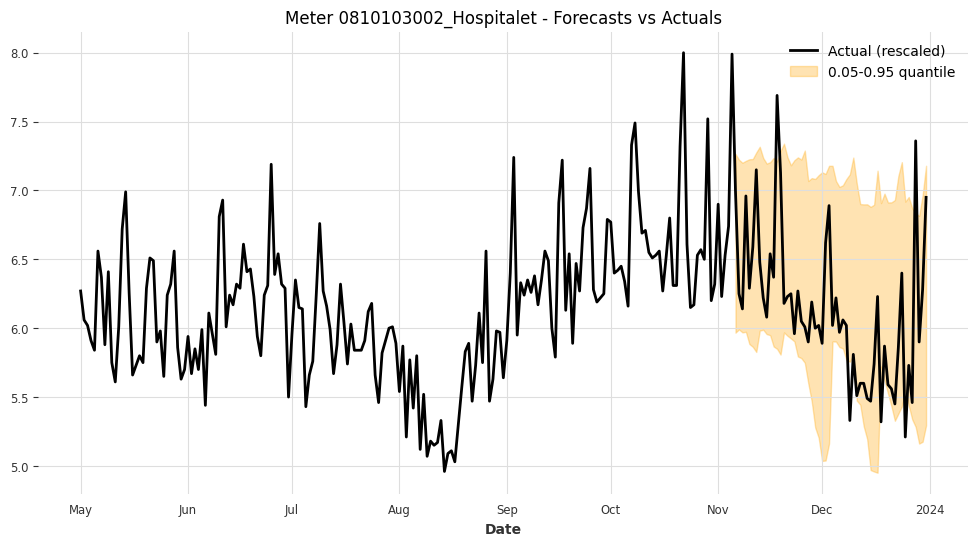

Meter 0810103002_Hospitalet - Coverage: 0.9107, Width: 1.5033



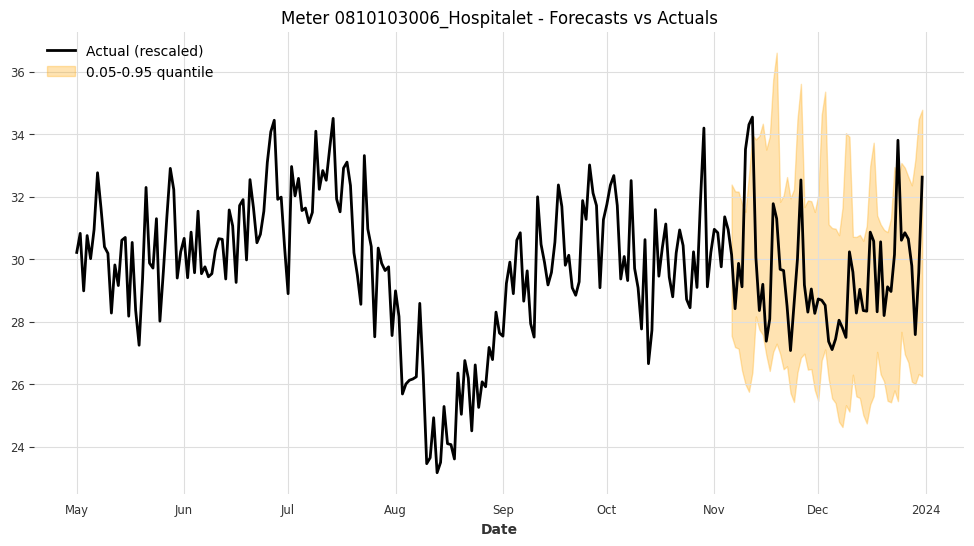

Meter 0810103006_Hospitalet - Coverage: 0.9286, Width: 6.3749



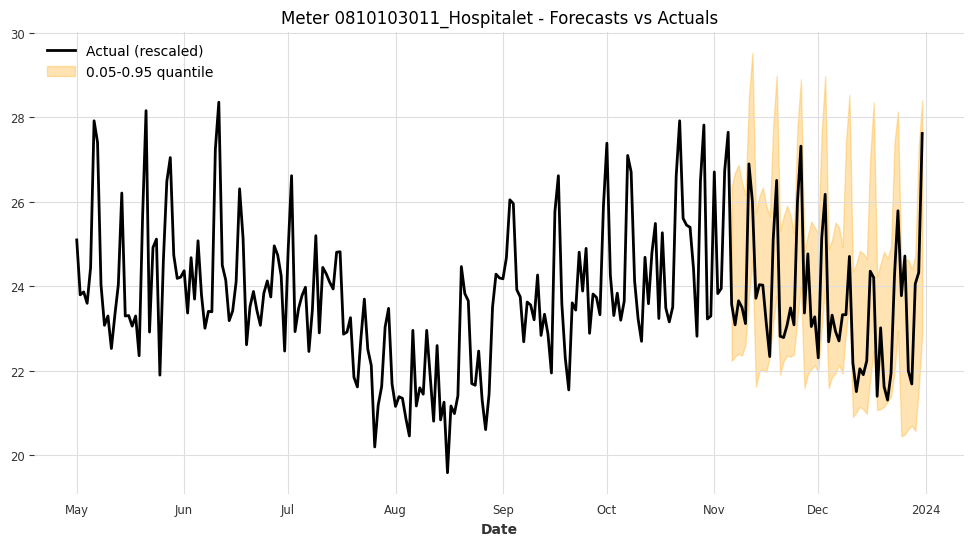

Meter 0810103011_Hospitalet - Coverage: 0.9821, Width: 4.0334



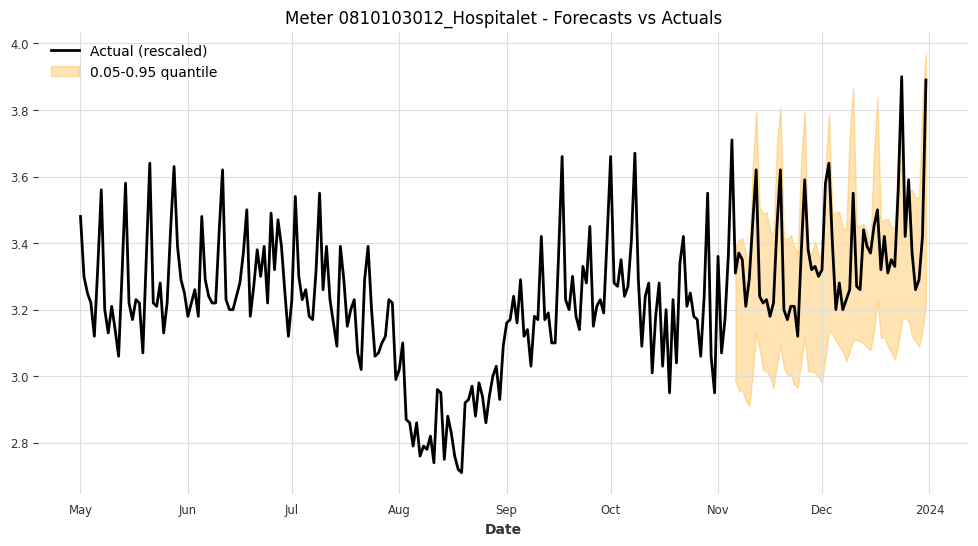

Meter 0810103012_Hospitalet - Coverage: 0.9464, Width: 0.4700



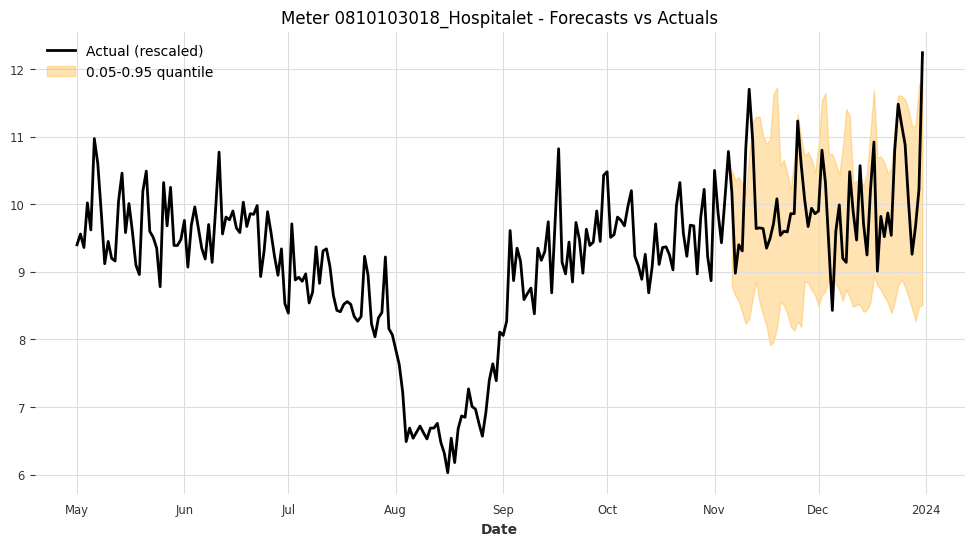

Meter 0810103018_Hospitalet - Coverage: 0.9107, Width: 2.3646



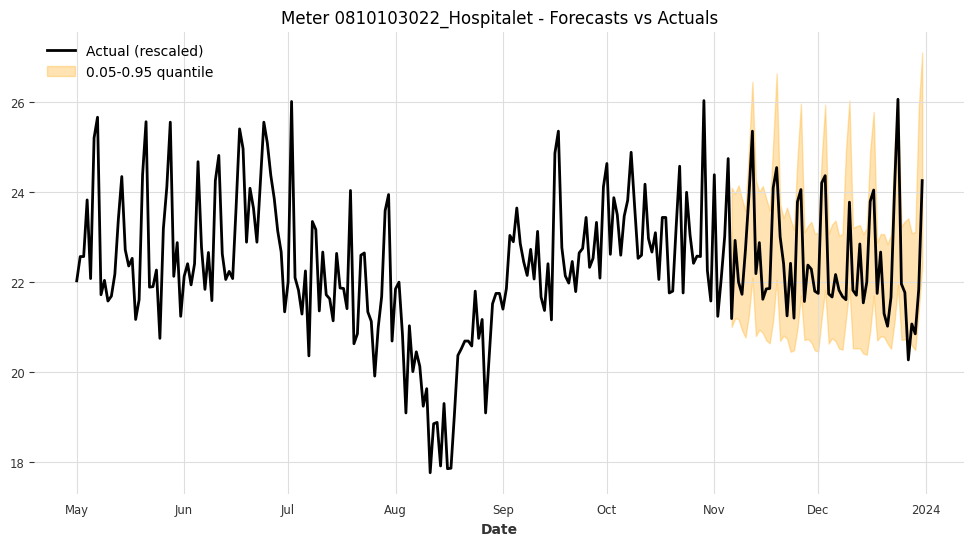

Meter 0810103022_Hospitalet - Coverage: 0.9821, Width: 3.1070



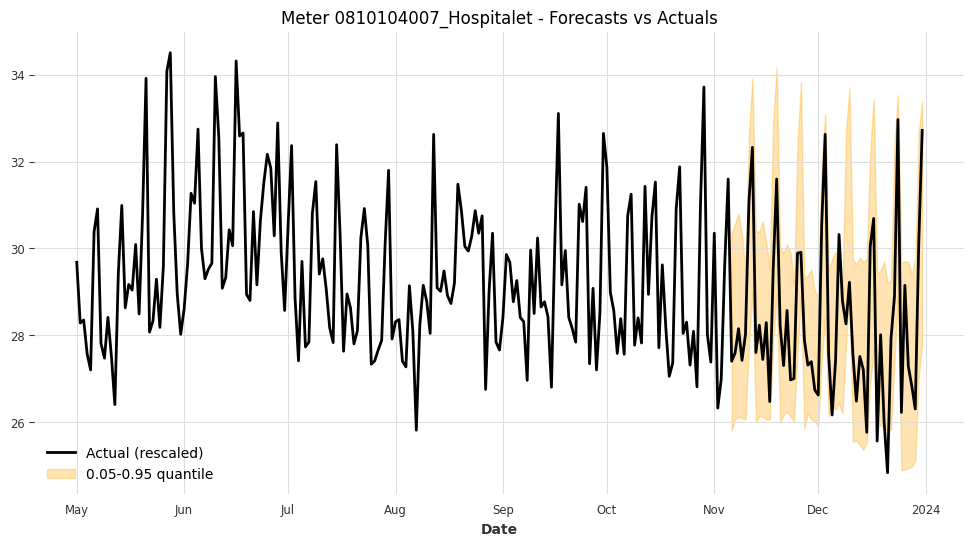

Meter 0810104007_Hospitalet - Coverage: 0.9286, Width: 4.2102



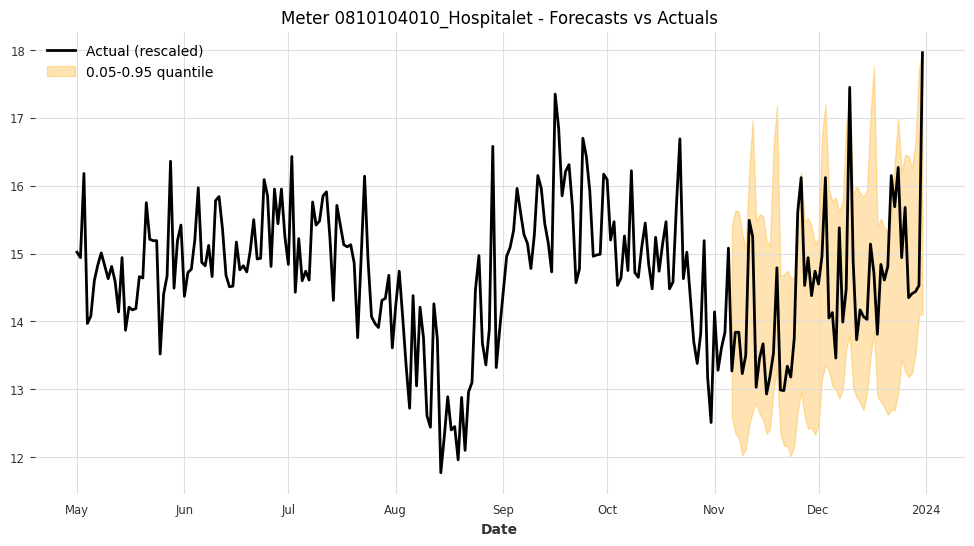

Meter 0810104010_Hospitalet - Coverage: 0.9464, Width: 3.0933



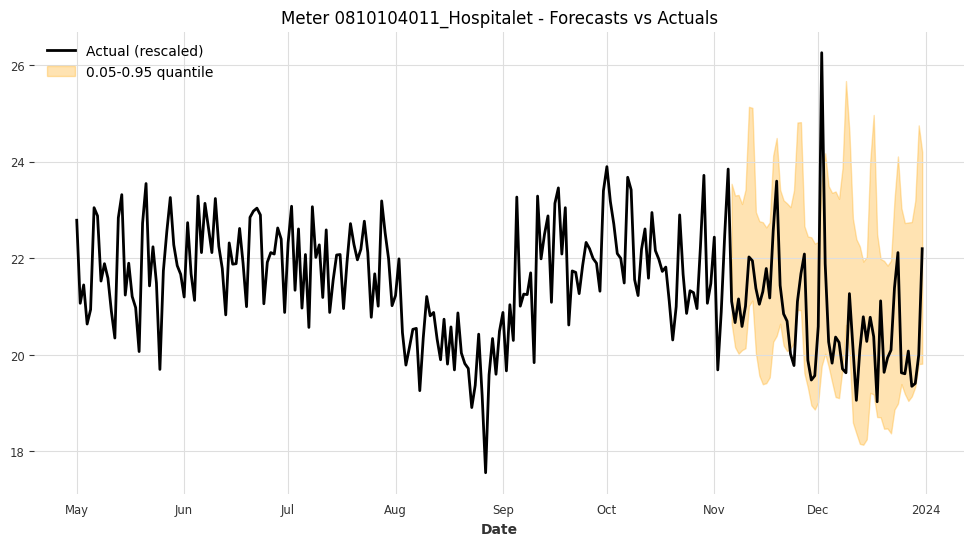

Meter 0810104011_Hospitalet - Coverage: 0.9107, Width: 3.7440



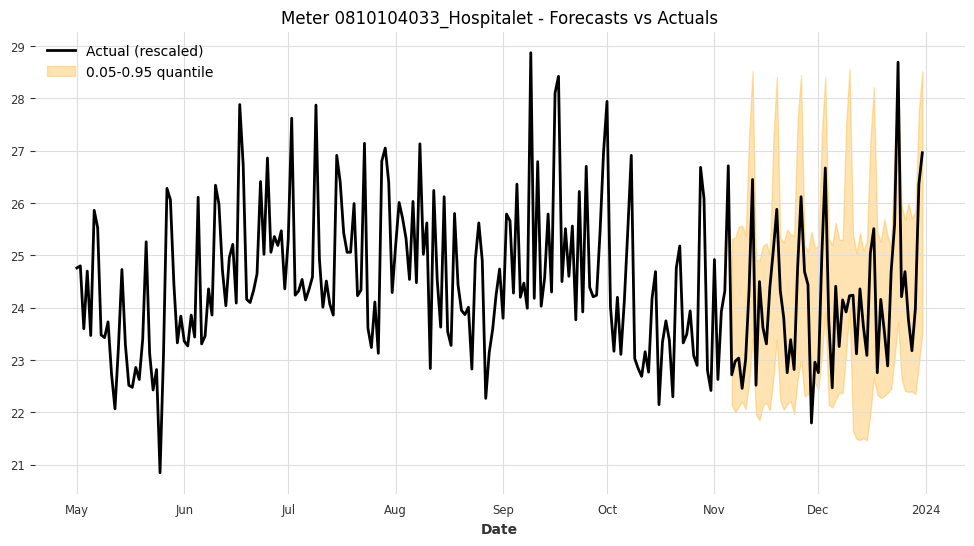

Meter 0810104033_Hospitalet - Coverage: 0.9643, Width: 3.6554



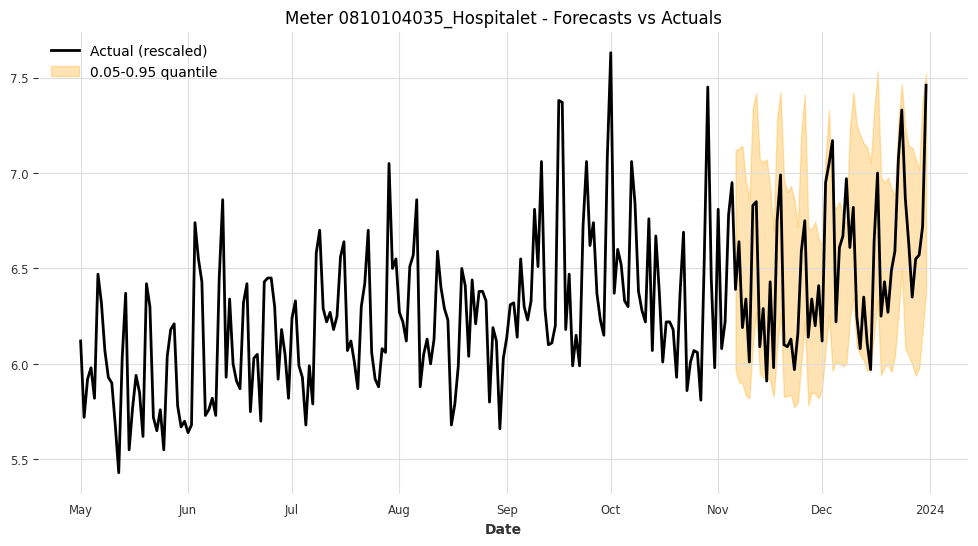

Meter 0810104035_Hospitalet - Coverage: 0.9286, Width: 1.0482



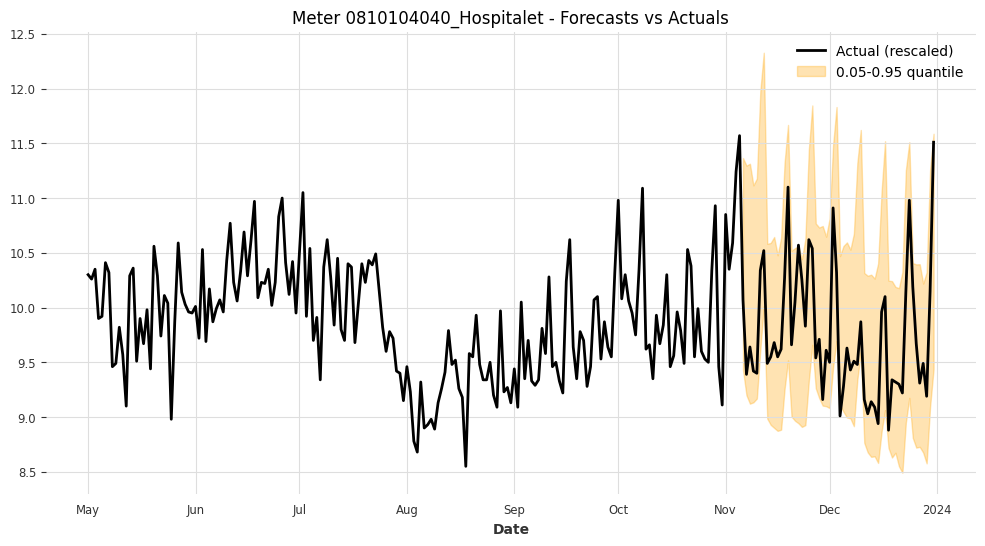

Meter 0810104040_Hospitalet - Coverage: 0.9643, Width: 1.8184



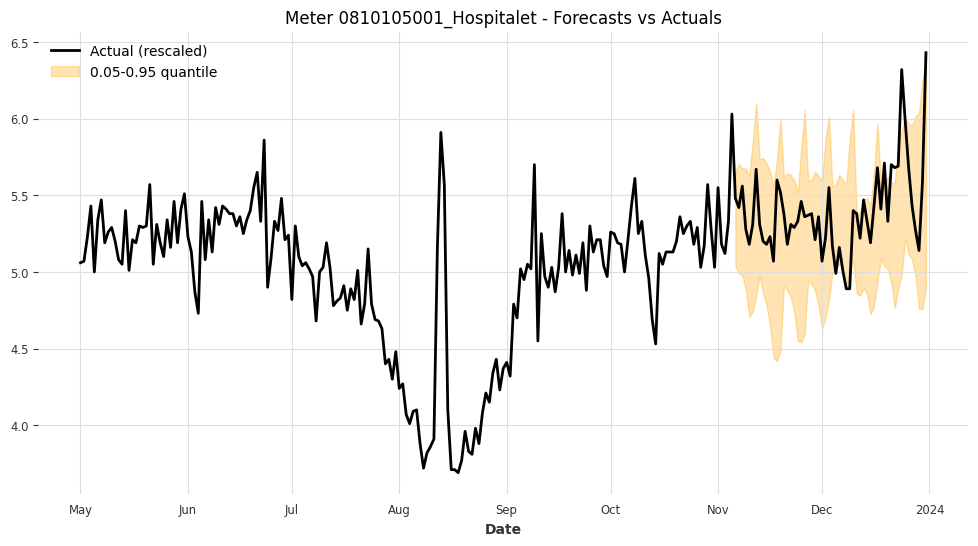

Meter 0810105001_Hospitalet - Coverage: 0.8393, Width: 0.8786



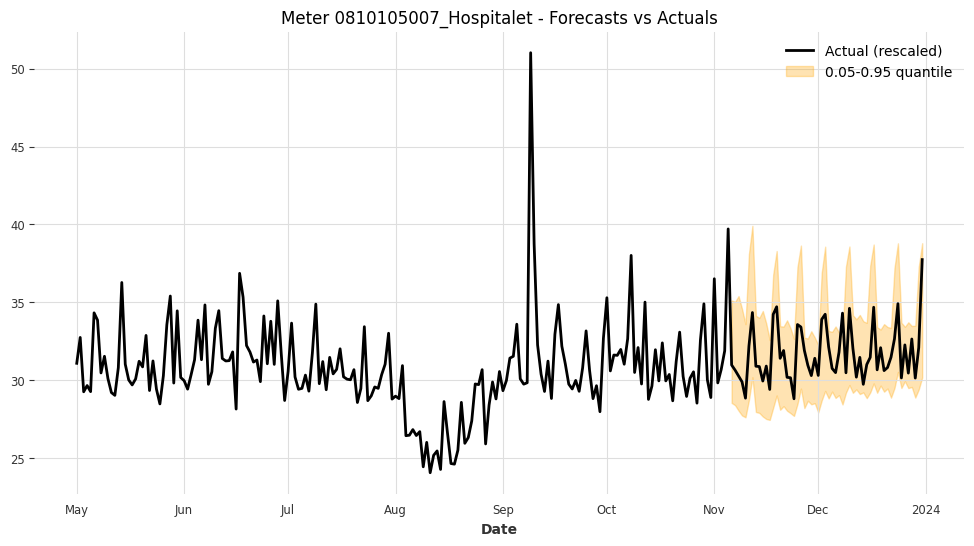

Meter 0810105007_Hospitalet - Coverage: 0.9821, Width: 6.0223



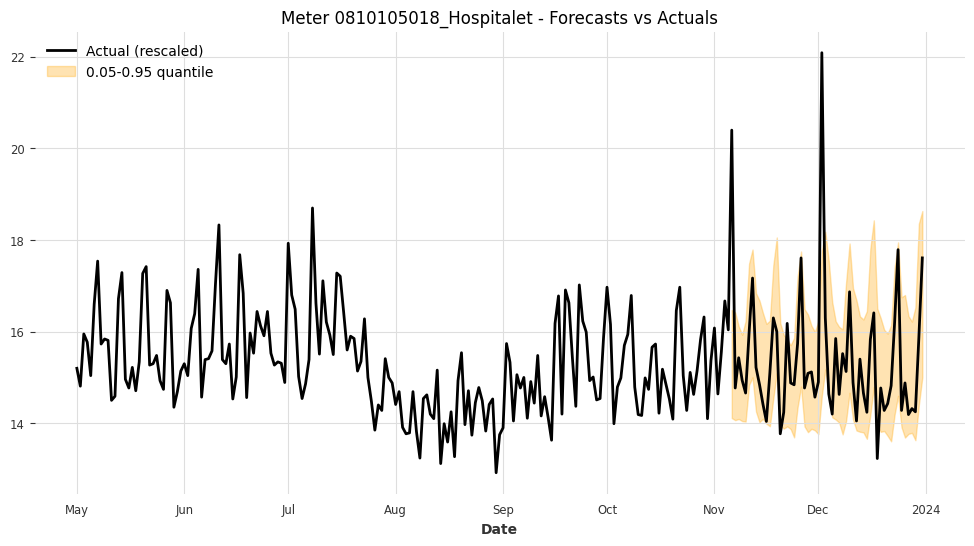

Meter 0810105018_Hospitalet - Coverage: 0.9107, Width: 2.6301



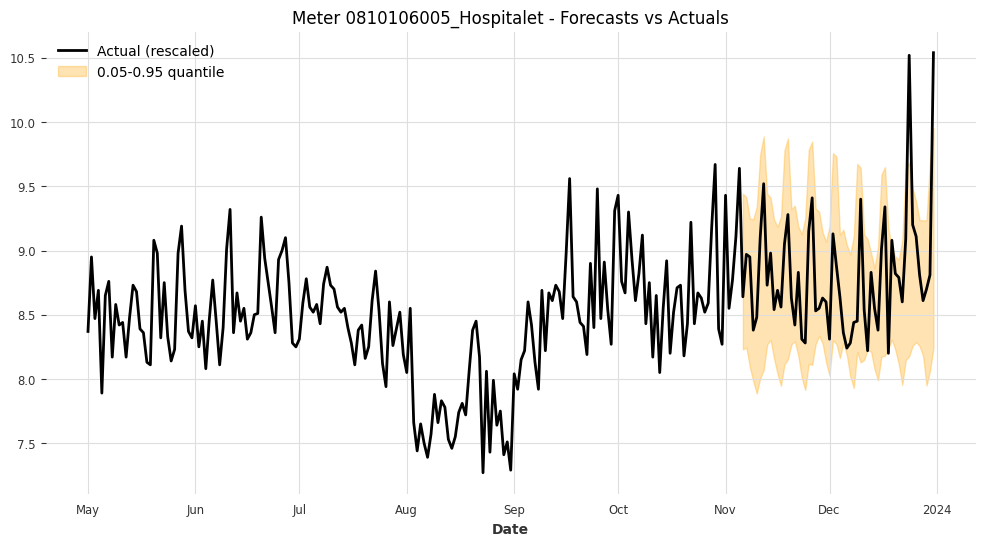

Meter 0810106005_Hospitalet - Coverage: 0.9107, Width: 1.2023



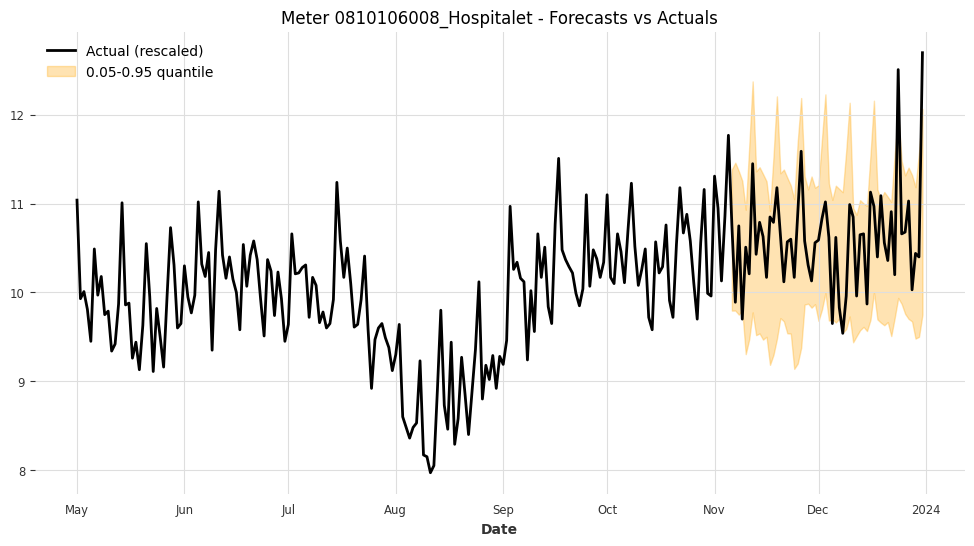

Meter 0810106008_Hospitalet - Coverage: 0.8929, Width: 1.7636



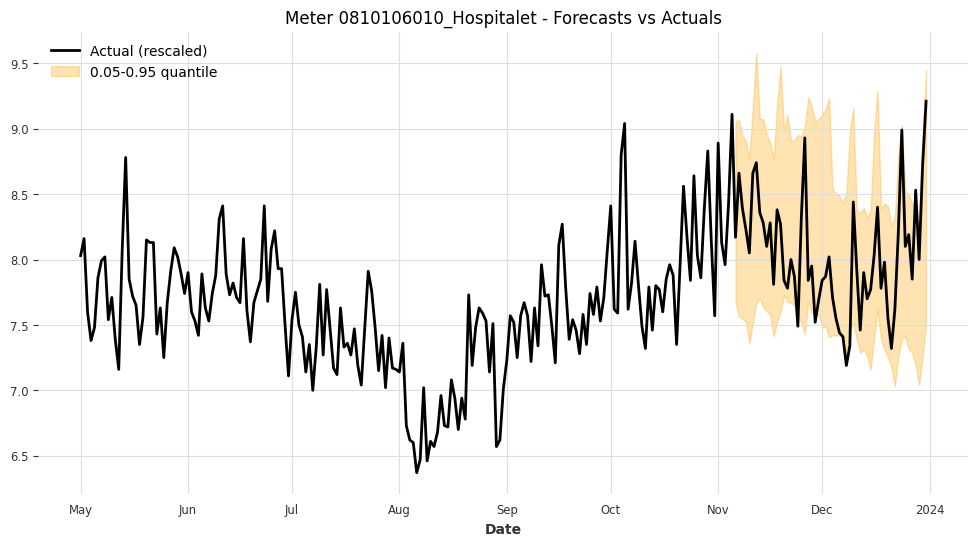

Meter 0810106010_Hospitalet - Coverage: 0.8929, Width: 1.3837



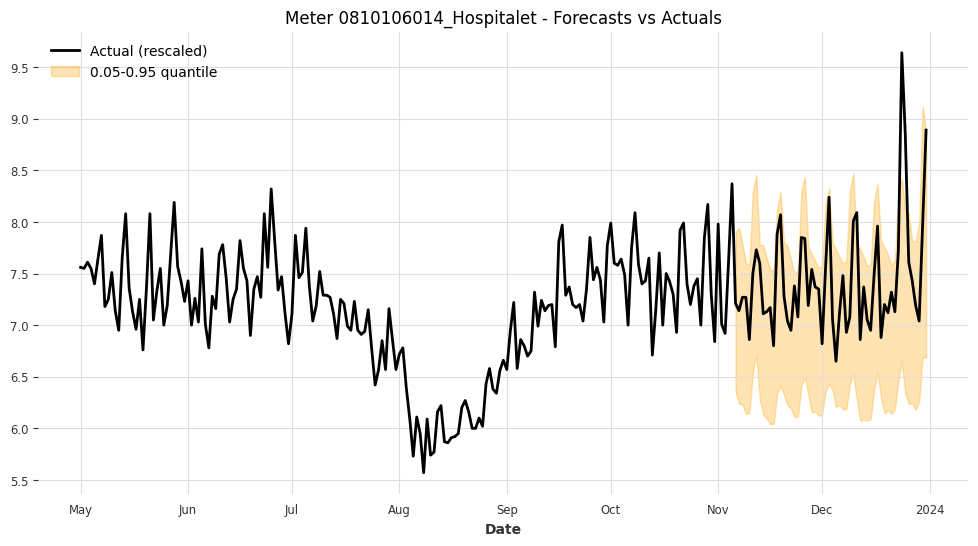

Meter 0810106014_Hospitalet - Coverage: 0.9286, Width: 1.6327



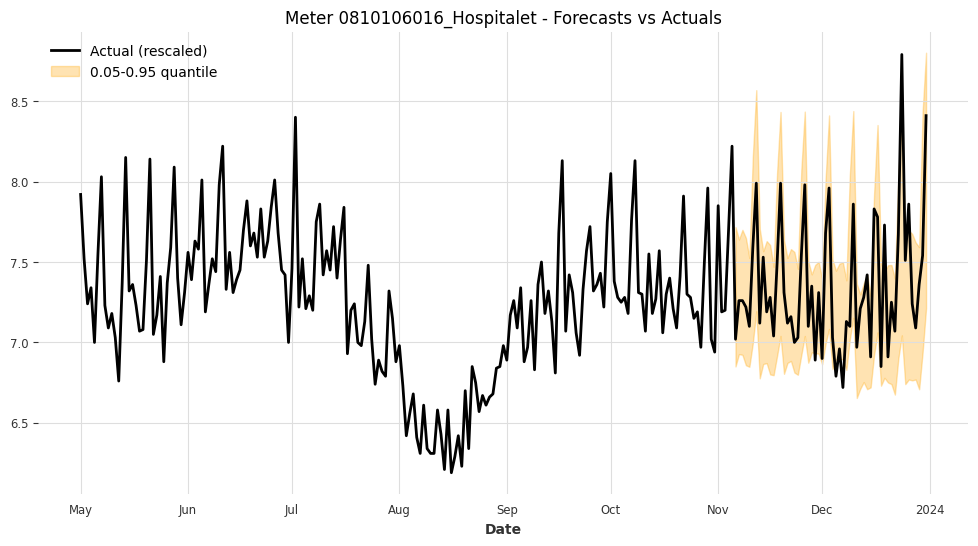

Meter 0810106016_Hospitalet - Coverage: 0.8929, Width: 0.8655



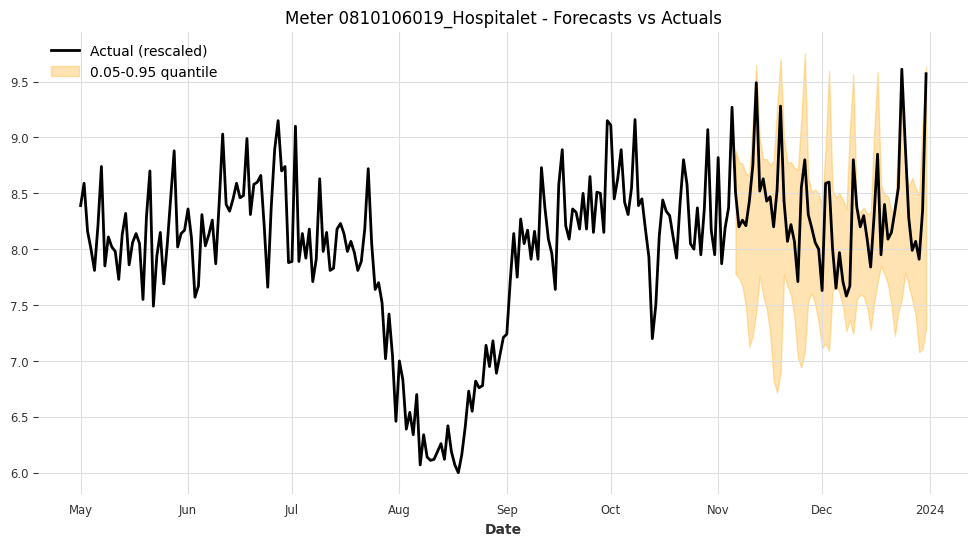

Meter 0810106019_Hospitalet - Coverage: 0.9107, Width: 1.3843



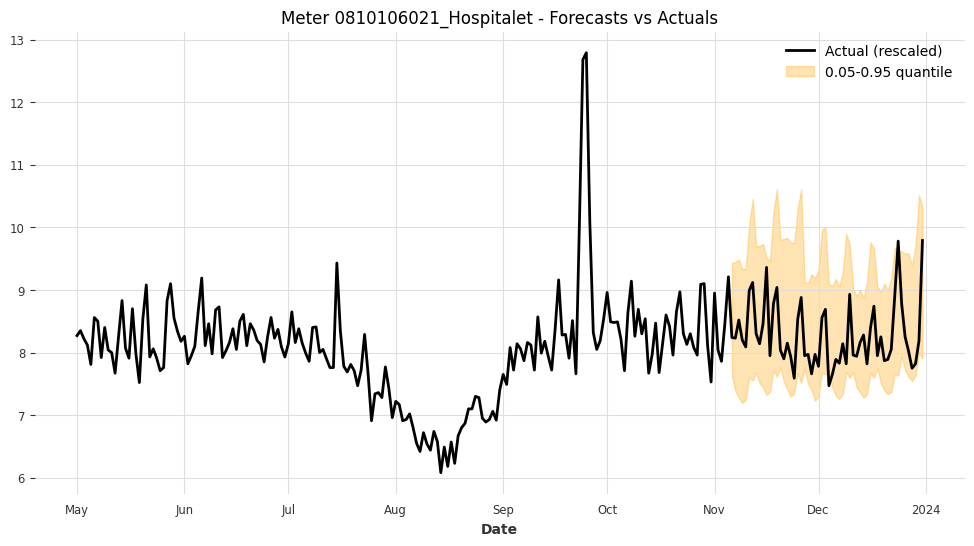

Meter 0810106021_Hospitalet - Coverage: 0.9643, Width: 2.0366



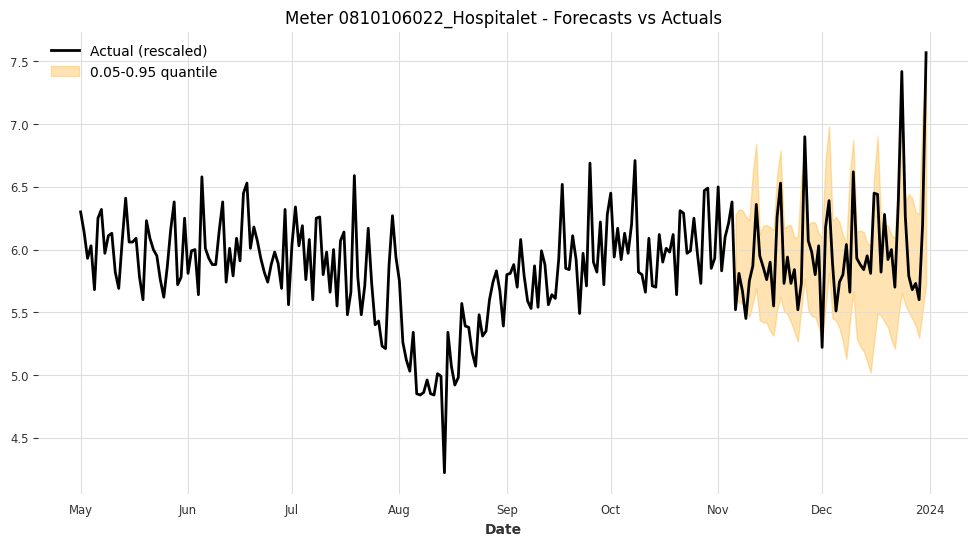

Meter 0810106022_Hospitalet - Coverage: 0.8750, Width: 0.9365



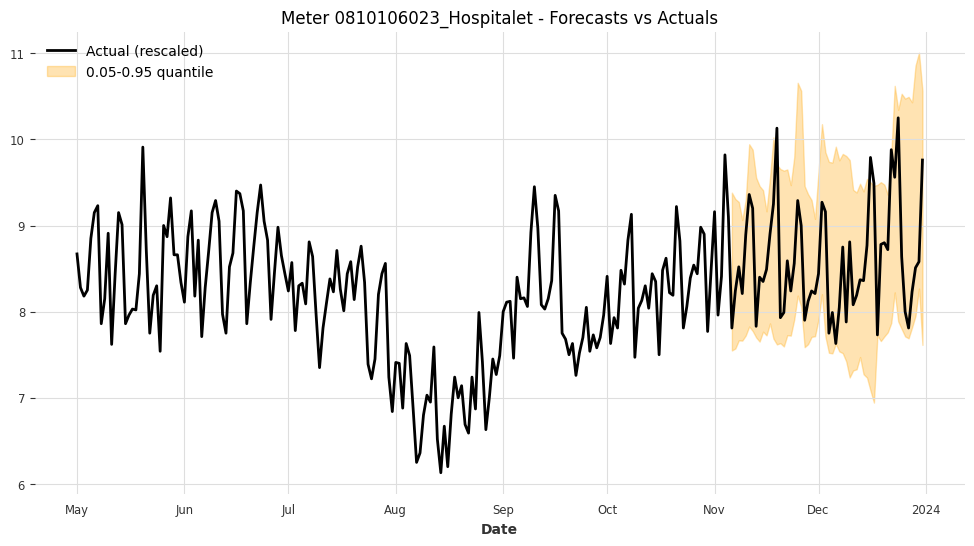

Meter 0810106023_Hospitalet - Coverage: 0.9286, Width: 2.0918



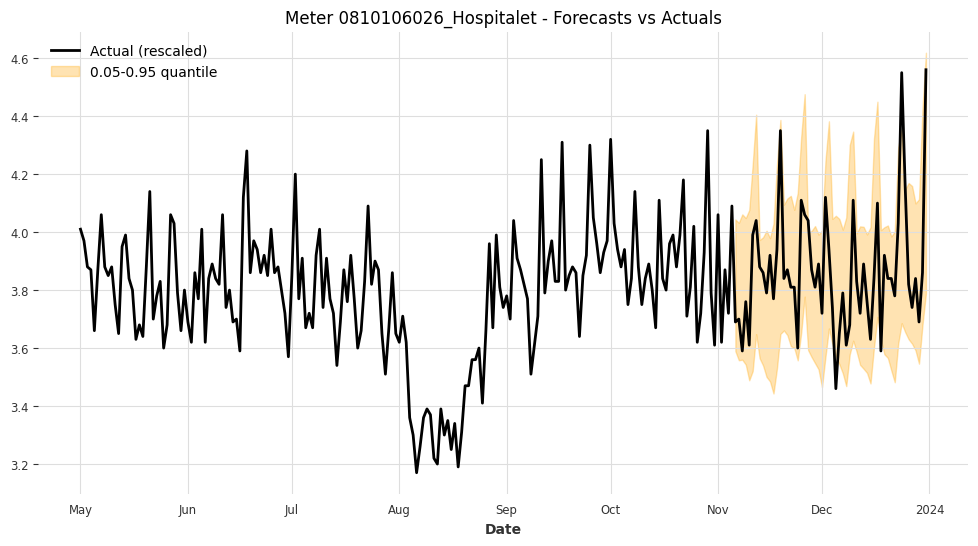

Meter 0810106026_Hospitalet - Coverage: 0.9107, Width: 0.5543



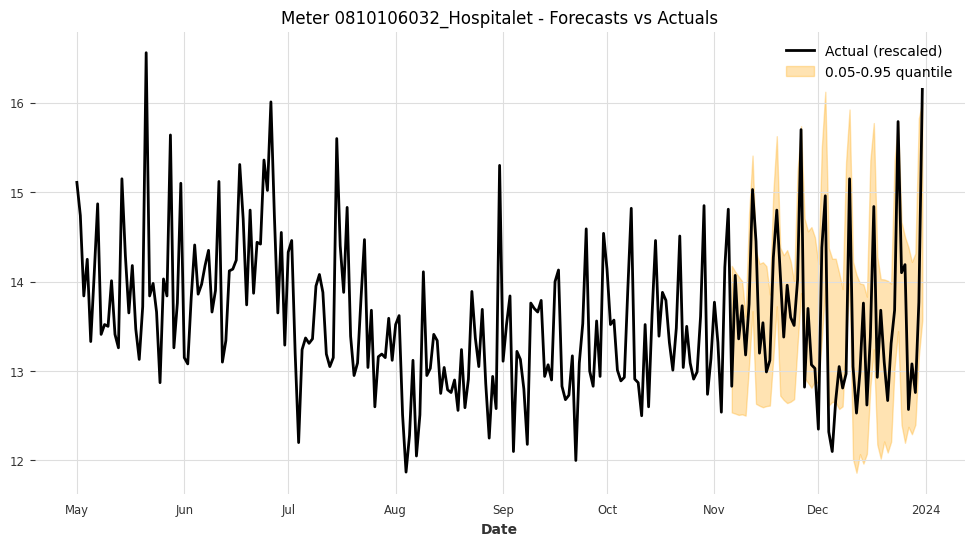

Meter 0810106032_Hospitalet - Coverage: 0.8750, Width: 1.8422



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # Darts utility to merge TimeSeries

for meter_id, hfcs in all_hfcs.items():
    # Get the actual time series
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width = df_result["Width rescaled"].iloc[0]

    # Start a new plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    full_lower = []
    full_upper = []

    # Collect lower and upper quantiles from each forecast window
    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components
            and 'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)


    if full_lower and full_upper:
        # Concatenate all the TimeSeries pieces into full series
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        # Plot the quantile area as a filled region
        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05-0.95 quantile'
        )

    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals")
    ax.legend()
    plt.show()

    # Print the metrics below each plot
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Width: {width:.4f}\n")
